# Mapping mouse coronal snRNA-seq cell type to visium

In [1]:
import sys, ast, os
import time
import pickle
import scanpy as sc
import anndata
import pandas as pd
import numpy as np
import os
from plotnine import *
import matplotlib.pyplot as plt 
import matplotlib
data_type = 'float32'
os.environ["THEANO_FLAGS"] = 'device=cuda0,floatX=' + data_type + ',force_device=True'
# /nfs/team283/vk7/software/miniconda3farm5/envs/cellpymc/bin/pip install git+https://github.com/vitkl/cell2location.git
sys.path.insert(1, '/nfs/team205/vk7/sanger_projects/BayraktarLab/cell2location/')
sys.path.insert(1, '/nfs/team205/vk7/sanger_projects/cell2location_dev/')

import cell2location
#import pycell2location.models as c2l

from matplotlib import rcParams
rcParams['pdf.fonttype'] = 42 # enables correct plotting of text
from matplotlib import rcParams
import seaborn as sns

# scanpy prints a lot of warnings
import warnings
warnings.filterwarnings('ignore')

WARNING (theano.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
/nfs/users/nfs_v/vk7/.local/lib/python3.7/site-packages/theano/gpuarray/dnn.py:184: UserWarning: Your cuDNN version is more recent than Theano. If you encounter problems, try updating Theano or downgrading cuDNN to a version >= v5 and <= v7.
Using cuDNN version 7605 on context None
Mapped name None to device cuda0: Tesla V100-SXM2-32GB (0000:62:00.0)


In [2]:
from pycell2location.models.CoLocationModelNB4E3V2 import CoLocationModelNB4E3V2

`THEANO_FLAGS='force_device=True'` forces the package to use GPU. Pay attention to error messages that might indicate theano failed to initalise the GPU.   
Do not forget to change `device=cuda4` to your available GPU id. Use `device=cuda` / `device=cuda0` if you have just one locally or if you are requesting one GPU via HPC cluster job.

### Outline

1. Loading Visium data and single cell reference
2. Show UMAP of cells and locations
3. cell2location analysis in one step
4. Automatic discrete region identification by clustering cell densities
5. Visualize cell type density gradients using diffusion maps

## 1. Loading Visium data and single cell reference

First let's read spatial Visium data from 10X Space Ranger output. Here we load sample annotations.

In [3]:
sp_data_folder = '/nfs/team205/vk7/sanger_projects/cell2location_proj/notebooks/data/viseum_cortex_trial/'
sc_data_folder = '/nfs/team205/vk7/sanger_projects/cell2location_proj/notebooks/data/mouse_viseum_snrna/'
results_folder = '/nfs/team205/vk7/sanger_projects/cell2location_proj/notebooks/results/mouse_viseum_snrna/'

sample_data = pd.read_csv(sp_data_folder + 'Visum_mouse.csv')

In [4]:
sample_data

,sample_name,sample_name2,image_name,slide,position
0,ST8059048,Visium-28C,mouse_brain_he_Library_028_C05717_020_C1_14460...,C05717-020,C1
1,ST8059049,Visium-28D,mouse_brain_he_Library_028_C05717_020_D1_14460...,C05717-020,D1
2,ST8059050,Visium-28E,mouse_brain_he_Library_028_C05717_020_E1_14460...,C05717-020,E1
3,ST8059051,Visium-29B,mouse_brain_he_Library_029_C05717_021_B1_14460...,C05717-021,B1
4,ST8059052,Visium-29C,mouse_brain_he_Library_029_C05717_021_C1_14460...,C05717-021,C1


In [5]:
sc.logging.print_versions()

-----
anndata     0.7.4
scanpy      1.6.0
sinfo       0.3.1
-----
anndata             0.7.4
arviz               0.8.3
backcall            0.2.0
cairo               1.19.1
cell2location       NA
cffi                1.14.0
cftime              1.1.3
cutils_ext          NA
cycler              0.10.0
cython_runtime      NA
dateutil            2.8.1
decorator           4.4.2
descartes           NA
fastprogress        0.2.3
get_version         2.1
h5py                2.10.0
igraph              0.8.2
importlib_metadata  1.7.0
ipykernel           5.3.0
ipython_genutils    0.2.0
ipywidgets          7.5.1
jedi                0.17.1
joblib              0.16.0
kiwisolver          1.2.0
lazylinker_ext      NA
legacy_api_wrap     0.0.0
leidenalg           0.8.0
llvmlite            0.32.1
louvain             0.6.1
mako                1.1.0
markupsafe          1.1.1
matplotlib          3.2.2
mizani              0.7.1
mkl                 2.3.0
mpl_toolkits        NA
natsort             7.0.1
netCDF4    

Next we load the mRNA count for each Visium slide and corresponding histology images as a list `slides` and as a single anndata object `adata`. We need this redundancy because scanpy plotting over the histology image does not work with multiple sections.   

In [6]:
def read_and_qc(sample_name, path=sp_data_folder + 'rawdata/'):
    
    adata = sc.read_visium(path + str(sample_name),
                           count_file='filtered_feature_bc_matrix.h5', load_images=True)
    adata.obs['sample'] = sample_name
    adata.var['SYMBOL'] = adata.var_names
    adata.var.rename(columns={'gene_ids': 'ENSEMBL'}, inplace=True)
    adata.var_names = adata.var['ENSEMBL']
    adata.var.drop(columns='ENSEMBL', inplace=True)

    # Calculate QC metrics
    sc.pp.calculate_qc_metrics(adata, inplace=True)
    adata.var['mt'] = [gene.startswith('mt-') for gene in adata.var['SYMBOL']]
    adata.obs['mt_frac'] = adata[:, adata.var['mt'].tolist()].X.sum(1).A.squeeze()/adata.obs['total_counts']
    
    # for spatial mapping remove MT genes
    adata.obsm['mt'] = adata[:, adata.var['mt'].values].X.toarray()
    adata = adata[:, ~adata.var['mt'].values]
    
    # add sample name to obs names
    adata.obs["sample"] = [str(i) for i in adata.obs['sample']]
    adata.obs_names = adata.obs["sample"] \
                          + '_' + adata.obs_names
    adata.obs.index.name = 'spot_id'
    
    return adata

# read first sample
adata = read_and_qc(sample_data['sample_name'][0],
                    path=sp_data_folder + 'rawdata/') 

# read the remaining samples
slides = {}
for i in sample_data['sample_name'][1:]:
    adata_1 = read_and_qc(i, path=sp_data_folder + 'rawdata/') 
    slides[str(i)] = adata_1

adata_0 = adata.copy()
    
# combine individual samples
#adata = adata.concatenate(list(slides.values()), index_unique=None)
adata = adata.concatenate(
    list(slides.values()),
    batch_key="sample",
    uns_merge="unique",
    batch_categories=list(sample_data['sample_name'].values), 
    index_unique=None
)

obs = adata.obs.merge(sample_data, left_on='sample', right_on='sample_name')
obs.index = adata.obs_names
adata.obs = obs

slides[str(sample_data['sample_name'][0])] = adata_0

Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Trying to set attribute `.obs` of view, copying.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Trying to set attribute `.obs` of view, copying.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Trying to set attribute `.obs` of view, copying.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Trying to set attribute `.obs` of view, copying.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call 

Now let's look at QC: total number of counts and total number of genes per spot

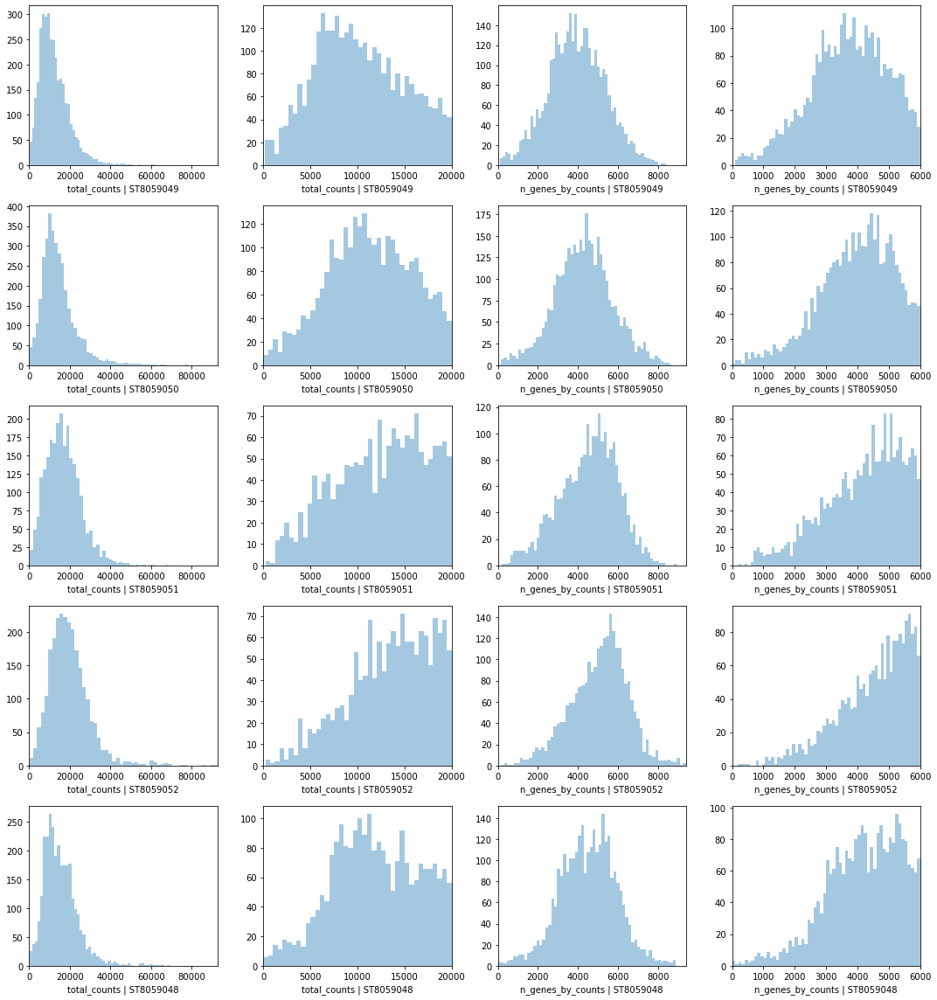

In [7]:
# PLOT QC FOR EACH SAMPLE 
fig, axs = plt.subplots(len(slides), 4, figsize=(15, 4*len(slides)-4))
for i in range(len(slides)):
    #fig.suptitle('Covariates for filtering')
    
    sns.distplot(list(slides.values())[i].obs['total_counts'], 
                 kde=False, ax = axs[i, 0])
    axs[i, 0].set_xlim(0, adata.obs['total_counts'].max())
    axs[i, 0].set_xlabel('total_counts | ' + list(slides.keys())[i])
    
    sns.distplot(list(slides.values())[i].obs['total_counts']\
                 [list(slides.values())[i].obs['total_counts']<20000],
                 kde=False, bins=40, ax = axs[i, 1])
    axs[i, 1].set_xlim(0, 20000)
    axs[i, 1].set_xlabel('total_counts | ' + list(slides.keys())[i])
    
    sns.distplot(list(slides.values())[i].obs['n_genes_by_counts'],
                 kde=False, bins=60, ax = axs[i, 2])
    axs[i, 2].set_xlim(0, adata.obs['n_genes_by_counts'].max())
    axs[i, 2].set_xlabel('n_genes_by_counts | ' + list(slides.keys())[i])
    
    sns.distplot(list(slides.values())[i].obs['n_genes_by_counts']\
                 [list(slides.values())[i].obs['n_genes_by_counts']<6000],
                 kde=False, bins=60, ax = axs[i, 3])
    axs[i, 3].set_xlim(0, 6000)
    axs[i, 3].set_xlabel('n_genes_by_counts | ' + list(slides.keys())[i])
    
plt.tight_layout()

... storing 'sample' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical
... storing 'SYMBOL' as categorical


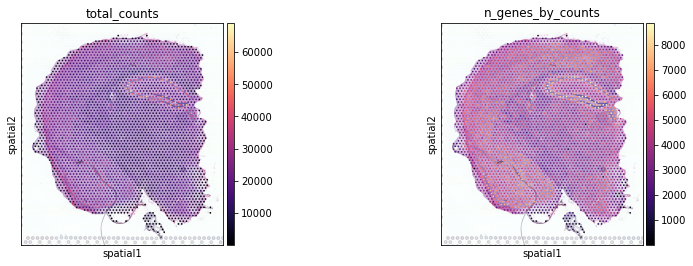

In [8]:
sc.pl.spatial(slides['ST8059048'], img_key = "hires", cmap='magma',
              color=['total_counts', 'n_genes_by_counts'],
              gene_symbols='SYMBOL', size=0.8)

Here we show how to use scanpy to plot results over histology section using anndata object from one section, and 

Trying to set attribute `.obs` of view, copying.
... storing 'sample' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'sample_name' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'sample_name2' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'image_name' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'slide' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'position' as categorical
Trying to set attribute `.var` of view, copying.
... storing 'feature_types' as categorical
Trying to set attribute `.var` of view, copying.
... storing 'genome' as categorical
Trying to set attribute `.var` of view, copying.
... storing 'SYMBOL' as categorical


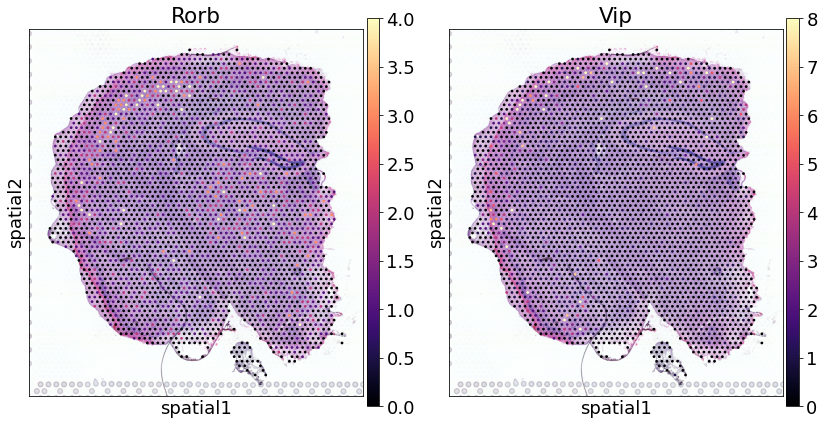

In [9]:
rcParams["axes.facecolor"] = "black"
rcParams["figure.figsize"] = [6,7]
rcParams["font.size"] = 18

sc.pl.spatial(adata[adata.obs["sample"]==adata.obs["sample"].unique()[0], :], 
              color=["Rorb", "Vip"], img_key='hires',
              vmin=0, cmap='magma', vmax='p99.0',
              gene_symbols='SYMBOL', size=0.8
             )

### Read snRNA-seq reference

```python
## snRNA reference (raw counts)
def read_10x_output(file_path, smp_list, metadata=None, type = 'h5', umi_filter=5):
    
    #Writing output from separate samples, processed using CellRanger, into a dictionary of Scanpy objects:
    ad = {}

    #Generate AnnData for each sample
    for sample_name in smp_list:
        path = file_path + sample_name
        for i in os.listdir(path):
            if type in i:
                file = i
        ad[sample_name] = sc.read_10x_h5(file_path + sample_name +'/'+file)
        ad[sample_name].var.rename(columns = {'gene_ids':'ENSEMBL'}, inplace = True)
        ad[sample_name].var['SYMBOL'] = ad[sample_name].var.index
        ad[sample_name].var.index = ad[sample_name].var['ENSEMBL']
        ad[sample_name].var.drop(columns=['ENSEMBL'], inplace=True)
        #ad[sample_name].var_names_make_unique() 
        
        
        sc.pp.calculate_qc_metrics(ad[sample_name], inplace=True)
        ad[sample_name] = ad[sample_name][ad[sample_name].obs['total_counts'] > umi_filter, :]
        ad[sample_name].var['mt'] = [gene.startswith('mt-') 
                                     for gene in ad[sample_name].var['SYMBOL']]
        ad[sample_name].obs['mt_frac'] = (ad[sample_name][:, 
               ad[sample_name].var['mt'].tolist()].X.sum(1).A.squeeze() 
                                          / ad[sample_name].obs['total_counts'])
        
        ad[sample_name].obs['sample'] = sample_name
        ad[sample_name].obs['barcode'] = ad[sample_name].obs_names
        ad[sample_name].obs_names = ad[sample_name].obs['sample']+"_"+ad[sample_name].obs['barcode']

    #Merge AnnData objects from all the samples together    
    from scipy.sparse import vstack
    stack = vstack([ad[x].X for x in smp_list]) # stack data
    adata = sc.AnnData(stack, var = ad[smp_list[0]].var)
    adata.obs = pd.concat([ad[x].obs for x in smp_list], axis = 0)

    if metadata is not None:
        #Add cleaned metadata to the Anndata.obs table
        obs_merged = pd.merge(left = adata.obs, right = metadata, 
                              how = "left", left_on="sample", right_on="SampleID")
        obs_merged.index = obs_merged['sample']+"_"+obs_merged['barcode']
        print(obs_merged.index.equals(adata.obs.index))
        adata.obs = obs_merged

    return adata, ad

adata_snrna_raw, ad_list = read_10x_output(
    sc_data_folder + 'rawdata/', 
    smp_list=os.listdir(sc_data_folder + 'rawdata/filtered_feature_bc_matrix'),
    metadata=None, type = 'h5')
```

```python
# PLOT QC FOR EACH SAMPLE 
rcParams["axes.facecolor"] = "white"
rcParams["figure.figsize"] = [10, 15]
rcParams["font.size"] = 12

fig, axs = plt.subplots(len(ad_list), 4, figsize=(15, 4*len(ad_list)-4))
for i in range(len(ad_list)):
    #fig.suptitle('Covariates for filtering')
    
    sns.distplot(np.log10(list(ad_list.values())[i].obs['total_counts']), 
                 kde=False, ax = axs[i, 0], hist_kws={'log': True})
    axs[i, 0].set_xlim(0, np.log10(adata_snrna_raw.obs['total_counts'].max()))
    axs[i, 0].set_xlabel('total_counts | ' + list(ad_list.keys())[i])
    
    sns.distplot(np.log10(list(ad_list.values())[i].obs['total_counts']\
                 [list(ad_list.values())[i].obs['total_counts']<20000]),
                 kde=False, bins=40, ax = axs[i, 1], hist_kws={'log': True})
    axs[i, 1].set_xlim(0, np.log10(20000))
    axs[i, 1].set_xlabel('total_counts | ' + list(ad_list.keys())[i])
    
    sns.distplot(np.log10(list(ad_list.values())[i].obs['n_genes_by_counts']),
                 kde=False, bins=60, ax = axs[i, 2], hist_kws={'log': True})
    axs[i, 2].set_xlim(0, np.log10(adata_snrna_raw.obs['n_genes_by_counts'].max()))
    axs[i, 2].set_xlabel('n_genes_by_counts | ' + list(ad_list.keys())[i])
    
    sns.distplot(np.log10(list(ad_list.values())[i].obs['n_genes_by_counts']\
                 [list(ad_list.values())[i].obs['n_genes_by_counts']<6000]),
                 kde=False, bins=60, ax = axs[i, 3], hist_kws={'log': True})
    axs[i, 3].set_xlim(0, np.log10(6000))
    axs[i, 3].set_xlabel('n_genes_by_counts | ' + list(ad_list.keys())[i])
    
plt.tight_layout()
```

In [10]:
results_folder + 'snRNA_annotation_astro_subtypes_20200731.csv', \
results_folder + "snRNA_annotation_subclusters_20200207.csv",\
sc_data_folder + 'rawdata/all_cells_with_empty_20200625.h5ad', \
sc_data_folder + 'rawdata/all_cells_20200625.h5ad'

('/nfs/team205/vk7/sanger_projects/cell2location_proj/notebooks/results/mouse_viseum_snrna/snRNA_annotation_astro_subtypes_20200731.csv',
 '/nfs/team205/vk7/sanger_projects/cell2location_proj/notebooks/results/mouse_viseum_snrna/snRNA_annotation_subclusters_20200207.csv',
 '/nfs/team205/vk7/sanger_projects/cell2location_proj/notebooks/data/mouse_viseum_snrna/rawdata/all_cells_with_empty_20200625.h5ad',
 '/nfs/team205/vk7/sanger_projects/cell2location_proj/notebooks/data/mouse_viseum_snrna/rawdata/all_cells_20200625.h5ad')

In [11]:
## snRNA reference (raw counts)
adata_snrna_raw = anndata.read_h5ad(sc_data_folder + "rawdata/all_cells_20200625.h5ad")

## Cell type annotations
labels = pd.read_csv(results_folder + 'snRNA_annotation_astro_subtypes_refined58_20200828.csv', index_col=0)
#labels = pd.read_csv(results_folder + 'snRNA_annotation_astro_subtypes_refined61_20200807.csv', index_col=0)

sub_labels = pd.read_csv(results_folder + "snRNA_annotation_subclusters_20200207.csv", index_col=0)

# remove 'NonNeu_' from astro names
from re import sub
sub_labels['annotation_subclusters'] = [sub('NonNeu_', '', i) for i in sub_labels['annotation_subclusters']]

In [12]:
#adata_snrna_raw = adata_snrna_raw[~adata_snrna_raw.obs['sample'].isin(['nan']),]

In [13]:
labels, adata_snrna_raw.shape

(                                      annotation_1
 5705STDY8058283_AAACCCAAGCCTATTG-1         Ext_L23
 5705STDY8058283_AAACCCAAGGTCATAA-1         Oligo_2
 5705STDY8058283_AAACCCACAACCCTCT-1         Oligo_2
 5705STDY8058283_AAACCCAGTGCTATTG-1  Astro_THAL_med
 5705STDY8058283_AAACCCAGTTCACCGG-1         Inh_Sst
 ...                                            ...
 5705STDY8058280_TTTGTTGCAGAGTGAC-1           Micro
 5705STDY8058280_TTTGTTGCATCGCTCT-1         Oligo_2
 5705STDY8058280_TTTGTTGGTATGGTAA-1     Inh_Meis2_3
 5705STDY8058280_TTTGTTGGTGTAGTGG-1         Oligo_2
 5705STDY8058280_TTTGTTGGTTAGGCCC-1          LowQ_2
 
 [40532 rows x 1 columns],
 (40572, 31053))

Add cell type labels as columns in `adata.obs`

In [14]:
labels = labels.reindex(index=adata_snrna_raw.obs_names)
adata_snrna_raw.obs[labels.columns] = labels
adata_snrna_raw = adata_snrna_raw[~adata_snrna_raw.obs['annotation_1'].isna(), :]

# remove likely doublet clusters
adata_snrna_raw = adata_snrna_raw[~adata_snrna_raw.obs['annotation_1'].isin(['Ext_Hpc_14', 'Ext_Hpc_15']),:]

Select genes expressed by at least 5% of cells in each cluster.

adata_snrna_raw = adata_snrna_raw[:, adata_snrna_raw.var['total_counts'] > 50]

Select genes using expression in non-zero cells

Trying to set attribute `.obs` of view, copying.


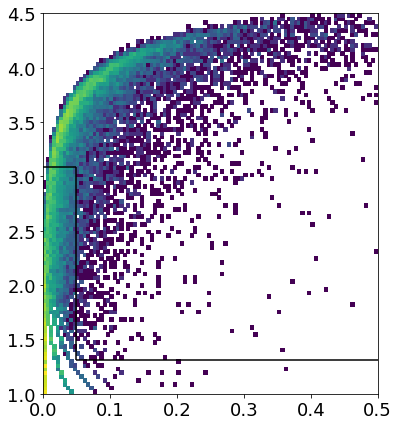

In [15]:
# Select cells
#min_genes = 1000  
rcParams["axes.facecolor"] = "white"

sc.pp.filter_cells(adata_snrna_raw, min_genes=1)
sc.pp.filter_genes(adata_snrna_raw, min_cells=1)

# calculate the mean of each gene across non-zero cells
adata_snrna_raw.var['n_cells'] = (adata_snrna_raw.X.toarray() > 0).sum(0)
adata_snrna_raw.var['nonz_mean'] = adata_snrna_raw.X.toarray().sum(0) / adata_snrna_raw.var['n_cells']

plt.hist2d(np.log10(adata_snrna_raw.var['nonz_mean']),
           np.log10(adata_snrna_raw.var['n_cells']), bins=100,
           norm=matplotlib.colors.LogNorm(),
           range=[[0,0.5], [1,4.5]]);
nonz_mean_cutoff = 0.05
cell_count_cutoff = np.log10(adata_snrna_raw.shape[0] * 0.0005)
cell_count_cutoff2 = np.log10(adata_snrna_raw.shape[0] * 0.03)
plt.vlines(nonz_mean_cutoff, cell_count_cutoff, cell_count_cutoff2);
plt.hlines(cell_count_cutoff, nonz_mean_cutoff, 1);
plt.hlines(cell_count_cutoff2, 0, nonz_mean_cutoff);

In [16]:
adata_snrna_raw[:,(np.array(np.log10(adata_snrna_raw.var['nonz_mean']) > nonz_mean_cutoff)
         | np.array(np.log10(adata_snrna_raw.var['n_cells']) > cell_count_cutoff2))
      & np.array(np.log10(adata_snrna_raw.var['n_cells']) > cell_count_cutoff)].shape

(40532, 12819)

In [17]:
# select genes based on mean expression in non-zero cells
adata_snrna_raw = adata_snrna_raw[:,(np.array(np.log10(adata_snrna_raw.var['nonz_mean']) > nonz_mean_cutoff)
         | np.array(np.log10(adata_snrna_raw.var['n_cells']) > cell_count_cutoff2))
      & np.array(np.log10(adata_snrna_raw.var['n_cells']) > cell_count_cutoff)
              & np.array(~adata_snrna_raw.var['SYMBOL'].isna())]

Add counts matrix as `adata.raw` 

In [18]:
adata_vis = adata.copy()
adata_snrna_raw.raw = adata_snrna_raw
adata_vis.raw = adata_vis

In [19]:
adata_snrna_raw.obs['annotation_1'] = adata_snrna_raw.obs['annotation_1'].astype('category')
adata_snrna_raw.obs['annotation_1_int'] = adata_snrna_raw.obs['annotation_1'].cat.codes.astype('category')
adata_snrna_raw.obs['annotation_1_print'] = [str(adata_snrna_raw.obs['annotation_1_int'][i]) \
                                             + '_' + str(adata_snrna_raw.obs['annotation_1'][i])
                                             for i in range(adata_snrna_raw.shape[0])]

In [20]:
adata_snrna_raw

AnnData object with n_obs × n_vars = 40532 × 12819
    obs: 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'mt_frac', 'sample', 'barcode', 'annotation_1', 'n_genes', 'annotation_1_int', 'annotation_1_print'
    var: 'feature_types', 'genome', 'SYMBOL', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'mt', 'n_cells', 'nonz_mean'

## Subcluster astrocytes

Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
... storing 'annotation_1' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'seurat_clusters' as categorical


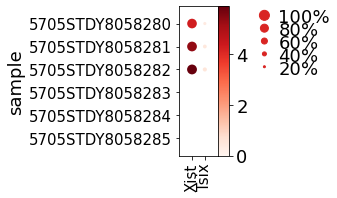

(3031, 7591)


Trying to set attribute `.var` of view, copying.
Trying to set attribute `.var` of view, copying.
Trying to set attribute `.var` of view, copying.
Trying to set attribute `.var` of view, copying.
Trying to set attribute `.var` of view, copying.
Trying to set attribute `.var` of view, copying.


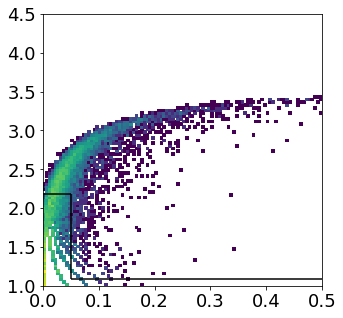

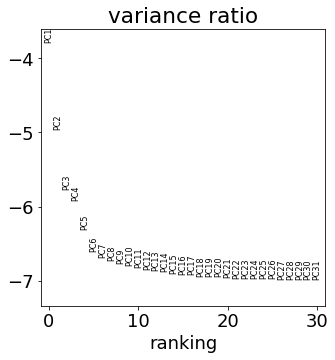

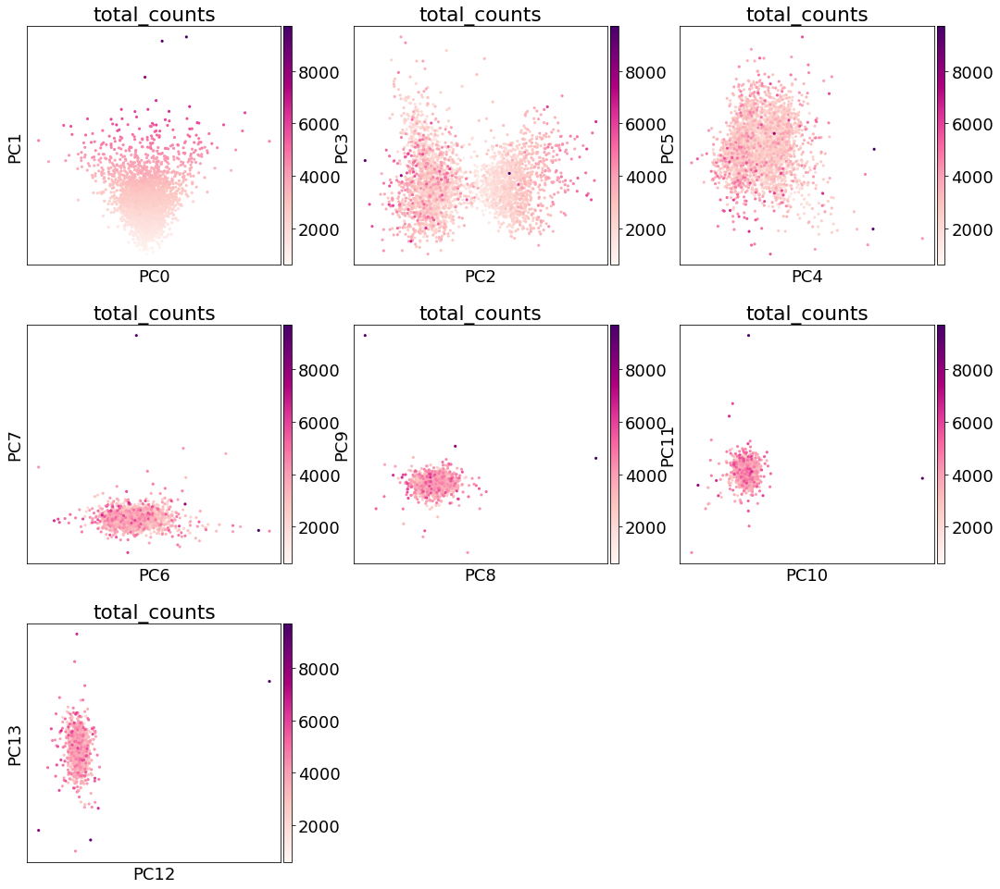

5705STDY8058285    792
5705STDY8058281    584
5705STDY8058280    539
5705STDY8058282    447
5705STDY8058283    394
5705STDY8058284    275
Name: sample, dtype: int64


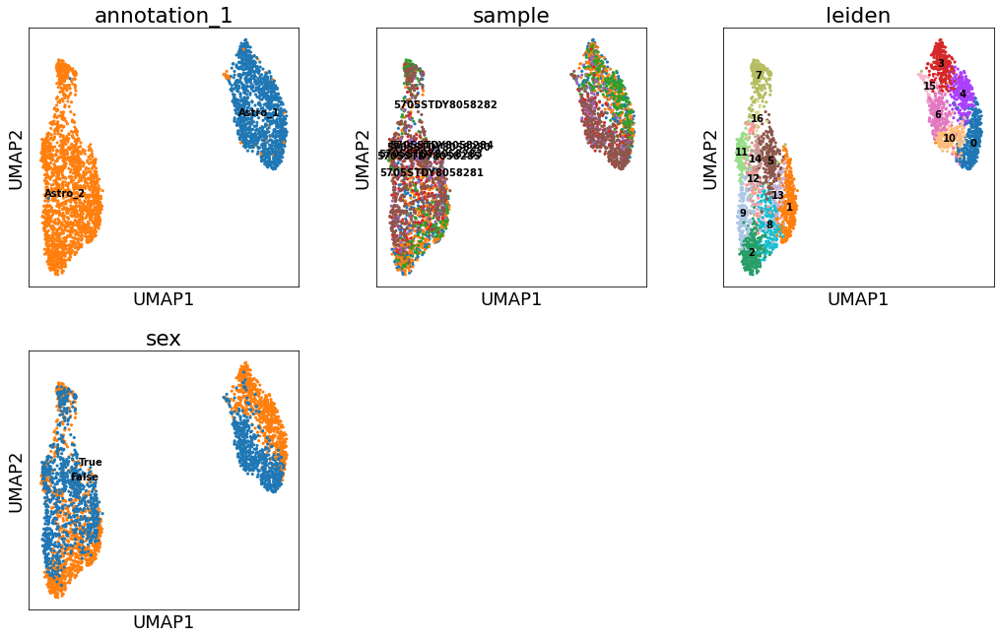

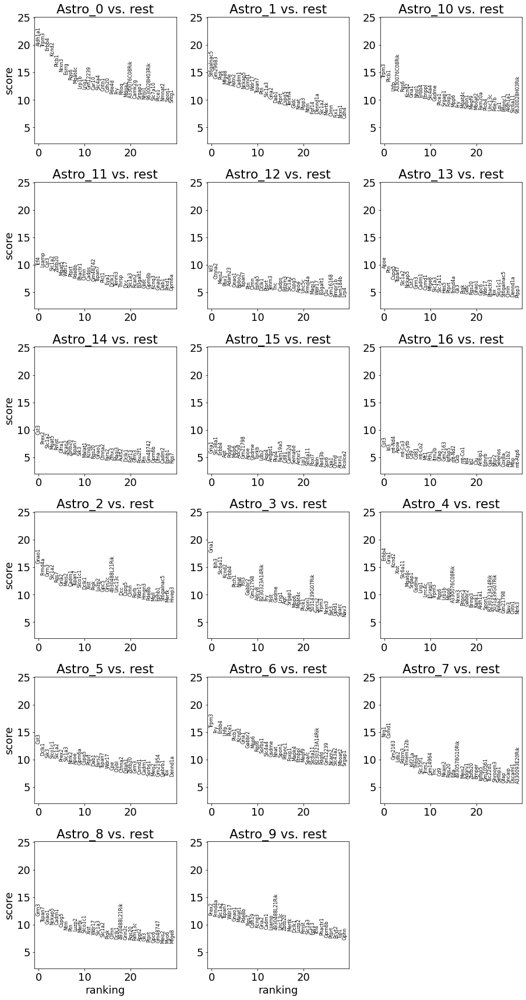

         Falling back to preprocessing with `sc.pp.pca` and default params.


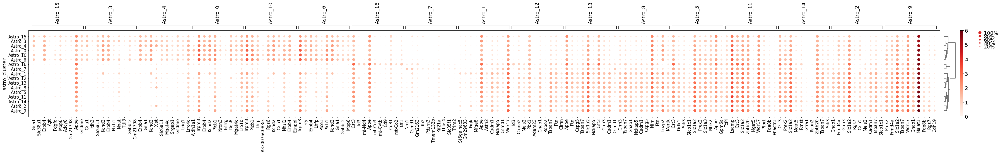

Astro_0     333
Astro_1     284
Astro_2     274
Astro_3     252
Astro_4     242
Astro_5     214
Astro_6     204
Astro_7     200
Astro_8     193
Astro_9     169
Astro_10    163
Astro_11    154
Astro_12    107
Astro_13     86
Astro_14     81
Astro_15     54
Astro_16     21
Name: astro_cluster, dtype: int64


annotation_subclusters,Astro_0,Astro_1,Astro_2,Astro_3,Astro_4
astro_cluster,,,,,
Astro_0,0,69,2,97,0
Astro_1,98,0,37,0,4
Astro_10,0,3,0,0,1
Astro_11,37,0,8,0,5
Astro_12,52,0,20,0,8
Astro_13,35,0,12,0,2
Astro_14,9,0,1,0,0
Astro_15,1,18,0,11,2
Astro_16,5,1,1,0,2


In [37]:
## snRNA reference (raw counts)
astro = anndata.read_h5ad(sc_data_folder + "rawdata/all_cells_20200625.h5ad")

astro.obs['sex'] = [s in ['5705STDY8058281', '5705STDY8058280', '5705STDY8058282'] 
                    for s in astro.obs['sample']]
astro.obs['sex'] = astro.obs['sex'].astype('category')

## Cell type annotations
labels = pd.read_csv(results_folder + 'snRNA_annotation_20200229.csv', index_col=0)

astro = astro[labels.index,]
astro.obs[labels.columns] = labels

# select astrocytes
astro_ind = labels.index[labels['annotation_1'].isin(['Astro_1', 'Astro_2'])]
astro = astro[astro_ind,:]

sc.pl.dotplot(astro, ['Xist', 'Tsix'], groupby='sample', gene_symbols='SYMBOL');

#########################
# keep raw data
astro_raw = astro.copy()

# Select cells
#min_genes = 1000  
rcParams["axes.facecolor"] = "white"

sc.pp.filter_cells(astro, min_genes=1)
sc.pp.filter_genes(astro, min_cells=1)

# calculate the mean of each gene across non-zero cells
astro.var['n_cells'] = (astro.X.toarray() > 0).sum(0)
astro.var['nonz_mean'] = astro.X.toarray().sum(0) / astro.var['n_cells']

plt.hist2d(np.log10(astro.var['nonz_mean']),
           np.log10(astro.var['n_cells']), bins=100,
           norm=matplotlib.colors.LogNorm(),
           range=[[0,0.5], [1,4.5]]);
nonz_mean_cutoff = 0.05
cell_count_cutoff = np.log10(astro.shape[0] * 0.004)
cell_count_cutoff2 = np.log10(astro.shape[0] * 0.05)
plt.vlines(nonz_mean_cutoff, cell_count_cutoff, cell_count_cutoff2);
plt.hlines(cell_count_cutoff, nonz_mean_cutoff, 1);
plt.hlines(cell_count_cutoff2, 0, nonz_mean_cutoff);

print(astro[:,(np.array(np.log10(astro.var['nonz_mean']) > nonz_mean_cutoff)
         | np.array(np.log10(astro.var['n_cells']) > cell_count_cutoff2))
      & np.array(np.log10(astro.var['n_cells']) > cell_count_cutoff)].shape)

# select genes based on mean expression in non-zero cells
astro = astro[:,(np.array(np.log10(astro.var['nonz_mean']) > nonz_mean_cutoff)
         | np.array(np.log10(astro.var['n_cells']) > cell_count_cutoff2))
      & np.array(np.log10(astro.var['n_cells']) > cell_count_cutoff)
              & np.array(~astro.var['SYMBOL'].isna())]

astro.raw = astro
#########################

#sc.pp.regress_out(astro, ['sex'])

sc.pp.log1p(astro)

# Find highly variable genes within each sample
astro.var['highly_variable'] = False
for s in astro.obs['sample'].unique():
    
    astro_1 = astro[astro.obs['sample'].isin([s]), :]
    sc.pp.highly_variable_genes(astro_1, min_mean=0.0012, max_mean=10, min_disp=0.3, n_top_genes=1000)
    
    hvg_list = list(astro_1.var_names[astro_1.var['highly_variable']])
    astro.var.loc[hvg_list, 'highly_variable'] = True
    
#sc.pl.highly_variable_genes(astro)

sc.pp.scale(astro, max_value=10)
sc.tl.pca(astro, svd_solver='arpack', n_comps=70, use_highly_variable=False)
sc.pl.pca_variance_ratio(astro, log=True)
sc.pl.pca(astro, color=['total_counts'],
          components=['0,1', '2,3', '4,5', '6,7', '8,9', '10,11', '12,13'],
          color_map = 'RdPu', ncols = 3, legend_loc='on data',
          legend_fontsize=10, gene_symbols='SYMBOL')
#astro.obsm['X_pca'] = astro.obsm['X_pca'][:, list(range(0, 3)) + list(range(4, astro.obsm['X_pca'].shape[1]))]
#astro.varm['PCs'] = astro.varm['PCs'][:, list(range(0, 3)) + list(range(4, astro.obsm['X_pca'].shape[1]))]
#astro.obsm['X_pca'] = astro.obsm['X_pca'][:, 1:]
#astro.varm['PCs'] = astro.varm['PCs'][:, 1:]
astro.obsm['X_pca'] = astro.obsm['X_pca'][:, 1:]
astro.varm['PCs'] = astro.varm['PCs'][:, 1:]
#########################

#sc.pp.neighbors(astro, n_neighbors = 10, n_pcs = 10, metric='cosine')

import bbknn
bbknn.bbknn(astro, neighbors_within_batch = 3, batch_key = 'sample', n_pcs = 30)
sc.tl.umap(astro, min_dist = 0.2, spread = 0.8)

print(astro.obs['sample'].value_counts())

#########################

sc.tl.leiden(astro, resolution=2.4)

#########################
astro_raw.obs['astro_cluster'] = astro.obs['leiden']
astro_raw.obs['astro_cluster'] = [f'Astro_{i}' for i in astro_raw.obs['astro_cluster']]
astro_raw.obs['astro_cluster'] = astro_raw.obs['astro_cluster'].astype('category')
astro_raw_sel = astro_raw.copy()
sc.tl.rank_genes_groups(astro_raw_sel, 'astro_cluster', method='wilcoxon')
sc.pl.rank_genes_groups(astro_raw_sel, gene_symbols='SYMBOL', n_genes=30, ncols=3)

astro_raw_sel.var_names = astro_raw_sel.var['SYMBOL']
astro_raw_sel.raw = astro_raw_sel

sc.pp.log1p(astro_raw_sel)
sc.tl.rank_genes_groups(astro_raw_sel, 'astro_cluster', method='wilcoxon',
                        #groups=[f'Astro_{i}' for i in range(11)],
                        use_raw=False)

sc.pl.rank_genes_groups_dotplot(astro_raw_sel, n_genes=10, use_raw=False)

sub_labels['astro_cluster'] = astro_raw.obs['astro_cluster'].reindex(index=sub_labels.index)

#########################
astro_raw.obsm['X_umap'] = astro.obsm['X_umap']
astro_raw.obsm['X_pca'] = astro.obsm['X_pca']
astro_markers = ['Unc13c', 'Agt', 
                 'Chrdl1', 'Eogt', 'Igfbp2',
                 'Il33', 'Pamr1', 'Lrig1', 'Hyou1',
                 'Efhd2','Mfge8', 'mt-Co3']

rcParams['figure.figsize'] = 5, 5
rcParams["axes.facecolor"] = "white"
sc.pl.umap(astro_raw, color=['annotation_1', 'sample', 'astro_cluster', 'sex'] + astro_markers,
           color_map = 'RdPu', ncols = 3, legend_loc='on data',
           legend_fontsize=10, gene_symbols='SYMBOL')
sc.pl.dotplot(astro_raw, astro_markers, groupby='astro_cluster', gene_symbols='SYMBOL');


#########################

#adata_snrna_raw.obs['astro_cluster'] = astro_raw.obs['astro_cluster'].reindex(index=adata_snrna_raw.obs_names)
#adata_snrna_raw.obs['annotation_1'][~adata_snrna_raw.obs['astro_cluster'].isna().values] = \
#    adata_snrna_raw.obs['astro_cluster'][~adata_snrna_raw.obs['astro_cluster'].isna().values]

#adata_snrna_raw.obs['annotation_1'].to_csv(results_folder + 'snRNA_annotation_astro_subtypes_20200731.csv')

#########################

print(astro_raw.obs['astro_cluster'].value_counts())
pd.crosstab(sub_labels['astro_cluster'], sub_labels['annotation_subclusters'])

sc.pl.pca(astro, color=['total_counts'],
          components=['0,1', '2,3', '4,5', '6,7', '8,9', '10,11', '12,13'],
          color_map = 'RdPu', ncols = 3, legend_loc='on data',
          legend_fontsize=10, gene_symbols='SYMBOL')

sc.pl.pca(astro, color=['sex'],
          components=['0,1', '2,3', '4,5', '6,7', '8,9', '10,11', '12,13'],
          color_map = 'RdPu', ncols = 3, legend_loc='on data',
          legend_fontsize=10, gene_symbols='SYMBOL')

sc.pl.pca(astro_raw, color=['astro_cluster'],
          components=['0,1', '2,3', '4,5', '6,7', '8,9', '10,11', '12,13'],
          color_map = 'RdPu', ncols = 3, legend_loc='on data',
          legend_fontsize=10, gene_symbols='SYMBOL')

In [38]:
adata_snrna_raw.obs['astro_cluster'] = astro_raw.obs['astro_cluster'].reindex(index=adata_snrna_raw.obs_names)
adata_snrna_raw.obs['annotation_1'] = adata_snrna_raw.obs['annotation_1'].astype(str)
adata_snrna_raw.obs['annotation_1'][~adata_snrna_raw.obs['astro_cluster'].isna().values] = \
    adata_snrna_raw.obs['astro_cluster'][~adata_snrna_raw.obs['astro_cluster'].isna().values]

adata_snrna_raw.obs['annotation_1'].to_csv(f'{results_folder}snRNA_annotation_cortical_astro_subtypes{len(astro_raw.obs["astro_cluster"].unique())}_no_cov_bbknn_20200806.csv')

f'{results_folder}snRNA_annotation_cortical_astro_subtypes{len(astro_raw.obs["astro_cluster"].unique())}_no_cov_bbknn_20200806.csv'

'/nfs/team205/vk7/sanger_projects/cell2location_dev/notebooks/results/mouse_viseum_snrna/snRNA_annotation_cortical_astro_subtypes17_no_cov_bbknn_20200806.csv'

## Subcluster HPC

Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.
... storing 'annotation_1' as categorical


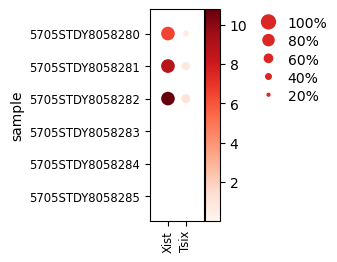

(2442, 10552)


Trying to set attribute `.var` of view, copying.
Trying to set attribute `.var` of view, copying.
Trying to set attribute `.var` of view, copying.
Trying to set attribute `.var` of view, copying.
Trying to set attribute `.var` of view, copying.
Trying to set attribute `.var` of view, copying.


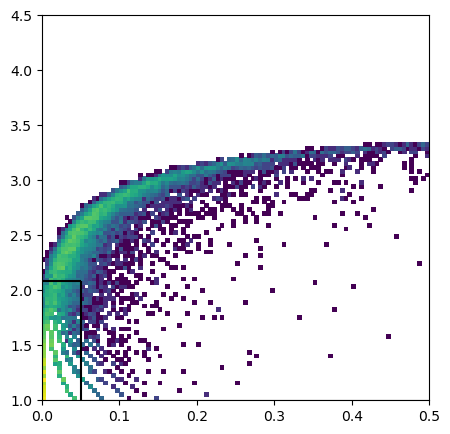

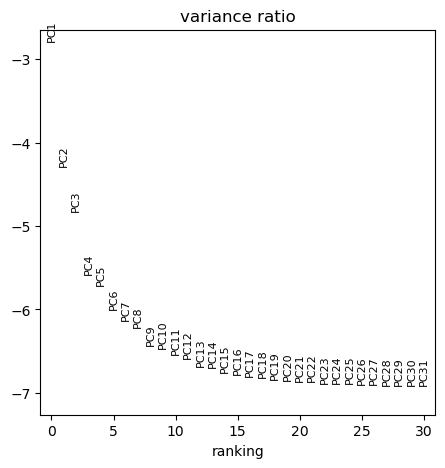

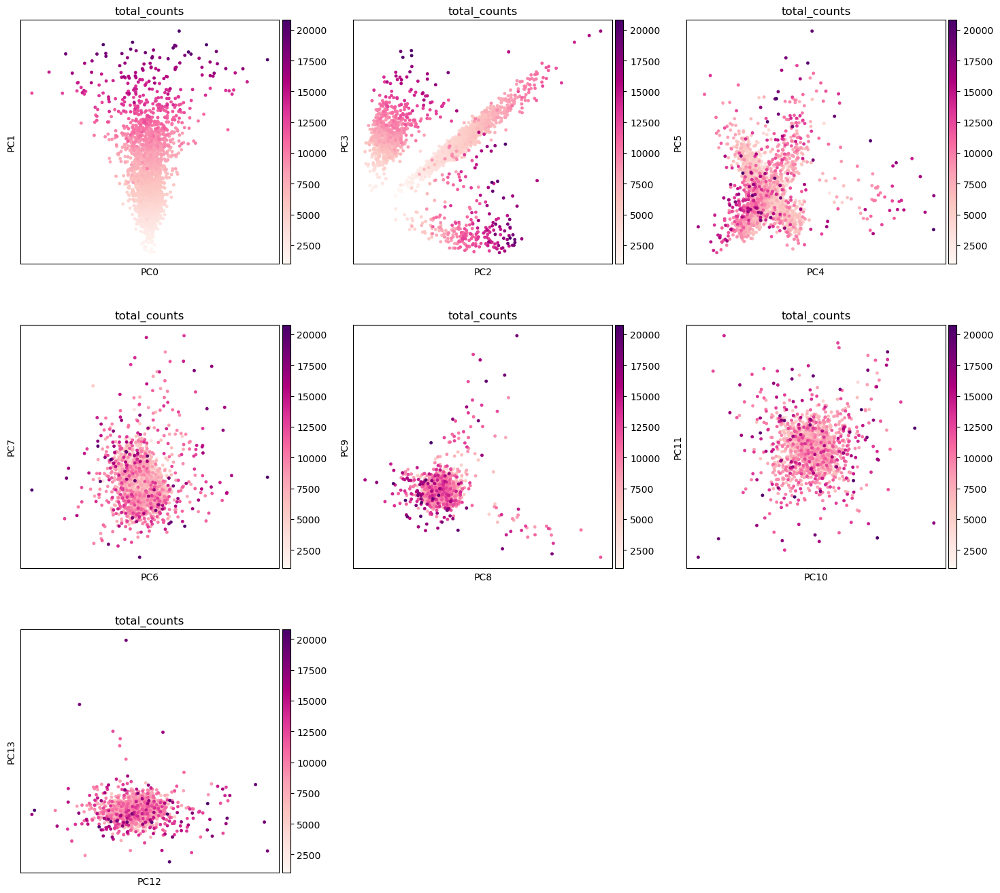

5705STDY8058285    744
5705STDY8058281    594
5705STDY8058280    574
5705STDY8058282    198
5705STDY8058284    178
5705STDY8058283    154
Name: sample, dtype: int64


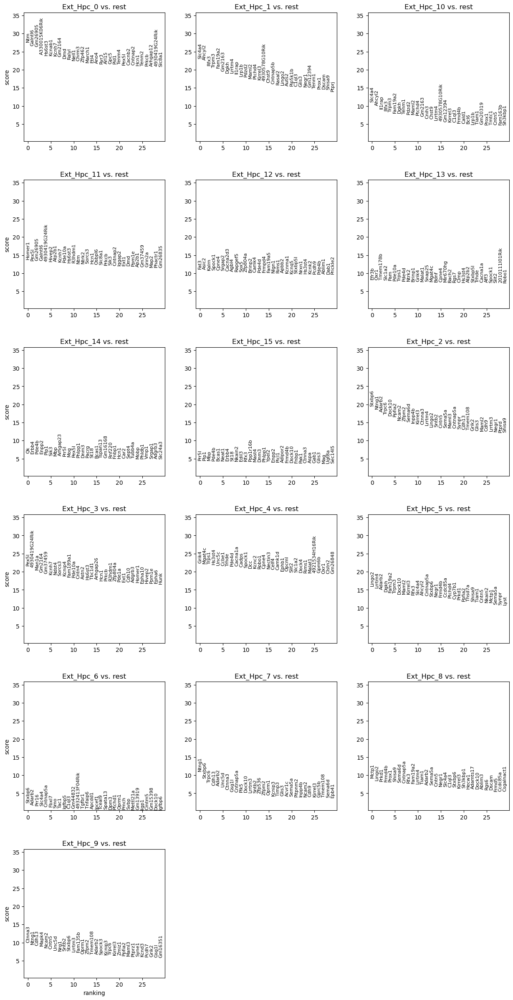

         Falling back to preprocessing with `sc.pp.pca` and default params.


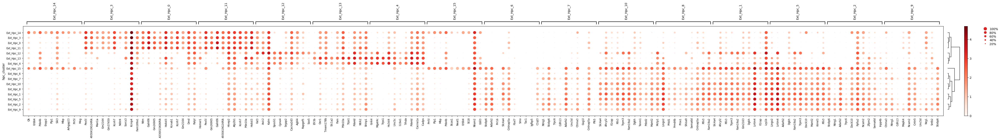

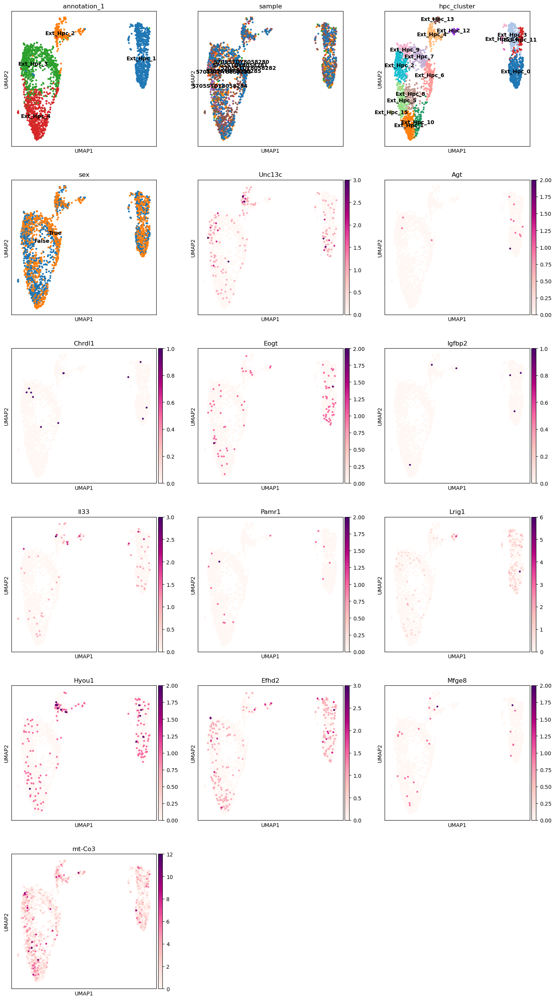

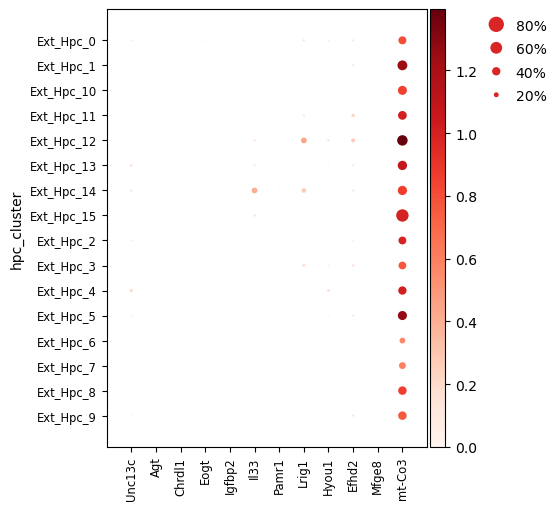

Ext_Hpc_0     355
Ext_Hpc_1     281
Ext_Hpc_2     273
Ext_Hpc_3     217
Ext_Hpc_4     206
Ext_Hpc_5     189
Ext_Hpc_6     184
Ext_Hpc_7     174
Ext_Hpc_8     131
Ext_Hpc_9     120
Ext_Hpc_10    117
Ext_Hpc_11     99
Ext_Hpc_12     48
Ext_Hpc_13     26
Ext_Hpc_14     15
Ext_Hpc_15      7
Name: hpc_cluster, dtype: int64


annotation_subclusters,Ext_Unknown_1,Ext_Unknown_3,Ext_Unknown_6,Ext_Unknown_7
hpc_cluster,,,,
Ext_Hpc_0,241,0,0,0
Ext_Hpc_1,0,0,1,109
Ext_Hpc_10,0,0,2,58
Ext_Hpc_11,64,0,1,0
Ext_Hpc_12,0,27,0,0
Ext_Hpc_13,0,11,0,0
Ext_Hpc_14,7,0,0,0
Ext_Hpc_15,0,0,0,3
Ext_Hpc_2,0,0,130,0


In [86]:
## snRNA reference (raw counts)
astro = anndata.read_h5ad(sc_data_folder + "rawdata/all_cells_20200625.h5ad")

astro.obs['sex'] = [s in ['5705STDY8058281', '5705STDY8058280', '5705STDY8058282'] 
                    for s in astro.obs['sample']]
astro.obs['sex'] = astro.obs['sex'].astype('category')

## Cell type annotations
labels = pd.read_csv(results_folder + 'snRNA_annotation_astro_subtypes_refined61_20200807.csv', index_col=0)

astro = astro[labels.index,]
astro.obs[labels.columns] = labels

# select astrocytes
astro_ind = labels.index[labels['annotation_1'].isin(['Ext_Hpc_1', 'Ext_Hpc_2', 'Ext_Hpc_3', 'Ext_Hpc_4'])]
astro = astro[astro_ind,:]

sc.pl.dotplot(astro, ['Xist', 'Tsix'], groupby='sample', gene_symbols='SYMBOL');

#########################
# keep raw data
astro_raw = astro.copy()

# Select cells
#min_genes = 1000  
rcParams["axes.facecolor"] = "white"

sc.pp.filter_cells(astro, min_genes=1)
sc.pp.filter_genes(astro, min_cells=1)

# calculate the mean of each gene across non-zero cells
astro.var['n_cells'] = (astro.X.toarray() > 0).sum(0)
astro.var['nonz_mean'] = astro.X.toarray().sum(0) / astro.var['n_cells']

plt.hist2d(np.log10(astro.var['nonz_mean']),
           np.log10(astro.var['n_cells']), bins=100,
           norm=matplotlib.colors.LogNorm(),
           range=[[0,0.5], [1,4.5]]);
nonz_mean_cutoff = 0.05
cell_count_cutoff = np.log10(astro.shape[0] * 0.004)
cell_count_cutoff2 = np.log10(astro.shape[0] * 0.05)
plt.vlines(nonz_mean_cutoff, cell_count_cutoff, cell_count_cutoff2);
plt.hlines(cell_count_cutoff, nonz_mean_cutoff, 1);
plt.hlines(cell_count_cutoff2, 0, nonz_mean_cutoff);

print(astro[:,(np.array(np.log10(astro.var['nonz_mean']) > nonz_mean_cutoff)
         | np.array(np.log10(astro.var['n_cells']) > cell_count_cutoff2))
      & np.array(np.log10(astro.var['n_cells']) > cell_count_cutoff)].shape)

# select genes based on mean expression in non-zero cells
astro = astro[:,(np.array(np.log10(astro.var['nonz_mean']) > nonz_mean_cutoff)
         | np.array(np.log10(astro.var['n_cells']) > cell_count_cutoff2))
      & np.array(np.log10(astro.var['n_cells']) > cell_count_cutoff)
              & np.array(~astro.var['SYMBOL'].isna())]

astro.raw = astro
#########################

#sc.pp.regress_out(astro, ['sex'])

sc.pp.log1p(astro)

# Find highly variable genes within each sample
astro.var['highly_variable'] = False
for s in astro.obs['sample'].unique():
    
    astro_1 = astro[astro.obs['sample'].isin([s]), :]
    sc.pp.highly_variable_genes(astro_1, min_mean=0.0012, max_mean=10, min_disp=0.3, n_top_genes=1000)
    
    hvg_list = list(astro_1.var_names[astro_1.var['highly_variable']])
    astro.var.loc[hvg_list, 'highly_variable'] = True
    
#sc.pl.highly_variable_genes(astro)

sc.pp.scale(astro, max_value=10)
sc.tl.pca(astro, svd_solver='arpack', n_comps=70, use_highly_variable=False)
sc.pl.pca_variance_ratio(astro, log=True)
sc.pl.pca(astro, color=['total_counts'],
          components=['0,1', '2,3', '4,5', '6,7', '8,9', '10,11', '12,13'],
          color_map = 'RdPu', ncols = 3, legend_loc='on data',
          legend_fontsize=10, gene_symbols='SYMBOL')
#astro.obsm['X_pca'] = astro.obsm['X_pca'][:, list(range(0, 3)) + list(range(4, astro.obsm['X_pca'].shape[1]))]
#astro.varm['PCs'] = astro.varm['PCs'][:, list(range(0, 3)) + list(range(4, astro.obsm['X_pca'].shape[1]))]
#astro.obsm['X_pca'] = astro.obsm['X_pca'][:, 1:]
#astro.varm['PCs'] = astro.varm['PCs'][:, 1:]
astro.obsm['X_pca'] = astro.obsm['X_pca'][:, 1:]
astro.varm['PCs'] = astro.varm['PCs'][:, 1:]
#########################

#sc.pp.neighbors(astro, n_neighbors = 10, n_pcs = 10, metric='cosine')

import bbknn
bbknn.bbknn(astro, neighbors_within_batch = 3, batch_key = 'sample', n_pcs = 30)
sc.tl.umap(astro, min_dist = 0.2, spread = 0.8)

print(astro.obs['sample'].value_counts())

#########################

sc.tl.leiden(astro, resolution=2)

#########################
astro_raw.obs['hpc_cluster'] = astro.obs['leiden']
astro_raw.obs['hpc_cluster'] = [f'Ext_Hpc_{i}' for i in astro_raw.obs['hpc_cluster']]
astro_raw.obs['hpc_cluster'] = astro_raw.obs['hpc_cluster'].astype('category')
astro_raw_sel = astro_raw.copy()
sc.tl.rank_genes_groups(astro_raw_sel, 'hpc_cluster', method='wilcoxon')
sc.pl.rank_genes_groups(astro_raw_sel, gene_symbols='SYMBOL', n_genes=30, ncols=3)

astro_raw_sel.var_names = astro_raw_sel.var['SYMBOL']
astro_raw_sel.raw = astro_raw_sel

sc.pp.log1p(astro_raw_sel)
sc.tl.rank_genes_groups(astro_raw_sel, 'hpc_cluster', method='wilcoxon',
                        #groups=[f'Astro_{i}' for i in range(11)],
                        use_raw=False)

sc.pl.rank_genes_groups_dotplot(astro_raw_sel, n_genes=10, use_raw=False)

sub_labels['hpc_cluster'] = astro_raw.obs['hpc_cluster'].reindex(index=sub_labels.index)

#########################
astro_raw.obsm['X_umap'] = astro.obsm['X_umap']
astro_raw.obsm['X_pca'] = astro.obsm['X_pca']
astro_markers = ['Unc13c', 'Agt', 
                 'Chrdl1', 'Eogt', 'Igfbp2',
                 'Il33', 'Pamr1', 'Lrig1', 'Hyou1',
                 'Efhd2','Mfge8', 'mt-Co3']

rcParams['figure.figsize'] = 5, 5
rcParams["axes.facecolor"] = "white"
sc.pl.umap(astro_raw, color=['annotation_1', 'sample', 'hpc_cluster', 'sex'] + astro_markers,
           color_map = 'RdPu', ncols = 3, legend_loc='on data',
           legend_fontsize=10, gene_symbols='SYMBOL')
sc.pl.dotplot(astro_raw, astro_markers, groupby='hpc_cluster', gene_symbols='SYMBOL');


#########################

#adata_snrna_raw.obs['astro_cluster'] = astro_raw.obs['astro_cluster'].reindex(index=adata_snrna_raw.obs_names)
#adata_snrna_raw.obs['annotation_1'][~adata_snrna_raw.obs['astro_cluster'].isna().values] = \
#    adata_snrna_raw.obs['astro_cluster'][~adata_snrna_raw.obs['astro_cluster'].isna().values]

#adata_snrna_raw.obs['annotation_1'].to_csv(results_folder + 'snRNA_annotation_astro_subtypes_20200731.csv')

#########################

print(astro_raw.obs['hpc_cluster'].value_counts())
pd.crosstab(sub_labels['hpc_cluster'], sub_labels['annotation_subclusters'])

In [88]:
adata_snrna_raw.obs['hpc_cluster'] = astro_raw.obs['hpc_cluster'].reindex(index=adata_snrna_raw.obs_names)
adata_snrna_raw.obs['annotation_1'] = adata_snrna_raw.obs['annotation_1'].astype(str)
adata_snrna_raw.obs['annotation_1'][~adata_snrna_raw.obs['hpc_cluster'].isna().values] = \
    adata_snrna_raw.obs['hpc_cluster'][~adata_snrna_raw.obs['hpc_cluster'].isna().values]

adata_snrna_raw.obs['annotation_1'].to_csv(f'{results_folder}snRNA_annotation_ext_hpc_subtypes{len(astro_raw.obs["hpc_cluster"].unique())}_no_cov_bbknn_20200806.csv')

f'{results_folder}snRNA_annotation_ext_hpc_subtypes{len(astro_raw.obs["hpc_cluster"].unique())}_no_cov_bbknn_20200806.csv'

'/nfs/team205/vk7/sanger_projects/cell2location_dev/notebooks/results/mouse_viseum_snrna/snRNA_annotation_ext_hpc_subtypes16_no_cov_bbknn_20200806.csv'

## 2. Show UMAP of cells and locations

In [21]:
sc.pp.log1p(adata_snrna_raw)
#sc.pp.highly_variable_genes(adata_snrna_raw, min_mean=0.0125, max_mean=5, min_disp=0.5)
sc.pp.scale(adata_snrna_raw, max_value=10)
sc.tl.pca(adata_snrna_raw, svd_solver='arpack', n_comps=70, use_highly_variable=False)
adata_snrna_raw.obsm['X_pca'] = adata_snrna_raw.obsm['X_pca'][:, 1:]
adata_snrna_raw.varm['PCs'] = adata_snrna_raw.varm['PCs'][:, 1:]
sc.pp.neighbors(adata_snrna_raw, n_neighbors = 15, n_pcs = 69, metric='cosine')

#import bbknn
#bbknn.bbknn(adata_snrna_raw, batch_key='sample_id')
sc.tl.umap(adata_snrna_raw, min_dist = 0.8, spread = 1.5)

... storing 'annotation_1_print' as categorical


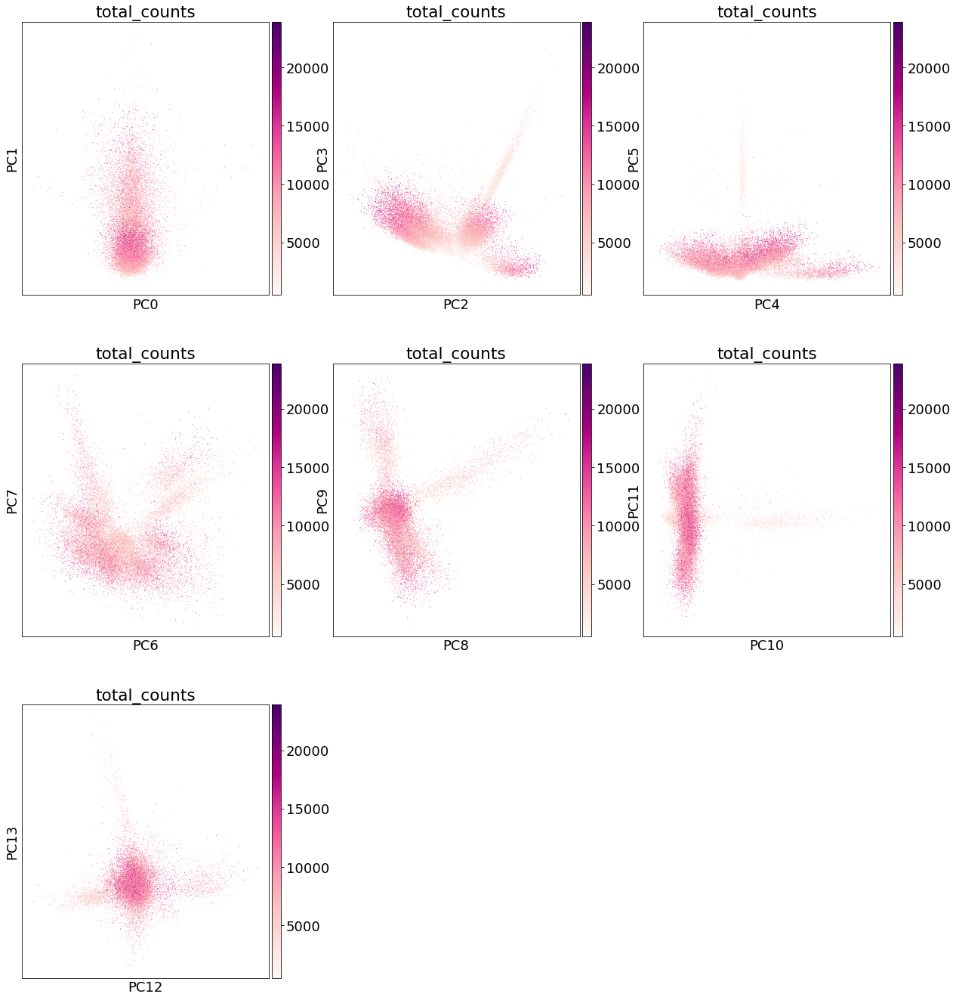

In [22]:
sc.pl.pca(adata_snrna_raw, color=['total_counts'],
          components=['0,1', '2,3', '4,5', '6,7', '8,9', '10,11', '12,13'],
          color_map = 'RdPu', ncols = 3, legend_loc='on data',
          legend_fontsize=10, gene_symbols='SYMBOL')

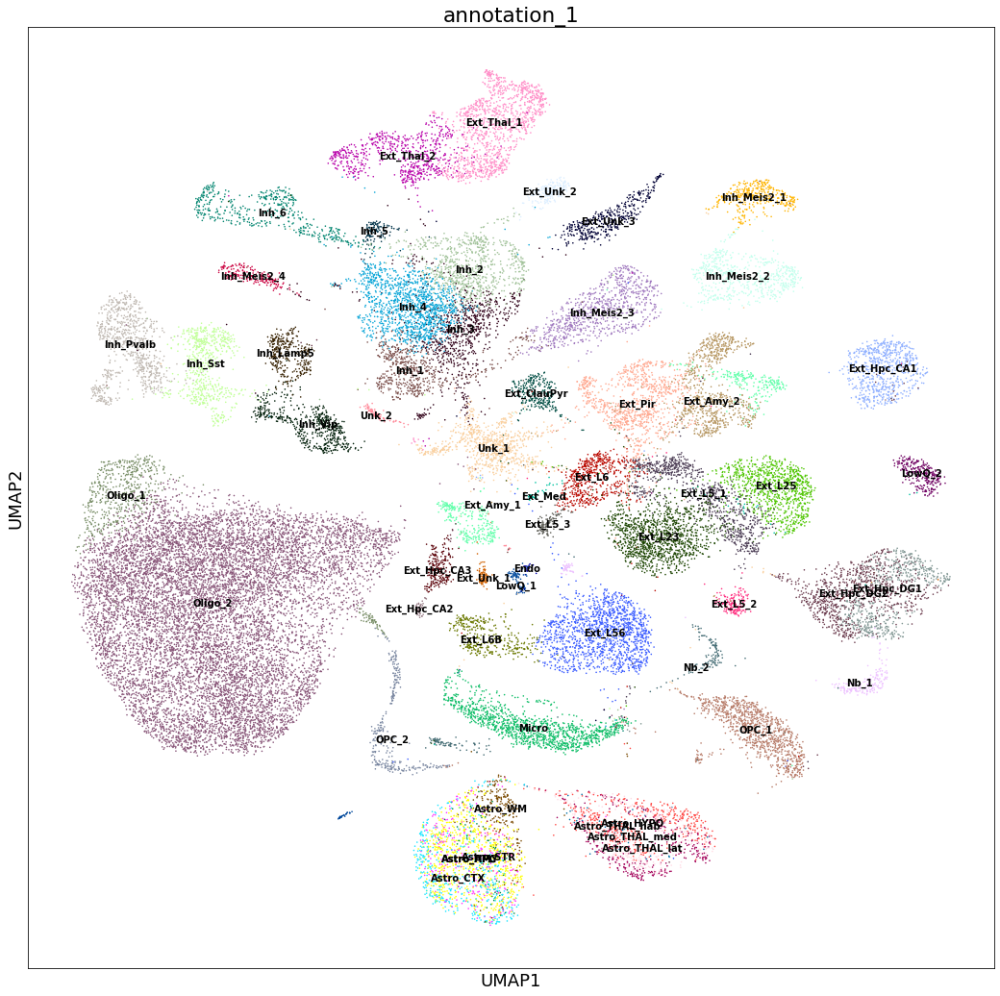

In [23]:
#sc.pp.neighbors(adata_snrna_raw, n_neighbors = 100, n_pcs = 100)
#import bbknn
#bbknn.bbknn(adata_snrna_raw, neighbors_within_batch = 3, batch_key = 'sample', n_pcs = 50)

#sc.tl.umap(adata_snrna_raw, min_dist = 0.5, spread = 1)

rcParams['figure.figsize'] = 18, 18
rcParams["axes.facecolor"] = "white"
sc.pl.umap(adata_snrna_raw, color=['annotation_1'], size=10,
           color_map = 'RdPu', ncols = 1, legend_loc='on data',
           legend_fontsize=10)

#sc.pp.neighbors(adata_snrna_raw, n_neighbors = 100, n_pcs = 100)
#import bbknn
#bbknn.bbknn(adata_snrna_raw, neighbors_within_batch = 3, batch_key = 'sample', n_pcs = 50)

#sc.tl.umap(adata_snrna_raw, min_dist = 0.5, spread = 1)

rcParams['figure.figsize'] = 18, 18
rcParams["axes.facecolor"] = "white"
sc.pl.umap(adata_snrna_raw, color=['Rbfox1'], size=10,
           color_map = 'RdPu', ncols = 1, legend_loc='on data', gene_symbols='SYMBOL',
           legend_fontsize=10)

In [ ]:
sc.settings.set_figure_params(dpi = 150, color_map = 'RdPu', dpi_save = 260, 
                              vector_friendly = True, format = 'pdf',
                              facecolor='white')

rcParams['figure.figsize'] = 8, 10
rcParams["axes.facecolor"] = "white"
rcParams["savefig.facecolor"] = "white"
sc.pl.umap(adata_snrna_raw, color=['annotation_1_int'],
           color_map = 'RdPu', ncols = 1, size=25, legend_loc='on data',
           legend_fontsize=15, frameon=False, save='Fig2B_numbers',
           palette=sc.pl.palettes.default_102)

In [ ]:
sc.settings.set_figure_params(dpi = 150, color_map = 'RdPu', dpi_save = 260, vector_friendly = True, format = 'pdf')

rcParams['figure.figsize'] = 8, 10
rcParams["axes.facecolor"] = "white"
rcParams["savefig.facecolor"] = "white"
sc.pl.umap(adata_snrna_raw, color=['annotation_1_print'],
           color_map = 'RdPu', ncols = 1, size=25, #legend_loc='on data',
           legend_fontsize=10, frameon=False, save='Fig2B',
           palette=sc.pl.palettes.default_102)

Now we look at the UMAP of Visium spots

Trying to set attribute `.var` of view, copying.
Trying to set attribute `.var` of view, copying.
Trying to set attribute `.var` of view, copying.
Trying to set attribute `.var` of view, copying.
Trying to set attribute `.var` of view, copying.
... storing 'sample' as categorical
... storing 'sample_name' as categorical
... storing 'sample_name2' as categorical
... storing 'image_name' as categorical
... storing 'slide' as categorical
... storing 'position' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical
... storing 'SYMBOL' as categorical


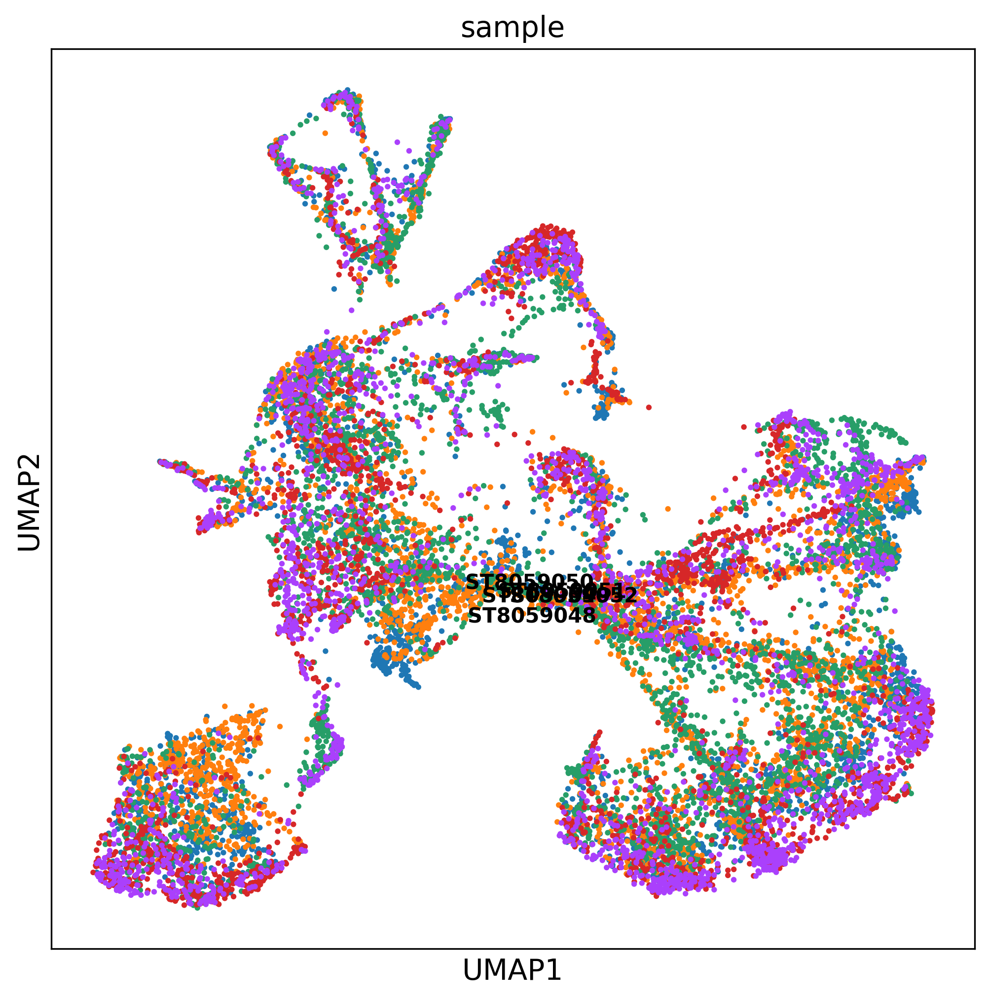

In [20]:
adata_vis_plt = adata_vis.copy()

# Log-transform (log(data + 1))
sc.pp.log1p(adata_vis_plt)

# Find highly variable genes within each sample
adata_vis_plt.var['highly_variable'] = False
for s in adata_vis_plt.obs['sample'].unique():
    
    adata_vis_plt_1 = adata_vis_plt[adata_vis_plt.obs['sample'].isin([s]), :]
    sc.pp.highly_variable_genes(adata_vis_plt_1, min_mean=0.0125, max_mean=5, min_disp=0.5, n_top_genes=1000)
    
    hvg_list = list(adata_vis_plt_1.var_names[adata_vis_plt_1.var['highly_variable']])
    adata_vis_plt.var.loc[hvg_list, 'highly_variable'] = True
    
# Scale the data ( (data - mean) / sd )
sc.pp.scale(adata_vis_plt, max_value=10)
# PCA, KNN construction, UMAP
sc.tl.pca(adata_vis_plt, svd_solver='arpack', n_comps=40, use_highly_variable=True)
sc.pp.neighbors(adata_vis_plt, n_neighbors = 20, n_pcs = 40, metric='cosine')
sc.tl.umap(adata_vis_plt, min_dist = 0.3, spread = 1)

rcParams['figure.figsize'] = 8, 8
rcParams["axes.facecolor"] = "white"
sc.pl.umap(adata_vis_plt, color=['sample'], size=30,
           color_map = 'RdPu', ncols = 1, legend_loc='on data',
           legend_fontsize=10)

# 3. cell2location analysis in two steps: infer and locate regulatory programmes

#```python
rcParams["axes.facecolor"] = "white"

from cell2location import run_regression
from cell2location.models.RegressionNBE3V2Torch import RegressionNBE3V2Torch
r, adata_snrna_raw = run_regression(adata_snrna_raw, 
                   model_name=RegressionNBE3V2Torch,
                   verbose=True, return_all=True,
                                 
                   train_args={
                    'covariate_col_names': ['annotation_1'], 
                    'sample_name_col': 'sample',
                    'tech_id': None,
                    'stratify_cv': 'annotation_1',
                       
                    'n_epochs': 100, 'minibatch_size': 1024, 'learning_rate': 0.01,
                       
                    'use_average_as_initial_value': True, 'use_cuda': True,
                       
                    'train_proportion': 0.9,
                    'l2_weight': True,  # uses defaults for the model
                    
                    'readable_var_name_col': None, 'use_raw': True},
                                 
                   model_kwargs={},
                   posterior_args={},
                                 
                   export_args={'path': results_folder + 'regression_model/', 'save_model': True,
                                'run_name_suffix': ''})

#reg_mod = r['mod']
#adata_snrna_raw = r['sc_data']
#```

### Creating model ### - time 0.04 min
### Analysis name: RegressionNBV2Torch_64covariates_40532cells_12819genes_str
### Training model to determine n_epochs with CV ###


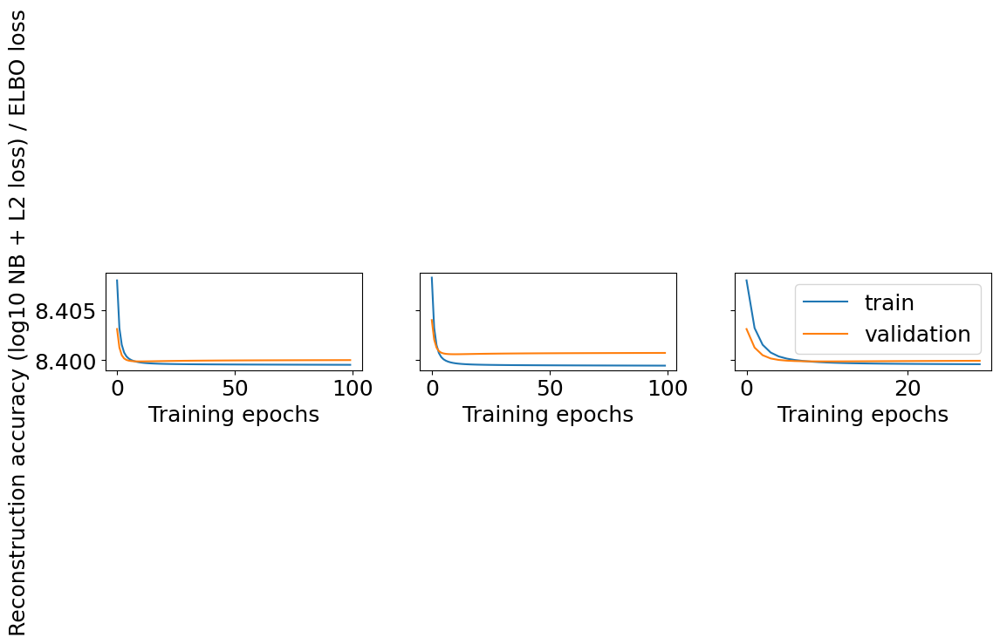

### Re-training model to stop before overfitting ###


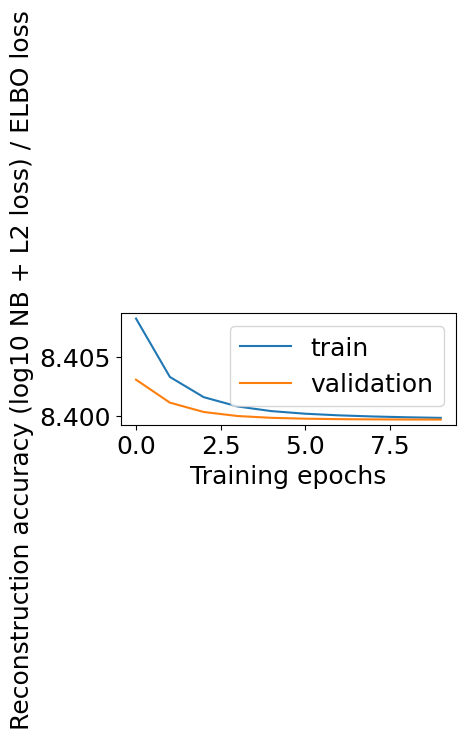

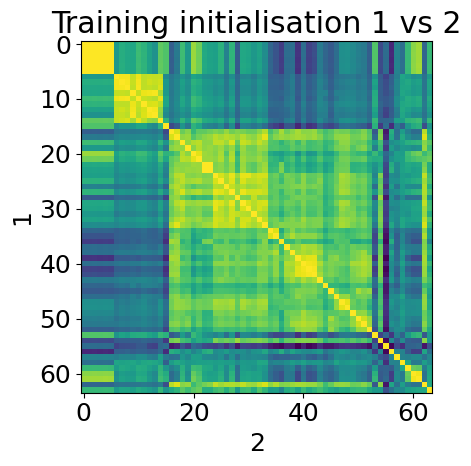

### Evaluating parameters / sampling posterior ### - time 6.55 min


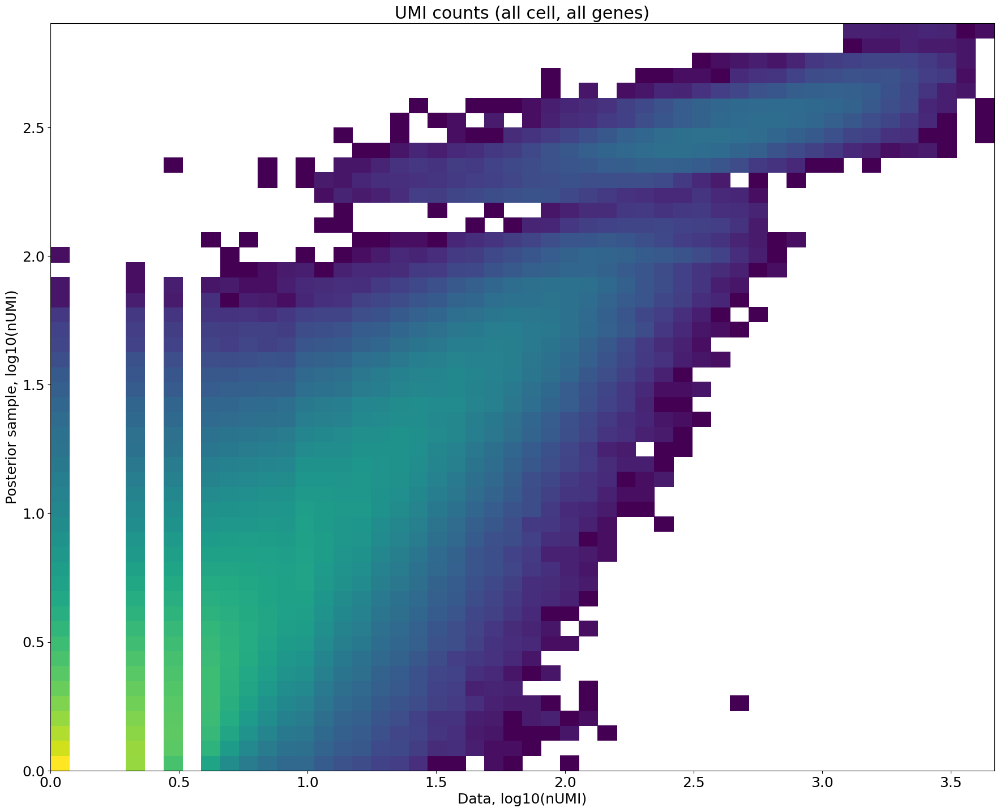

### Saving results ###
### Plotting results ###


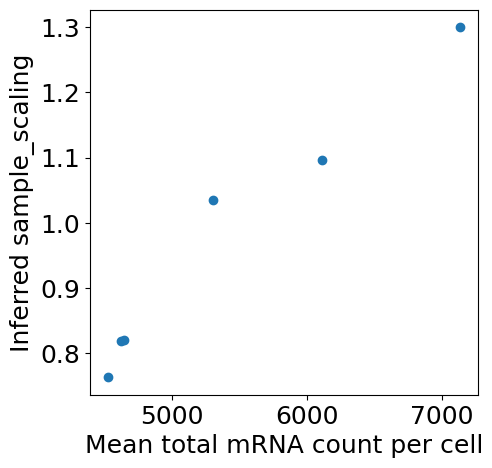

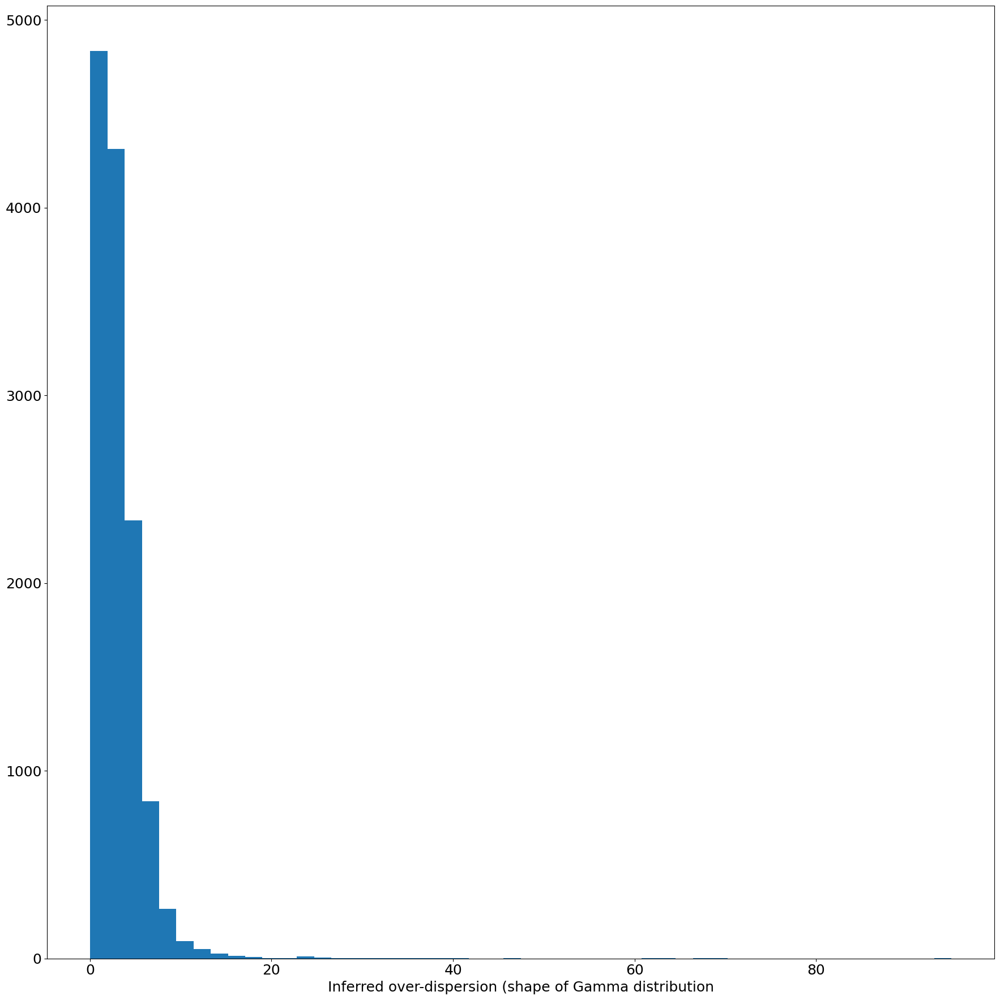

### Done ### - time 7.85 min


In [118]:
rcParams["axes.facecolor"] = "white"

from cell2location import run_regression
r, adata_snrna_raw = run_regression(adata_snrna_raw, 
                   model_name='RegressionNBV2Torch',
                   verbose=True, return_all=True,
                                 
                   train_args={
                    'covariate_col_names': ['annotation_1'], 
                    'sample_name_col': 'sample',
                    'tech_id': None,
                    'stratify_cv': 'annotation_1',
                       
                    'n_epochs': 100, 'minibatch_size': 1024, 'learning_rate': 0.01,
                       
                    'use_average_as_initial_value': True, 'use_cuda': True,
                       
                    'train_proportion': 0.9,
                    'l2_weight': True,  # uses defaults for the model
                    
                    'readable_var_name_col': None, 'use_raw': True},
                                 
                   model_kwargs={},
                   posterior_args={},
                                 
                   export_args={'path': results_folder + 'regression_model/', 'save_model': True,
                                'run_name_suffix': '_str'})

reg_mod = r['mod']
#adata_snrna_raw = r['sc_data']

### Creating model ### - time 0.06 min
### Analysis name: RegressionNBE3V2G2Pyro_68covariates_40532cells_12819genes
### Training model to determine n_epochs with CV ###


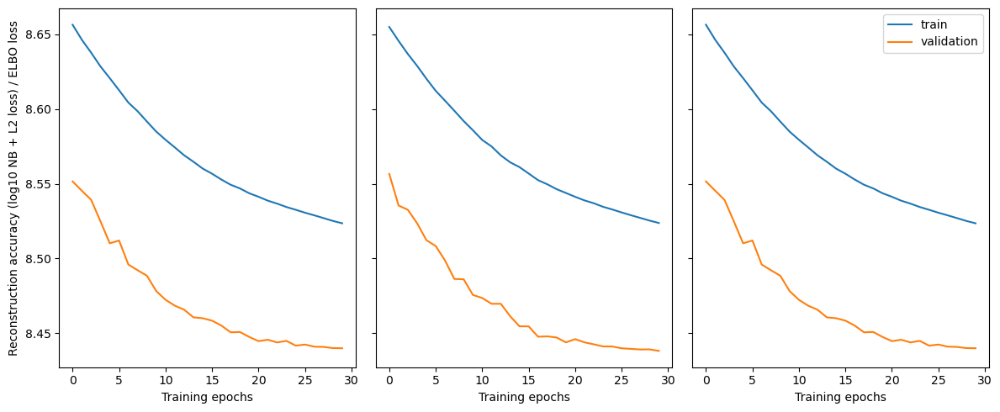

### Loading checkpoint before overfitting: init_1_30.ckp ###



None


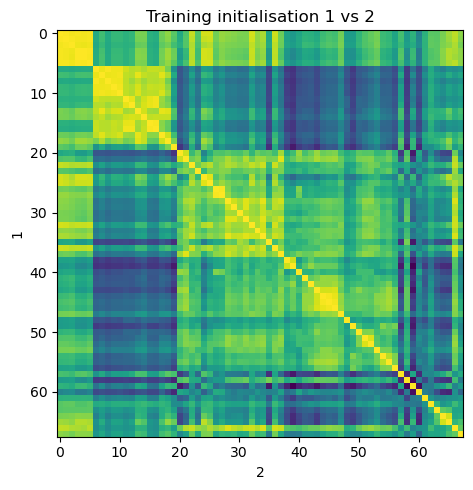

### Evaluating parameters / sampling posterior ### - time 7.94 min


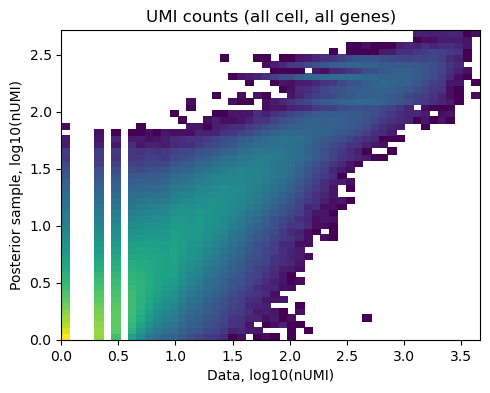

### Saving results ###
### Plotting results ###


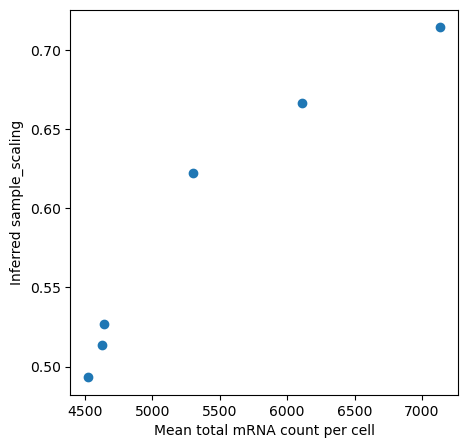

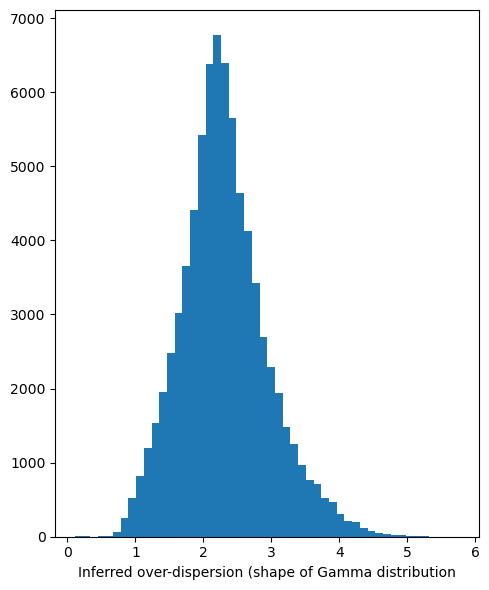

### Done ### - time 11.23 min


In [81]:
rcParams["axes.facecolor"] = "white"

from cell2location import run_regression
from pycell2location.models.RegressionNBE3V2G2Pyro import RegressionNBE3V2G2Pyro
r, adata_snrna_raw = run_regression(adata_snrna_raw, 
                   model_name=RegressionNBE3V2G2Pyro,
                   verbose=True, return_all=True,
                                 
                   train_args={
                    'covariate_col_names': ['annotation_1'],  
                    'sample_name_col': 'sample',
                    'tech_id': None,
                    'stratify_cv': 'annotation_1',
                       
                    'n_epochs': 30, 'minibatch_size': 1024, 'learning_rate': 0.001,
                       
                    'use_average_as_initial_value': True, 'use_cuda': True,
                       
                    'train_proportion': 0.9, 'retrain': False,
                    #'l2_weight': {'l2_weight': 0.001, 'sample_scaling_weight': 0.5,
                    #              'gene_overdisp_weight': 0.1},  # True = use defaults for the model
                    
                    'readable_var_name_col': None, 'use_raw': True},
                                 
                   model_kwargs={
                       'gene_level_prior':{'shape': 0.2, 'rate': 0.2, 'mean_var_ratio': 1},
                       'sample_scaling_prior':{'shape': 6, 'rate': 24},
                       'phi_hyp_prior':{'shape': 20, 'rate': 10},
                   },
                   posterior_args={},
                                 
                   export_args={'path': results_folder + 'regression_model/', 'save_model': False,
                                'run_name_suffix': ''})

reg_mod_pyro = r['mod']
#adata_regions_pyro = r['sc_data']

In [28]:
reg_mod_name = 'RegressionNBV2Torch_71covariates_40554cells_12817genes'
#reg_mod_name = 'RegressionNBE3V2Pyro_65covariates_40556cells_12820genes'
#reg_mod_name = 'RegressionNBV2Torch_66covariates_40554cells_12819genes'
reg_path = f'{results_folder}regression_model/{reg_mod_name}/'

adata_snrna_raw = sc.read(f'{reg_path}sc.h5ad')
r = pickle.load(file = open(f'{reg_path}model_.p', "rb"))
reg_mod = r['mod']

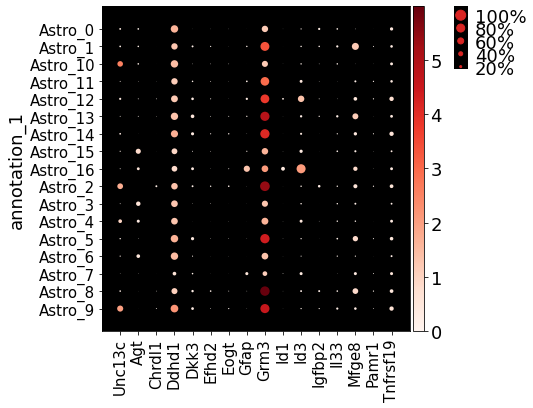

In [29]:
astro_ind = adata_snrna_raw.obs['annotation_1'].isin([f'Astro_{i}' for i in range(21)])
astro = adata_snrna_raw[astro_ind,:]
rcParams["axes.facecolor"] = "black"

sc.pl.dotplot(astro, [
    'Unc13c', 'Agt',
    'Chrdl1',
'Ddhd1',
'Dkk3',
'Efhd2',
'Eogt',
'Gfap',
'Grm3',
'Id1',
'Id3',
'Igfbp2',
'Il33',
#'Kirrel2',
'Mfge8',
'Pamr1',
#'Paqr6',
'Tnfrsf19'], groupby='annotation_1', gene_symbols='SYMBOL');

In [30]:
# New annotation
adata_snrna_raw.obs['annotation_1_old'] = adata_snrna_raw.obs['annotation_1'].copy()
adata_snrna_raw.obs['annotation_1'] = adata_snrna_raw.obs['annotation_1'].astype(str)

# Thalamic
adata_snrna_raw.obs['annotation_1'][adata_snrna_raw.obs['annotation_1'].isin(['Astro_0'])] = \
'Astro_THAL_lat'
adata_snrna_raw.obs['annotation_1'][adata_snrna_raw.obs['annotation_1'].isin(['Astro_4', 'Astro_10'])] = \
'Astro_THAL_med'
adata_snrna_raw.obs['annotation_1'][adata_snrna_raw.obs['annotation_1'].isin(['Astro_15'])] = \
'Astro_THAL_hab'

# Hypothalamic
adata_snrna_raw.obs['annotation_1'][adata_snrna_raw.obs['annotation_1'].isin(['Astro_3'])] = \
'Astro_HYPO'
adata_snrna_raw.obs['annotation_1'][adata_snrna_raw.obs['annotation_1'].isin(['Astro_6'])] = \
'Astro_HYPO_THAL'

# Cortex
adata_snrna_raw.obs['annotation_1'][adata_snrna_raw.obs['annotation_1'].isin(['Astro_1'])] = \
'Astro_AMY_1'
adata_snrna_raw.obs['annotation_1'][adata_snrna_raw.obs['annotation_1'].isin(['Astro_5'])] = \
'Astro_AMY_2'
adata_snrna_raw.obs['annotation_1'][adata_snrna_raw.obs['annotation_1'].isin(['Astro_2', 'Astro_9'])] = \
'Astro_CTX'
adata_snrna_raw.obs['annotation_1'][adata_snrna_raw.obs['annotation_1'].isin(['Astro_11', 'Astro_12'])] = \
'Astro_HPC'
adata_snrna_raw.obs['annotation_1'][adata_snrna_raw.obs['annotation_1'].isin(['Astro_14'])] = \
'Astro_STR'
adata_snrna_raw.obs['annotation_1'][adata_snrna_raw.obs['annotation_1'].isin(['Astro_8', 'Astro_13'])] = \
'Astro_AMY_CTX'

# WM
adata_snrna_raw.obs['annotation_1'][adata_snrna_raw.obs['annotation_1'].isin(['Astro_7'])] = \
'Astro_WM_1'
adata_snrna_raw.obs['annotation_1'][adata_snrna_raw.obs['annotation_1'].isin(['Astro_16'])] = \
'Astro_WM_2'

In [31]:
adata_snrna_raw.obs['annotation_1'].to_csv(f'{results_folder}snRNA_annotation_astro_subtypes_refined{len(adata_snrna_raw.obs["annotation_1"].unique())}_20200807.csv')
f'{results_folder}snRNA_annotation_astro_subtypes_refined{len(adata_snrna_raw.obs["annotation_1"].unique())}_20200807.csv'

'/nfs/team205/vk7/sanger_projects/cell2location_proj/notebooks/results/mouse_viseum_snrna/snRNA_annotation_astro_subtypes_refined58_20200823.csv'

Trying to set attribute `.obs` of view, copying.
... storing 'annotation_1' as categorical


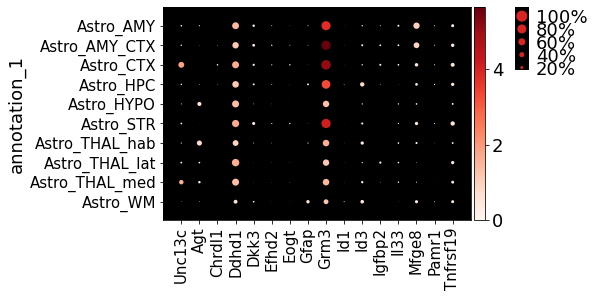

In [32]:
astro_ind = ['Astro_' in i for i in adata_snrna_raw.obs['annotation_1']]
astro = adata_snrna_raw[astro_ind,:]
rcParams["axes.facecolor"] = "black"

sc.pl.dotplot(astro, [
    'Unc13c', 'Agt',
    'Chrdl1',
'Ddhd1',
'Dkk3',
'Efhd2',
'Eogt',
'Gfap',
'Grm3',
'Id1',
'Id3',
'Igfbp2',
'Il33',
#'Kirrel2',
'Mfge8',
'Pamr1',
#'Paqr6',
'Tnfrsf19'], groupby='annotation_1', gene_symbols='SYMBOL');

astro.obs['annotation_1'].value_counts()
rcParams["axes.facecolor"] = "white"

In [65]:
reg_mod_name = 'RegressionNBV2Torch_77covariates_40532cells_12819genes'
#reg_mod_name = 'RegressionNBE3V2Pyro_65covariates_40556cells_12820genes'
#reg_mod_name = 'RegressionNBV2Torch_66covariates_40554cells_12819genes'
reg_path = f'{results_folder}regression_model/{reg_mod_name}/'

adata_snrna_raw = sc.read(f'{reg_path}sc.h5ad')
r = pickle.load(file = open(f'{reg_path}model_.p', "rb"))
reg_mod = r['mod']

In [66]:
# New annotation
adata_snrna_raw.obs['annotation_1_old'] = adata_snrna_raw.obs['annotation_1'].copy()
adata_snrna_raw.obs['annotation_1'] = adata_snrna_raw.obs['annotation_1'].astype(str)

# Thalamic
adata_snrna_raw.obs['annotation_1'][adata_snrna_raw.obs['annotation_1'].isin(['Ext_Hpc_0', 'Ext_Hpc_11', 'Ext_Hpc_3'])] = \
'Ext_Hpc_CA1'
adata_snrna_raw.obs['annotation_1'][adata_snrna_raw.obs['annotation_1'].isin(['Ext_Hpc_12'])] = \
'Ext_Hpc_CA2'
adata_snrna_raw.obs['annotation_1'][adata_snrna_raw.obs['annotation_1'].isin(['Ext_Hpc_13', 'Ext_Hpc_4'])] = \
'Ext_Hpc_CA3'
adata_snrna_raw.obs['annotation_1'][adata_snrna_raw.obs['annotation_1'].isin(['Ext_Hpc_1', 'Ext_Hpc_2'])] = \
'Ext_Hpc_DG1'
adata_snrna_raw.obs['annotation_1'][adata_snrna_raw.obs['annotation_1'].isin(['Ext_Hpc_10', 'Ext_Hpc_5', 'Ext_Hpc_6', 'Ext_Hpc_7', 'Ext_Hpc_8', 'Ext_Hpc_9'])] = \
'Ext_Hpc_DG2'


In [67]:
adata_snrna_raw.obs['annotation_1'].to_csv(f'{results_folder}snRNA_annotation_hpc_subtypes_refined{len(adata_snrna_raw.obs["annotation_1"].unique())}_20200810.csv')
f'{results_folder}snRNA_annotation_hpc_subtypes_refined{len(adata_snrna_raw.obs["annotation_1"].unique())}_20200810.csv'

'/nfs/team205/vk7/sanger_projects/cell2location_dev/notebooks/results/mouse_viseum_snrna/snRNA_annotation_hpc_subtypes_refined62_20200810.csv'

In [113]:
reg_mod_name = 'RegressionNBV2Torch_68covariates_40532cells_12819genes'
#reg_mod_name = 'RegressionNBE3V2G2Pyro_68covariates_40532cells_12819genes'
reg_path = f'{results_folder}regression_model/{reg_mod_name}/'

adata_snrna_raw = sc.read(f'{reg_path}sc.h5ad')
#r = pickle.load(file = open(f'{reg_path}model_.p', "rb"))
#reg_mod = r['mod']

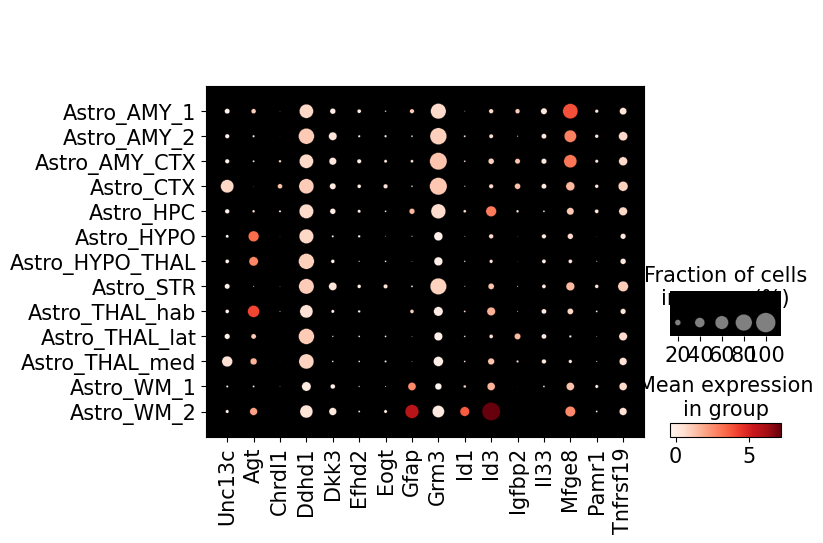

In [114]:
astro_ind = ['Astro_' in i for i in adata_snrna_raw.obs['annotation_1']]
astro = adata_snrna_raw[astro_ind,:]
rcParams["axes.facecolor"] = "black"

sc.pl.dotplot(astro, [
    'Unc13c', 'Agt',
    'Chrdl1',
'Ddhd1',
'Dkk3',
'Efhd2',
'Eogt',
'Gfap',
'Grm3',
'Id1',
'Id3',
'Igfbp2',
'Il33',
#'Kirrel2',
'Mfge8',
'Pamr1',
#'Paqr6',
'Tnfrsf19'], groupby='annotation_1', use_raw=False, gene_symbols='SYMBOL');
rcParams["axes.facecolor"] = "white"

In [110]:
# New annotation
adata_snrna_raw.obs['annotation_1_old'] = adata_snrna_raw.obs['annotation_1'].copy()
adata_snrna_raw.obs['annotation_1'] = adata_snrna_raw.obs['annotation_1'].astype(str)

adata_snrna_raw.obs['annotation_1'][adata_snrna_raw.obs['annotation_1'].isin(['Astro_HYPO', 'Astro_HYPO_THAL'])] = \
'Astro_HYPO'
adata_snrna_raw.obs['annotation_1'][adata_snrna_raw.obs['annotation_1'].isin(['Astro_AMY_1', 'Astro_AMY_2', 'Astro_AMY_CTX'])] = \
'Astro_AMY'
adata_snrna_raw.obs['annotation_1'][adata_snrna_raw.obs['annotation_1'].isin(['Astro_WM_1', 'Astro_WM_2'])] = \
'Astro_WM'

In [115]:
# New annotation
adata_snrna_raw.obs['annotation_1_old'] = adata_snrna_raw.obs['annotation_1'].copy()
adata_snrna_raw.obs['annotation_1'] = adata_snrna_raw.obs['annotation_1'].astype(str)

adata_snrna_raw.obs['annotation_1'][adata_snrna_raw.obs['annotation_1'].isin(['Astro_HYPO', 'Astro_HYPO_THAL'])] = \
'Astro_HYPO'
adata_snrna_raw.obs['annotation_1'][adata_snrna_raw.obs['annotation_1'].isin(['Astro_AMY_1', 'Astro_AMY_CTX'])] = \
'Astro_AMY'
adata_snrna_raw.obs['annotation_1'][adata_snrna_raw.obs['annotation_1'].isin(['Astro_AMY_2', 'Astro_STR'])] = \
'Astro_STR'
adata_snrna_raw.obs['annotation_1'][adata_snrna_raw.obs['annotation_1'].isin(['Astro_WM_1', 'Astro_WM_2'])] = \
'Astro_WM'

In [116]:
adata_snrna_raw.obs['annotation_1'].to_csv(f'{results_folder}snRNA_annotation_astro_subtypes_refined{len(adata_snrna_raw.obs["annotation_1"].unique())}_20200831.csv')
f'{results_folder}snRNA_annotation_astro_subtypes_refined{len(adata_snrna_raw.obs["annotation_1"].unique())}_20200831.csv'

'/nfs/team205/vk7/sanger_projects/cell2location_proj/notebooks/results/mouse_viseum_snrna/snRNA_annotation_astro_subtypes_refined58_20200831.csv'

... storing 'annotation_1' as categorical


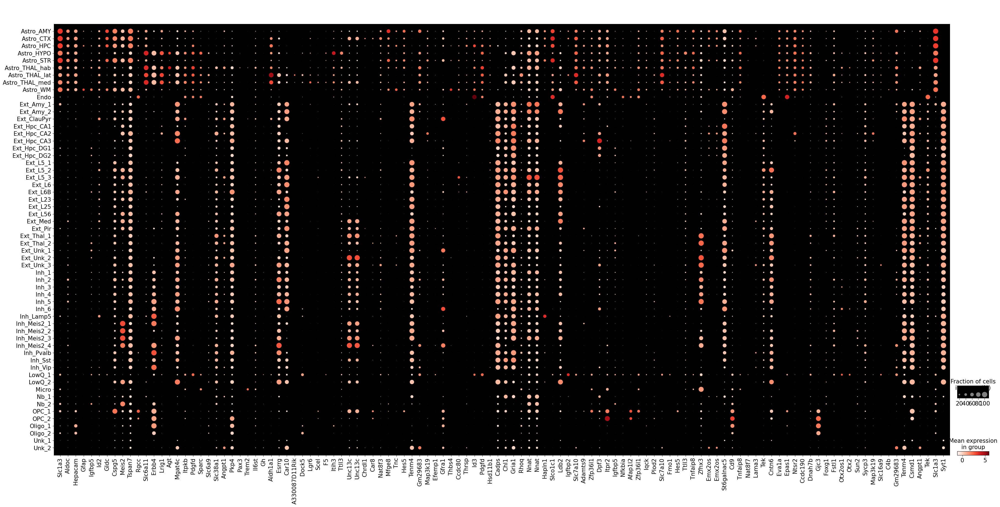

In [117]:
sc_figpath = sc.settings.figdir
sc.settings.figdir = f'{results_folder}regression_model/regions/RegressionNBE3V2G2Pyro_26covariates_15693cells_12819genesshort/marker_plots/'

gene_list = pd.read_csv(f'{sc.settings.figdir}/Subtype_markers.csv', header=0)['Genes']
with matplotlib.rc_context({'axes.facecolor':  'black'}):
    sc.pl.dotplot(adata_snrna_raw, list(gene_list) + ['Angpt1', 'Tek', 'Slc1a3', 'Syt1'], groupby='annotation_1', 
                  gene_symbols='SYMBOL', use_raw=False, 
                  #save=f'selected_panel_aggregated.pdf', 
                  show=True);
sc.settings.figdir = sc_figpath

In [24]:
reg_mod_name = 'RegressionNBV2Torch_65covariates_40532cells_12819genes'
#reg_mod_name = 'RegressionNBE3V2G2Pyro_68covariates_40532cells_12819genes'
reg_path = f'{results_folder}regression_model/{reg_mod_name}/'

adata_snrna_raw = sc.read(f'{reg_path}sc.h5ad')
r = pickle.load(file = open(f'{reg_path}model_.p', "rb"))
reg_mod = r['mod']

reg_mod = reg_mod_pyro

fig, axs = plt.subplots(nrows=5, ncols=2, sharex=True, figsize=(8, 11))

init = 'init_1'
train_proportion = 0.9

col_enum = {0: reg_mod.logp_hist_train[init],
            1: reg_mod.logp_hist_val[init]}

first_n = 500

for row_num, row in enumerate(axs):
    for col_num, ax in enumerate(row):
        data = col_enum[col_num]
        
        if ax.is_last_row():
            ax.set_xlabel('Epoch')
         
        if ax.is_first_row():
            if col_num == 0:
                ax.set_title('Train')           
            if col_num == 1:
                ax.set_title('Validation')         
        
        if row_num == 0:
            ax.plot(data['model'][:first_n], color='C0')
            if ax.is_first_col():
                ax.set_ylabel('Model logp')
                
        if row_num == 1:
            ax.plot(data['guide'][:first_n], color='C1')
            if ax.is_first_col():
                ax.set_ylabel('Guide logp')
        
        if row_num == 2:
            ax.plot(-(np.array(data['model']) - np.array(data['guide']))[:first_n], color='C2')
            if ax.is_first_col():
                ax.set_ylabel('Guide logp - Model logp')
                
        if row_num == 3:
            if col_num == 0:
                ax.plot(reg_mod.training_hist[init][:first_n], color='C3')
            if col_num == 1:
                ax.plot(reg_mod.validation_hist[init][:first_n], color='C3')
            if ax.is_first_col():
                ax.set_ylabel('Loss')
                
        if row_num == 4:
            ax.plot(data['data_target'][:first_n], color='C4')
            if ax.is_first_col():
                ax.set_ylabel('Likelihood')

plt.tight_layout()

plt.suptitle(f'Train proportion: {train_proportion}', y=1.03, x=0.54, size=16);
# plt.savefig(f'train_prop_{train_proportion}_logp_w_0.33.png', dpi=250, bbox_inches='tight')

init = 'init_1'
train_proportion = 0.9

col_enum = {0: reg_mod.logp_hist_train[init].copy(),
            1: reg_mod.logp_hist_val[init].copy()}

first_n = 300

param_name = list(reg_mod.logp_hist_train[init].keys())
param_name = np.array(param_name)[[type(i) == str for i in param_name]]

fig, axs = plt.subplots(nrows=len(param_name),
                        ncols=2, sharex=True, figsize=(8, 11))

for row_num, row in enumerate(axs):
    for col_num, ax in enumerate(row):
        data = col_enum[col_num]
        ax.plot(data[param_name[row_num]][:first_n], color='C4')
        ax.set_ylabel(param_name[row_num])

plt.tight_layout()

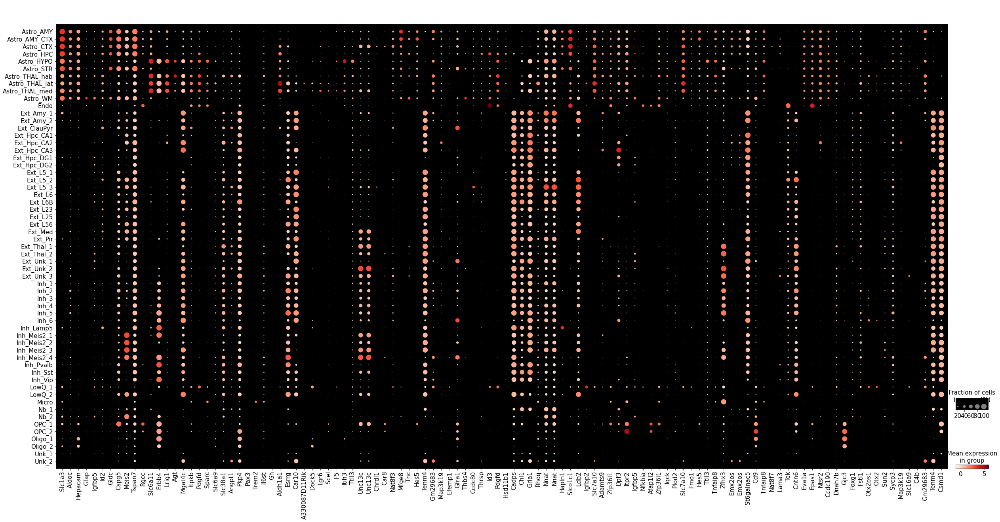

In [25]:
sc_figpath = sc.settings.figdir
sc.settings.figdir = f'{results_folder}regression_model/regions/RegressionNBE3V2G2Pyro_26covariates_15693cells_12819genesshort/marker_plots/'

gene_list = pd.read_csv(f'{sc.settings.figdir}/Subtype_markers.csv', header=0)['Genes']
with matplotlib.rc_context({'axes.facecolor':  'black'}):
    sc.pl.dotplot(adata_snrna_raw, gene_list, groupby='annotation_1', 
                  gene_symbols='SYMBOL', use_raw=False, 
                  save=f'selected_panel_aggregated.pdf', 
                  show=True);
sc.settings.figdir = sc_figpath

In [26]:
# export inferred averages in each cluster
inf_aver = adata_snrna_raw.var.copy()
inf_aver = inf_aver.loc[:, [f'mean_cov_effect_annotation_1_{i}' for i in adata_snrna_raw.obs['annotation_1'].unique()]]
from re import sub
inf_aver.columns = [sub(f'mean_cov_effect_annotation_1_{i}', '', i) for i in adata_snrna_raw.obs['annotation_1'].unique()]
inf_aver = inf_aver.iloc[:, inf_aver.columns.argsort()]

# scale up by average sample scaling factor
inf_aver = inf_aver * adata_snrna_raw.uns['regression_mod']['post_sample_means']['sample_scaling'].mean()

In [27]:
inf_aver

,Astro_AMY,Astro_AMY_CTX,Astro_CTX,Astro_HPC,Astro_HYPO,Astro_STR,Astro_THAL_hab,Astro_THAL_lat,Astro_THAL_med,Astro_WM,...,LowQ_2,Micro,Nb_1,Nb_2,OPC_1,OPC_2,Oligo_1,Oligo_2,Unk_1,Unk_2
ENSEMBL,,,,,,,,,,,,,,,,,,,,,
ENSMUSG00000051951,0.006652,0.013381,0.009672,0.010551,0.016396,4.362995e-09,3.918688e-03,0.012995,0.020950,0.053045,...,6.475789,0.009182,2.363688,0.569750,2.202130,0.773202,2.177433,0.885846,1.399780,1.228170
ENSMUSG00000089699,0.001501,0.001095,0.002055,0.000696,0.003748,1.116136e-02,5.403521e-09,0.001581,0.001147,0.009992,...,1.259508,0.000859,0.512654,0.132410,0.383906,0.165249,0.423312,0.161883,0.227617,0.174571
ENSMUSG00000033845,0.114207,0.054338,0.085309,0.059021,0.066498,2.202430e-02,6.959011e-02,0.064746,0.104896,0.060093,...,0.214894,0.039218,0.108909,0.095944,0.084072,0.094551,0.077346,0.054940,0.041642,0.113457
ENSMUSG00000033813,0.088453,0.097077,0.129549,0.093324,0.080831,1.292675e-01,6.526587e-02,0.057145,0.082130,0.081030,...,0.194244,0.063650,0.084617,0.121712,0.108767,0.181124,0.140567,0.066971,0.013325,0.091371
ENSMUSG00000002459,3.596771,4.084791,4.167773,3.955367,1.140844,3.839240e+00,1.391272e+00,1.597041,1.308752,4.189671,...,0.062062,0.004818,0.133042,1.217572,0.614752,0.097037,0.037659,0.004848,0.107176,0.120861
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ENSMUSG00000064370,0.154425,0.135329,0.106853,0.123680,0.061573,8.559838e-02,2.359829e-01,0.087570,0.072310,0.312812,...,0.184294,0.044913,0.130184,0.070209,0.112571,0.116551,0.049836,0.060489,0.038373,0.070576
ENSMUSG00000051412,0.042569,0.033413,0.051312,0.052405,0.043928,5.851342e-02,5.412691e-09,0.033294,0.038056,0.069674,...,0.083921,0.012877,0.063890,0.057759,0.083447,0.102482,0.096118,0.067913,0.023124,0.097860
ENSMUSG00000079834,0.233599,0.240260,0.301797,0.227757,0.257566,4.087606e-01,1.732663e-01,0.321039,0.316733,0.072512,...,0.189396,0.059993,0.077447,0.020228,0.286553,0.304142,0.255407,0.111864,0.034153,0.088070


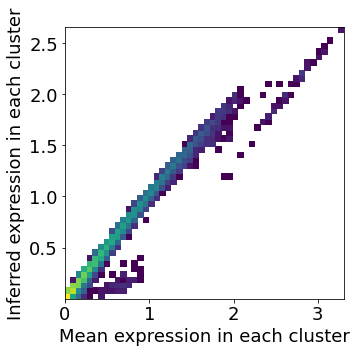

In [28]:
# compute mean expression of each gene in each cluster
aver = cell2location.cluster_averages.cluster_averages.get_cluster_averages(adata_snrna_raw, 'annotation_1')
aver = aver.loc[adata_snrna_raw.var_names, inf_aver.columns]

# export inferred averages in each cluster
#inf_aver = reg_mod.covariate_effects.copy()
#from re import sub
#inf_aver.columns = [sub('mean_cov_effect_Subset_', '', i) for i in inf_aver.columns]
#inf_aver = inf_aver.loc[aver.index, aver.columns]

rcParams['figure.figsize'] = 5, 5
plt.hist2d(np.log10(aver.values.flatten()+1), np.log10(inf_aver.values.flatten()+1),
           bins=50, norm=matplotlib.colors.LogNorm());
plt.xlabel('Mean expression in each cluster');
plt.ylabel('Inferred expression in each cluster');

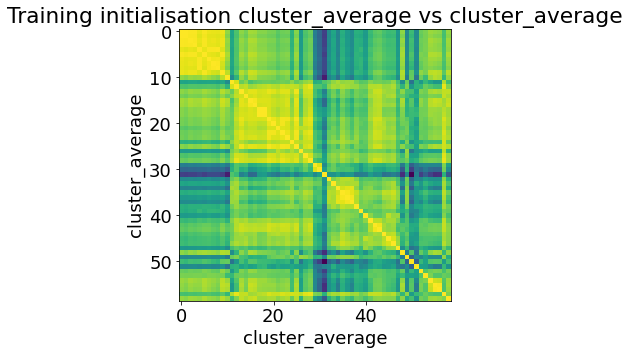

In [29]:
rcParams['figure.figsize'] = 5, 5
reg_mod.align_plot_stability(aver, aver, 'cluster_average', 'cluster_average', align=False)

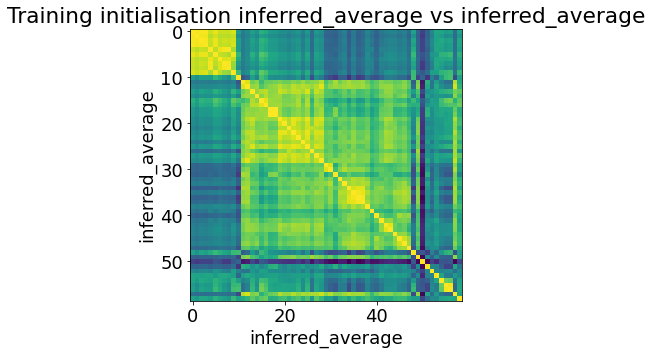

In [30]:
rcParams['figure.figsize'] = 5, 5
reg_mod.align_plot_stability(inf_aver, inf_aver, 'inferred_average', 'inferred_average', align=False)

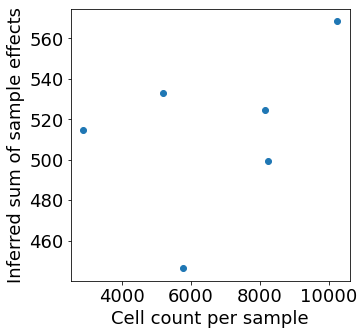

In [31]:
rcParams['figure.figsize'] = 5, 5
cell_count = adata_snrna_raw.obs['sample'].value_counts()
cell_count.index = ['mean_sample_effectsample_' + i for i in cell_count.index] 

soup_amount = reg_mod.sample_effects.sum(0) 
plt.scatter(cell_count[soup_amount.index].values.flatten(),
            soup_amount.values.flatten());
plt.xlabel('Cell count per sample'); # fraction of reads in cells
plt.ylabel('Inferred sum of sample effects');

adata_snrna_raw_cor = adata_snrna_raw.copy()
adata_snrna_raw_cor.X = reg_mod.normalise(adata_snrna_raw_cor.raw.X)+0.0001
#del adata_snrna_raw_cor.uns['log1p']
#adata_snrna_raw_cor.X = normalise(reg_mod, adata_snrna_raw_cor.raw.X)

#sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata_snrna_raw_cor)
sc.pp.highly_variable_genes(adata_snrna_raw_cor, min_mean=0.0125, max_mean=5, 
                            min_disp=0.5, n_top_genes=3000)
sc.pp.scale(adata_snrna_raw_cor, max_value=10)
sc.tl.pca(adata_snrna_raw_cor, svd_solver='arpack', n_comps=70, use_highly_variable=True)
sc.pp.neighbors(adata_snrna_raw_cor, n_neighbors = 15, n_pcs = 70, metric='cosine')
#import bbknn
#bbknn.bbknn(adata_snrna_raw_cor, batch_key='sample_id')
sc.tl.umap(adata_snrna_raw_cor, min_dist = 0.8, spread = 1)

rcParams['figure.figsize'] = 7, 7
rcParams["axes.facecolor"] = "white"
sc.pl.umap(adata_snrna_raw_cor, color=["Study", 'Donor', 'Method', 'Subset_Broad', 'Subset_print', 'Subset_int'],
           color_map = 'RdPu', ncols = 2, size=13, #legend_loc='on data',
           legend_fontsize=10, palette=sc.pl.palettes.default_102)

## Run cell2location

Here we show how to perform the first step in one function run - train cell2location model to learn cell locations. Results are shown below and saved to:  

In [33]:
results_folder + 'std_model/'

'/nfs/team205/vk7/sanger_projects/cell2location_proj/notebooks/results/mouse_viseum_snrna/std_model/'

In [34]:
from pycell2location.models.CoLocationModelNB4E5V2 import CoLocationModelNB4E5V2

In [125]:
r = cell2location.run_cell2location(
                      sc_data=inf_aver, 
                      sp_data=adata_vis,
                      model_name=CoLocationModelNB4E3V2,
                      verbose=True, return_all=False,
                      
                      summ_sc_data_args={'cluster_col': "annotation_1"},
                                      
                      train_args={'use_raw': True,
                                  'n_iter': 30000, 'learning_rate': 0.005,
                                  'sample_prior': False, # set to false for large spatial data 
                                  'readable_var_name_col': None,
                                  'sample_name_col': 'sample'},
                                      
                      posterior_args={'n_samples': 1000},
                                      
                      export_args={'path': results_folder + 'std_model/', 
                                   'run_name_suffix': '_n_comb100_mean_var5_inferred_30k_str',
                                   'save_model': False,
                                   'scanpy_coords_name': 'spatial', 'export_q05': True},
    
                      model_kwargs={ # Prior on the number of cells, cell types and co-located combinations
          
                    'cell_number_prior': {
                        # Use visual inspection of the tissue image to determine 
                        # the average number of cells per spot,
                        # an approximate count is good enough:
                        'cells_per_spot': 8, 
                        # Prior on the number of cell types (or factors) in each spot
                        'factors_per_spot': 9, 
                        # Prior on the number of correlated cell type combinations in each spot
                        'combs_per_spot': 5
                    },
          
                     # Prior on change in sensitivity between technologies
                    'gene_level_prior':{
                        # Prior on average change in expression level from scRNA-seq to spatial technology,
                        # this reflects your belief about the sensitivity of the technology in you experiment
                        'mean': 1/2, 
                        # Prior on how much individual genes differ from that average,
                        # a good choice of this value should be lower that the mean
                        'sd': 1/4
                    },
                          
                     # The number of co-located cell type combinations
                    'n_comb': 100, 'spot_fact_mean_var_ratio': 5,
                    'exper_gene_level_mean_var_ratio': 5
      }
)

### Summarising single cell clusters ###
### Creating model ### - time 0.14 min


WARNING (theano.gof.cmodule): Removing key file /nfs/users/nfs_v/vk7/.theano/compiledir_Linux-4.15--generic-x86_64-with-debian-buster-sid-x86_64-3.7.6-64/tmp6kp2_h2z/key.pkl because the corresponding module is gone from the file system.
WARNING (theano.gof.cmodule): Removing key file /nfs/users/nfs_v/vk7/.theano/compiledir_Linux-4.15--generic-x86_64-with-debian-buster-sid-x86_64-3.7.6-64/tmpjnww792o/key.pkl because the corresponding module is gone from the file system.
WARNING (theano.gof.cmodule): Removing key file /nfs/users/nfs_v/vk7/.theano/compiledir_Linux-4.15--generic-x86_64-with-debian-buster-sid-x86_64-3.7.6-64/tmpnfd21d28/key.pkl because the corresponding module is gone from the file system.
WARNING (theano.gof.cmodule): Removing key file /nfs/users/nfs_v/vk7/.theano/compiledir_Linux-4.15--generic-x86_64-with-debian-buster-sid-x86_64-3.7.6-64/tmpx_mtfjqt/key.pkl because the corresponding module is gone from the file system.


### Analysis name: CoLocationModelNB4E3V2_58clusters_14968locations_12809genes_n_comb100_mean_var5_inferred_30k_str
### Training model ###


Finished [100%]: Average Loss = 1.5294e+08


Finished [100%]: Average Loss = 1.5293e+08



### Sampling posterior ### - time 135.55 min



### Saving results ###


... storing 'sample' as categorical
... storing 'sample_name' as categorical
... storing 'sample_name2' as categorical
... storing 'image_name' as categorical
... storing 'slide' as categorical
... storing 'position' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical
... storing 'SYMBOL' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical
... storing 'SYMBOL' as categorical


### Ploting results ###
### Plotting posterior of W / cell locations ###


### Done ### - time 162.39 min


Trained model object can be pulled from `r['mod']`, cell locations are added to `r['sp_data']` as columns of `sp_data.obs` and all paramters of the model are exported to `sp_data.uns['mod']`. This anndata object and a csv file `W.csv` / `W_q05.csv` with cell locations are always saved to the results directory. 

When `'save_model': True`, the trained model `r['mod']` is also saved as a pickle file. You can load the model later and continue training. 

Now we need to check if our model has trained successfully by looking at the loss / cost function over training iterations. This plot omits the first 20% of training iterations during which loss changes by orders of magnitude.

#### Evaluating training

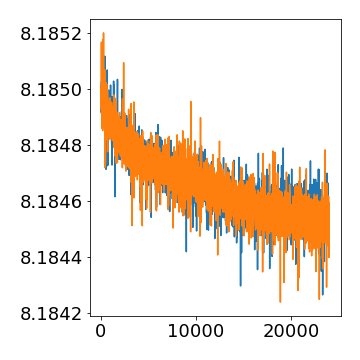

In [32]:
r = {'run_name': 'CoLocationModelNB4E3V2_59clusters_14968locations_12809genes_n_comb100_mean_var5_inferred_30k'}
#r = {'run_name': 'CoLocationModelNB4E3V2_58clusters_14968locations_12809genes_n_comb100_mean_var5_inferred_30k'}
#r = {'run_name': 'CoLocationModelNB4E3V2_58clusters_14968locations_12809genes_n_comb100_mean_var5_inferred_30k_str'}
#r = {'run_name': 'CoLocationModelNB4E3V2_62clusters_14968locations_12809genes_n_comb100_mean_var5_inferred_30k'}

from IPython.display import Image
Image(filename=results_folder + 'std_model/'+r['run_name']+'/plots/training_history_without_first_20perc.png',
      width=400)

We also need to evaluate the reconstruction accuracy or how well cell types and uniform background explain spatial data bu comparing expected value of the model (Poisson mean) to observed count of each gene across locations. The ideal case is perfect diagonal plot.

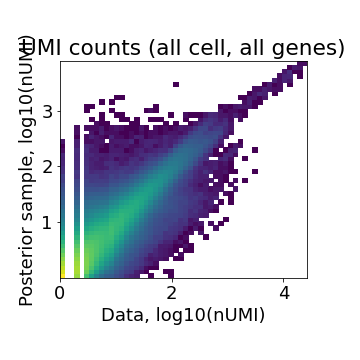

In [33]:
Image(filename=results_folder + 'std_model/'+r['run_name']+'/plots/data_vs_posterior_mean.png',
      width=400)

Finally, we need to evaluate robustness of the identified locations by comparing consistency of inferred locations between two independent training restarts.

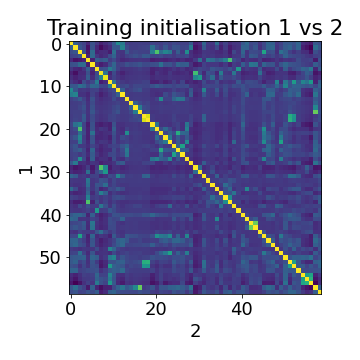

In [34]:
Image(filename=results_folder + 'std_model/'+r['run_name']+'/plots/evaluate_stability.png',
      width=400)

#### Loading saved results

We can load our model and associated object after training (this also needs a GPU to be available and we need to know the analysis name):

```python
pickle_model = results_folder + 'std_model/'+r['run_name']+'/model_.p'
r = pickle.load(open(pickle_model, "rb"))

adata_vis = r['sp_data']
```

Alternatively we can load the results of the model saved into `sp_data`:

In [32]:
sp_data_file = results_folder + 'std_model/'+r['run_name']+'/sp.h5ad'
adata_vis = anndata.read(sp_data_file)

In [35]:
sp_data_file = results_folder + 'std_model/'+r['run_name']+'/sp_with_clusters.h5ad'
adata_vis = anndata.read(sp_data_file)

In [36]:
adata_vis.uns['mod']['post_sample_means']['phi_hyp'], adata_vis.uns['mod']['post_sample_sds']['phi_hyp']

(array([[1.8089936]], dtype=float32), array([[0.00706432]], dtype=float32))

adata_vis.uns['mod']['post_sample_means']['phi_spot_hyp'], adata_vis.uns['mod']['post_sample_sds']['phi_spot_hyp']

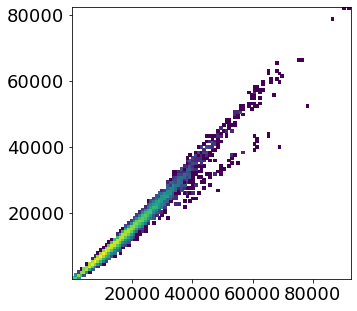

In [37]:
rcParams["axes.facecolor"] = "white"
rcParams["figure.figsize"] = [5,5]
plt.hist2d(adata_vis.obs['total_counts'].values,
           adata_vis.uns['mod']['post_sample_means']['nUMI_factors'].sum(1).flatten(),
           bins=100, norm=matplotlib.colors.LogNorm());

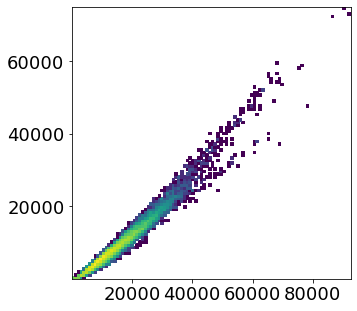

In [38]:
plt.hist2d(adata_vis.obs['total_counts'].values,
           adata_vis.uns['mod']['post_sample_q05']['nUMI_factors'].sum(1).flatten(),
           bins=100, norm=matplotlib.colors.LogNorm());

#### Advanced plotting of cell locations

Now we add cell locations to each slide to plot them over histology images.

In [39]:
col_sel = ['mean_nUMI_factors' in i for i in adata_vis.obs.columns]
for s in slides.keys():
    obs = adata_vis.obs.loc[:,col_sel].loc[slides[s].obs.index,:]
    slides[s].obs[obs.columns] = obs
    
col_sel = ['q05_nUMI_factors' in i for i in adata_vis.obs.columns]
for s in slides.keys():
    obs = adata_vis.obs.loc[:,col_sel].loc[slides[s].obs.index,:]
    slides[s].obs[obs.columns] = obs
    
col_sel = ['q95_nUMI_factors' in i for i in adata_vis.obs.columns]
for s in slides.keys():
    obs = adata_vis.obs.loc[:,col_sel].loc[slides[s].obs.index,:]
    slides[s].obs[obs.columns] = obs
    
col_sel = ['mean_spot_factors' in i for i in adata_vis.obs.columns]
for s in slides.keys():
    obs = adata_vis.obs.loc[:,col_sel].loc[slides[s].obs.index,:]
    slides[s].obs[obs.columns] = obs
    
col_sel = ['q05_spot_factors' in i for i in adata_vis.obs.columns]
for s in slides.keys():
    obs = adata_vis.obs.loc[:,col_sel].loc[slides[s].obs.index,:]
    slides[s].obs[obs.columns] = obs
    
col_sel = ['q95_spot_factors' in i for i in adata_vis.obs.columns]
for s in slides.keys():
    obs = adata_vis.obs.loc[:,col_sel].loc[slides[s].obs.index,:]
    slides[s].obs[obs.columns] = obs

Here we use standard scanpy pipeline to plot cell locations over histology images:

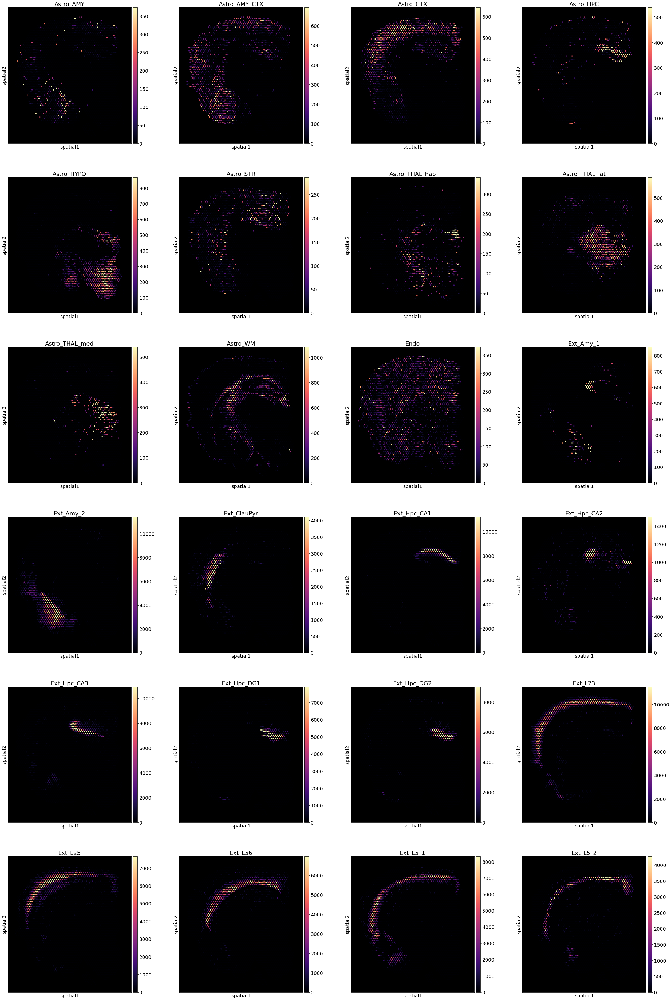

In [37]:
rcParams["axes.facecolor"] = "black"
rcParams["figure.figsize"] = [10,10]
rcParams["font.size"] = 18

s = 'ST8059048'
sel_clust_col = ['q05_nUMI_factors' in i for i in adata_vis.obs.columns]
sel_clust_col = adata_vis.obs.columns[sel_clust_col]
from re import sub # create nice names
sel_clust = [sub('q05_nUMI_factors', '', i) for i in sel_clust_col]

# log-transform and save with nice names
adata_vis.obs[sel_clust] = (adata_vis.obs[sel_clust_col])

sc.pl.spatial(adata_vis[adata_vis.obs['sample'].isin([s]),:], cmap='magma',
              color=sel_clust[0:24], # limit size in this notebook
              library_id=f'spaceranger100_count_30458_{s}_mm10-3_0_0_premrna',
              ncols=4, 
              size=1, img_key='hires', 
              alpha_img=0,
              vmin=0, vmax='p99.3'
             )

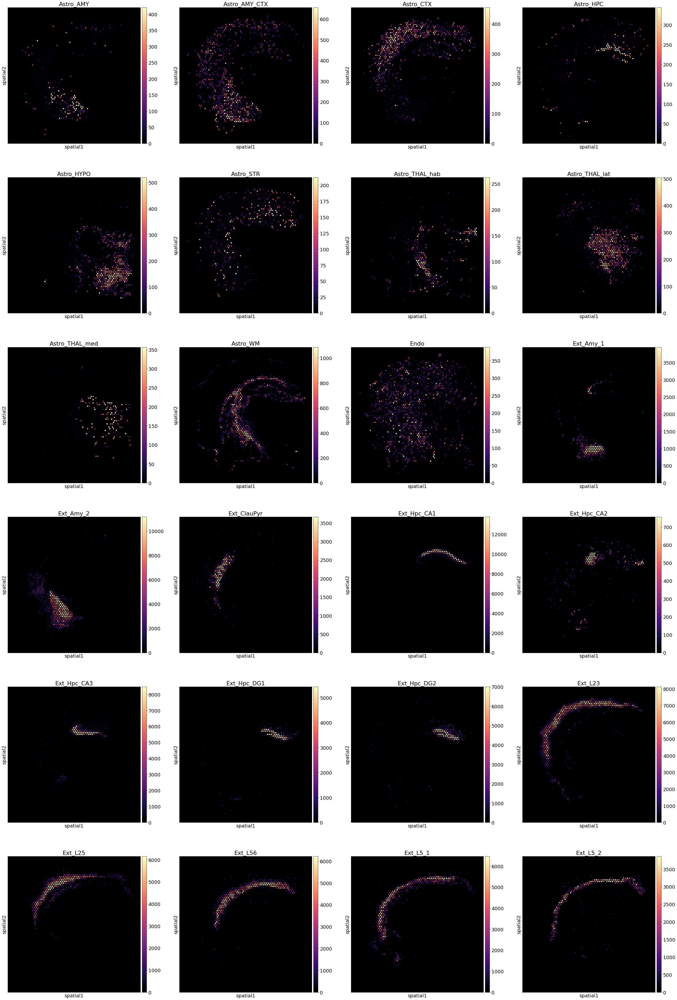

In [38]:
rcParams["axes.facecolor"] = "black"
rcParams["figure.figsize"] = [10,10]
rcParams["font.size"] = 18

s = 'ST8059049'
sel_clust_col = ['q05_nUMI_factors' in i for i in adata_vis.obs.columns]
sel_clust_col = adata_vis.obs.columns[sel_clust_col]
from re import sub # create nice names
sel_clust = [sub('q05_nUMI_factors', '', i) for i in sel_clust_col]

# log-transform and save with nice names
adata_vis.obs[sel_clust] = (adata_vis.obs[sel_clust_col])

sc.pl.spatial(adata_vis[adata_vis.obs['sample'].isin([s]),:], cmap='magma',
              color=sel_clust[0:24], # limit size in this notebook
              library_id=f'spaceranger100_count_30458_{s}_mm10-3_0_0_premrna',
              ncols=4, 
              size=1, img_key='hires', 
              alpha_img=0,
              vmin=0, vmax='p99.3'
             )

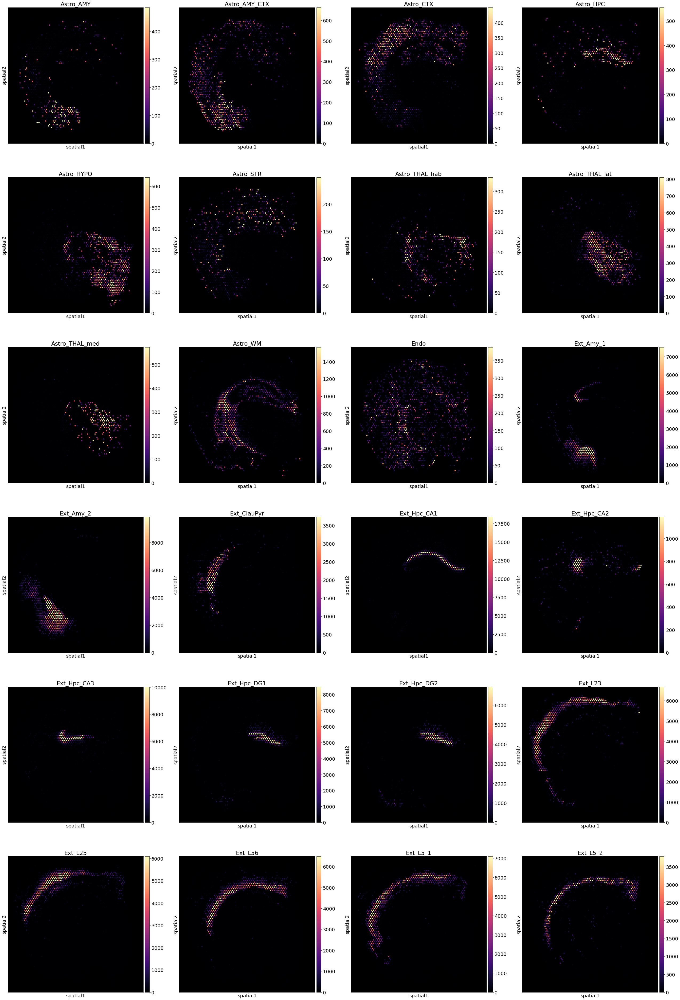

In [39]:
rcParams["axes.facecolor"] = "black"
rcParams["figure.figsize"] = [10,10]
rcParams["font.size"] = 18

s = 'ST8059050'
sel_clust_col = ['q05_nUMI_factors' in i for i in adata_vis.obs.columns]
sel_clust_col = adata_vis.obs.columns[sel_clust_col]
from re import sub # create nice names
sel_clust = [sub('q05_nUMI_factors', '', i) for i in sel_clust_col]

# log-transform and save with nice names
adata_vis.obs[sel_clust] = (adata_vis.obs[sel_clust_col])

sc.pl.spatial(adata_vis[adata_vis.obs['sample'].isin([s]),:], cmap='magma',
              color=sel_clust[0:24], # limit size in this notebook
              library_id=f'spaceranger100_count_30458_{s}_mm10-3_0_0_premrna',
              ncols=4, 
              size=1, img_key='hires', 
              alpha_img=0,
              vmin=0, vmax='p99.3'
             )

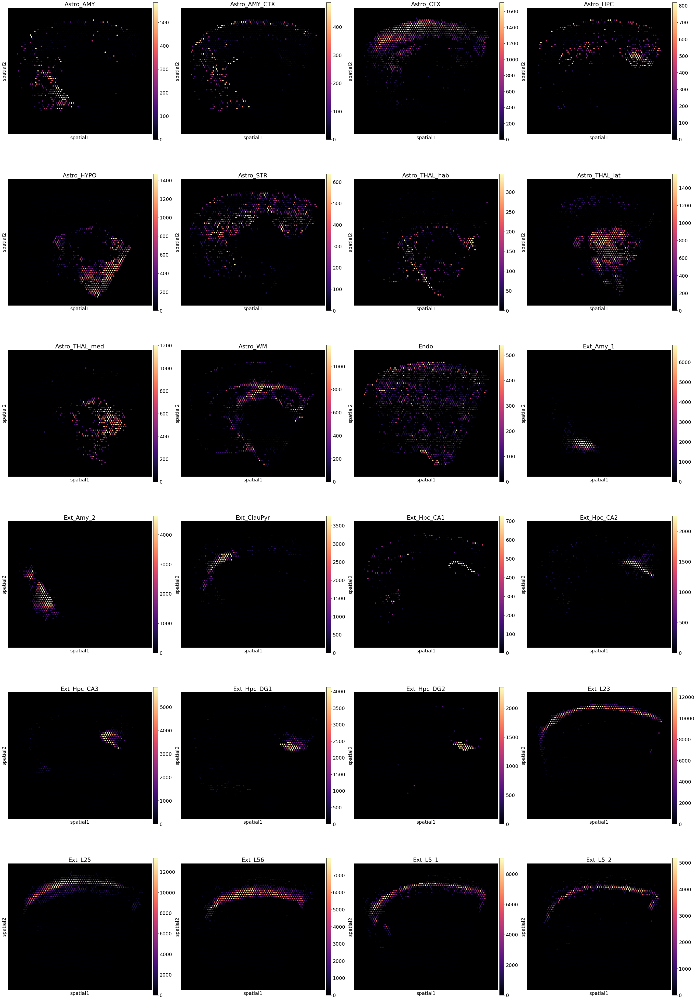

In [40]:
rcParams["axes.facecolor"] = "black"
rcParams["figure.figsize"] = [10,10]
rcParams["font.size"] = 18

s = 'ST8059051'
sel_clust_col = ['q05_nUMI_factors' in i for i in adata_vis.obs.columns]
sel_clust_col = adata_vis.obs.columns[sel_clust_col]
from re import sub # create nice names
sel_clust = [sub('q05_nUMI_factors', '', i) for i in sel_clust_col]

# log-transform and save with nice names
adata_vis.obs[sel_clust] = (adata_vis.obs[sel_clust_col])

sc.pl.spatial(adata_vis[adata_vis.obs['sample'].isin([s]),:], cmap='magma',
              color=sel_clust[0:24], # limit size in this notebook
              library_id=f'spaceranger100_count_30458_{s}_mm10-3_0_0_premrna',
              ncols=4, 
              size=1, img_key='hires', 
              alpha_img=0,
              vmin=0, vmax='p99.3'
             )

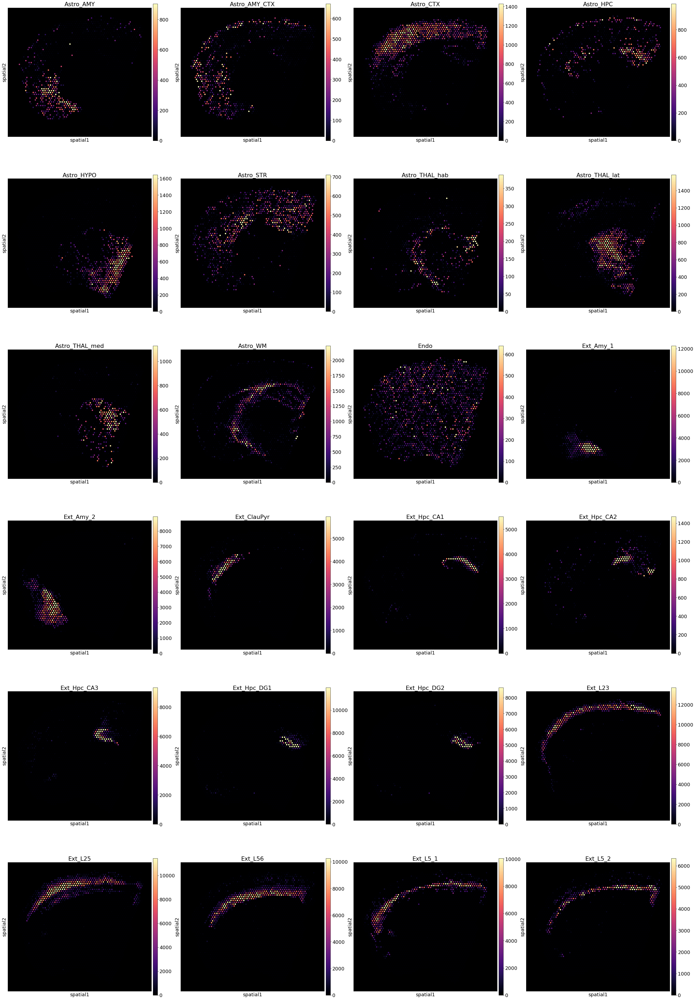

In [41]:
rcParams["axes.facecolor"] = "black"
rcParams["figure.figsize"] = [10,10]
rcParams["font.size"] = 18

s = 'ST8059052'
sel_clust_col = ['q05_nUMI_factors' in i for i in adata_vis.obs.columns]
sel_clust_col = adata_vis.obs.columns[sel_clust_col]
from re import sub # create nice names
sel_clust = [sub('q05_nUMI_factors', '', i) for i in sel_clust_col]

# log-transform and save with nice names
adata_vis.obs[sel_clust] = (adata_vis.obs[sel_clust_col])

sc.pl.spatial(adata_vis[adata_vis.obs['sample'].isin([s]),:], cmap='magma',
              color=sel_clust[0:24], # limit size in this notebook
              library_id=f'spaceranger100_count_30458_{s}_mm10-3_0_0_premrna',
              ncols=4, 
              size=1, img_key='hires', 
              alpha_img=0,
              vmin=0, vmax='p99.3'
             )

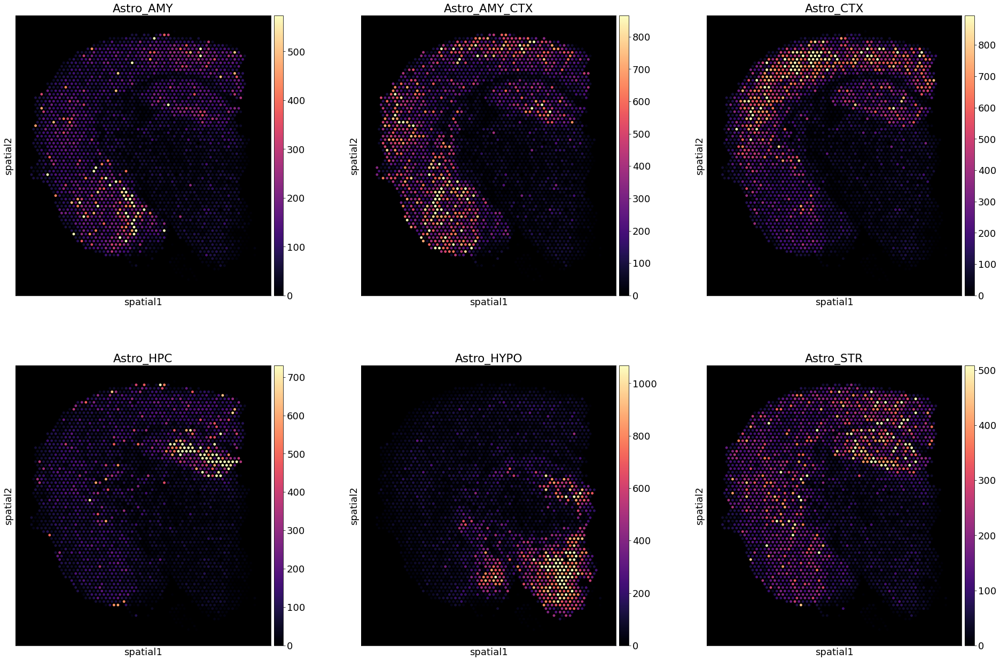

In [42]:
rcParams["axes.facecolor"] = "black"
rcParams["figure.figsize"] = [10,10]
rcParams["font.size"] = 18

s = 'ST8059048'
sel_clust_col = ['q95_nUMI_factors' in i for i in adata_vis.obs.columns]
sel_clust_col = adata_vis.obs.columns[sel_clust_col]
from re import sub # create nice names
sel_clust = [sub('q95_nUMI_factors', '', i) for i in sel_clust_col]

# log-transform and save with nice names
adata_vis.obs[sel_clust] = (adata_vis.obs[sel_clust_col])

sc.pl.spatial(adata_vis[adata_vis.obs['sample'].isin([s]),:], cmap='magma',
              color=sel_clust[0:6], # limit size in this notebook
              library_id=f'spaceranger100_count_30458_{s}_mm10-3_0_0_premrna',
              ncols=3, 
              size=1, img_key='hires', 
              alpha_img=0,
              vmin=0, vmax='p99.0'
             )

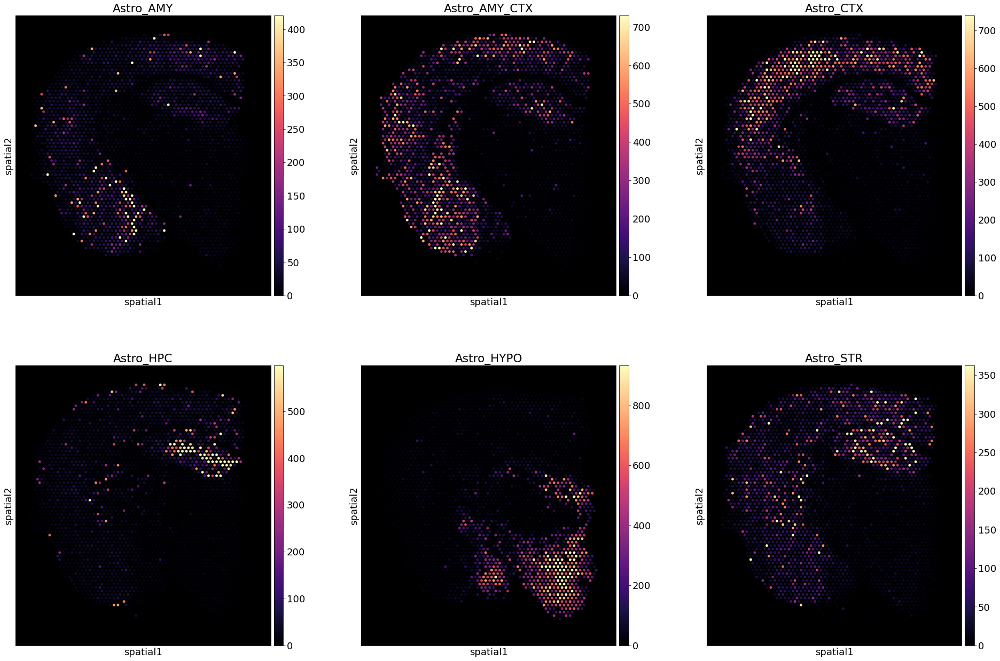

In [43]:
rcParams["axes.facecolor"] = "black"
rcParams["figure.figsize"] = [10,10]
rcParams["font.size"] = 18

s = 'ST8059048'
sel_clust_col = ['mean_nUMI_factors' in i for i in adata_vis.obs.columns]
sel_clust_col = adata_vis.obs.columns[sel_clust_col]
from re import sub # create nice names
sel_clust = [sub('mean_nUMI_factors', '', i) for i in sel_clust_col]

# log-transform and save with nice names
adata_vis.obs[sel_clust] = (adata_vis.obs[sel_clust_col])

sc.pl.spatial(adata_vis[adata_vis.obs['sample'].isin([s]),:], cmap='magma',
              color=sel_clust[0:6], # limit size in this notebook
              library_id=f'spaceranger100_count_30458_{s}_mm10-3_0_0_premrna',
              ncols=3, 
              size=1, img_key='hires', 
              alpha_img=0,
              vmin=0, vmax='p99.0'
             )

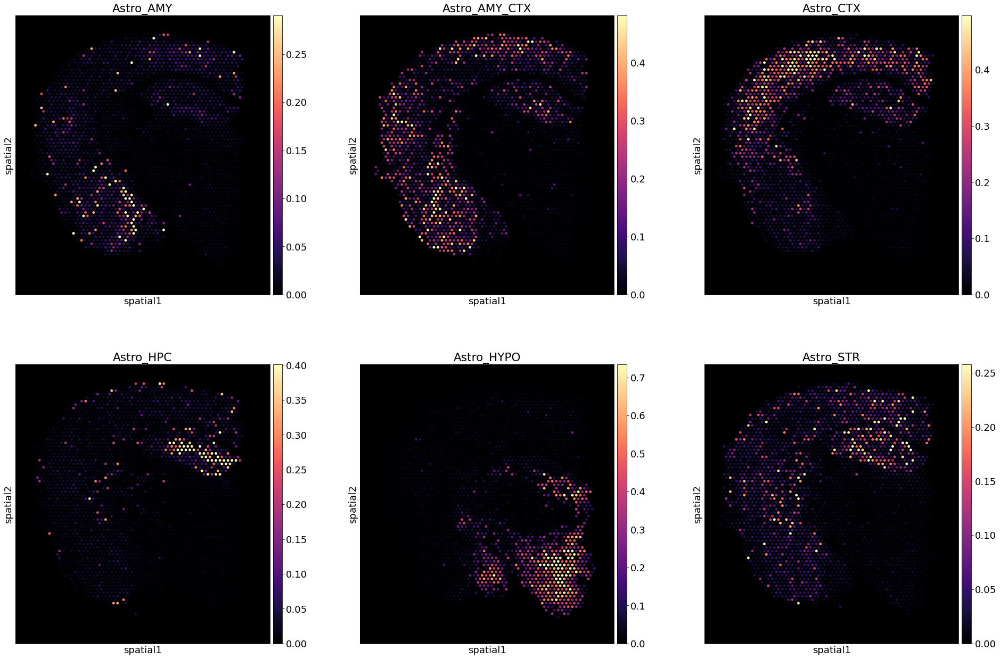

In [44]:
rcParams["axes.facecolor"] = "black"
rcParams["figure.figsize"] = [10,10]
rcParams["font.size"] = 18

s = 'ST8059048'
sel_clust_col = ['mean_spot_factors' in i for i in adata_vis.obs.columns]
sel_clust_col = adata_vis.obs.columns[sel_clust_col]
from re import sub # create nice names
sel_clust = [sub('mean_spot_factors', '', i) for i in sel_clust_col]

# log-transform and save with nice names
adata_vis.obs[sel_clust] = (adata_vis.obs[sel_clust_col])

sc.pl.spatial(adata_vis[adata_vis.obs['sample'].isin([s]),:], cmap='magma',
              color=sel_clust[0:6], # limit size in this notebook
              library_id=f'spaceranger100_count_30458_{s}_mm10-3_0_0_premrna',
              ncols=3, 
              size=1, img_key='hires', 
              alpha_img=0,
              vmin=0, vmax='p99.0'
             )

Here we visualise locations of multiple cell types at once.

In [47]:
s = 'ST8059048'

slides[s].uns['spatial'].keys()
# identify spot locations to crop near tissue
crop_max = (slides[s].obsm['spatial'] * list(slides[s].uns['spatial'].values())[0]['scalefactors']['tissue_hires_scalef']).max(axis=0)
crop_min = (slides[s].obsm['spatial'] * list(slides[s].uns['spatial'].values())[0]['scalefactors']['tissue_hires_scalef']).min(axis=0)

crop_x = [crop_min[0]-50, crop_max[0]+50]
crop_y = [crop_min[1]-20, crop_max[1]+20]

crop_max, crop_min

(array([1651.9231528, 1842.8002608]), array([249.9279112, 282.1059856]))

Trying to set attribute `.uns` of view, copying.


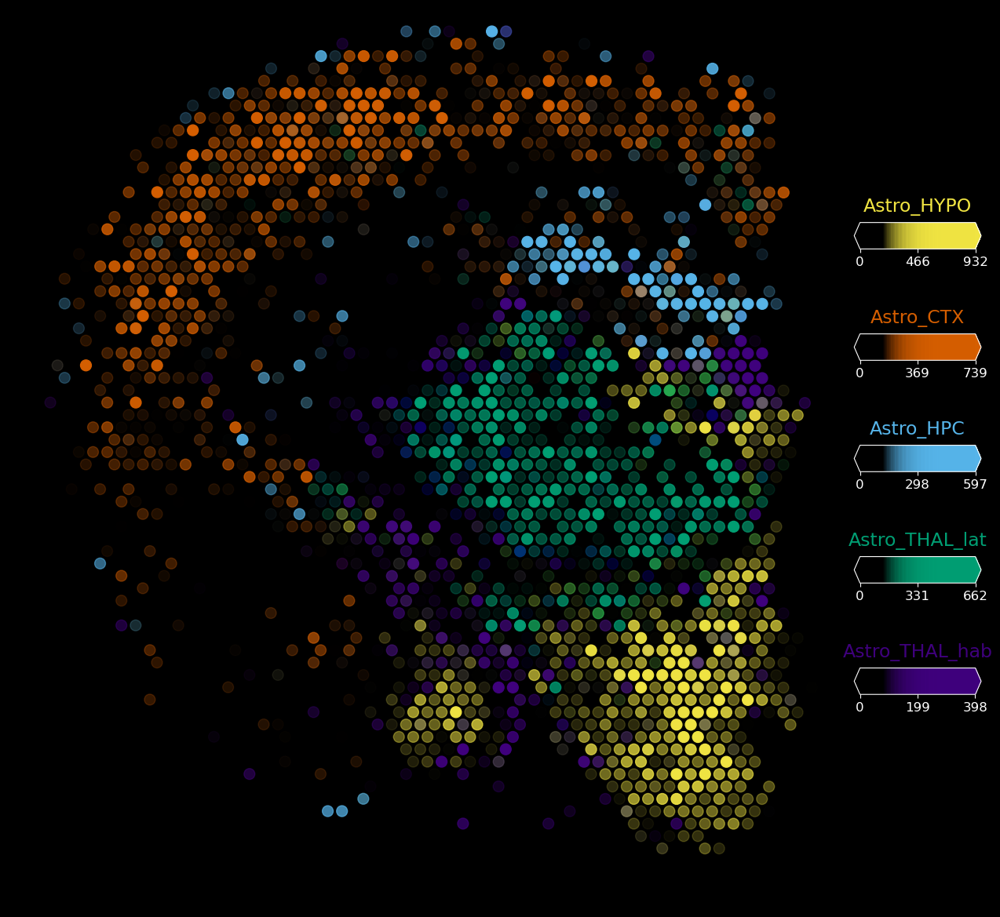

In [52]:
from cell2location.plt.mapping_video import plot_spatial

# select up to 6 clusters 
sel_clust = ['Astro_HYPO','Astro_CTX','Astro_HPC','Astro_THAL_lat', 'Astro_THAL_hab']
sel_clust_col = ['mean_nUMI_factors' + str(i) for i in sel_clust]
# s = 'ST8059048'

# slide = adata_vis[adata_vis.obs['sample']==s]
def select_slide(adata, s, s_col='sample'):
    r""" Select data for one slide from the spatial anndata object.

    :param adata: Anndata object with multiple spatial samples
    :param s: name of selected sample
    :param s_col: column in adata.obs listing sample name for each location
    """

    slide = adata_vis[adata_vis.obs[s_col].isin([s]), :]
    s_keys = list(slide.uns['spatial'].keys())
    s_spatial = np.array(s_keys)[[s in k for k in s_keys]][0]

    slide.uns['spatial'] = {s_spatial: slide.uns['spatial'][s_spatial]}

    return slide

slide = select_slide(adata_vis, 'ST8059048')

matplotlib.rc_file_defaults()
rcParams['pdf.fonttype'] = 42 # enables correct plotting of text
with matplotlib.rc_context({"figure.figsize": (16,15)}):

    plot_spatial(slide.obs[sel_clust_col], 
                  coords=slide.obsm['spatial'] \
                          * list(slide.uns['spatial'].values())[0]['scalefactors']['tissue_hires_scalef'], 
                  show_img=False, img_alpha=1,
                  max_color_quantile=0.99,
              #img=list(slides[s].uns['spatial'].values())[0]['images']['hires'],
                  circle_diameter=10, alpha_scaling=1, labels=sel_clust, 
                 style='dark_background', # fast dark_background
              crop_x=crop_x, crop_y=crop_y
                )

Trying to set attribute `.uns` of view, copying.


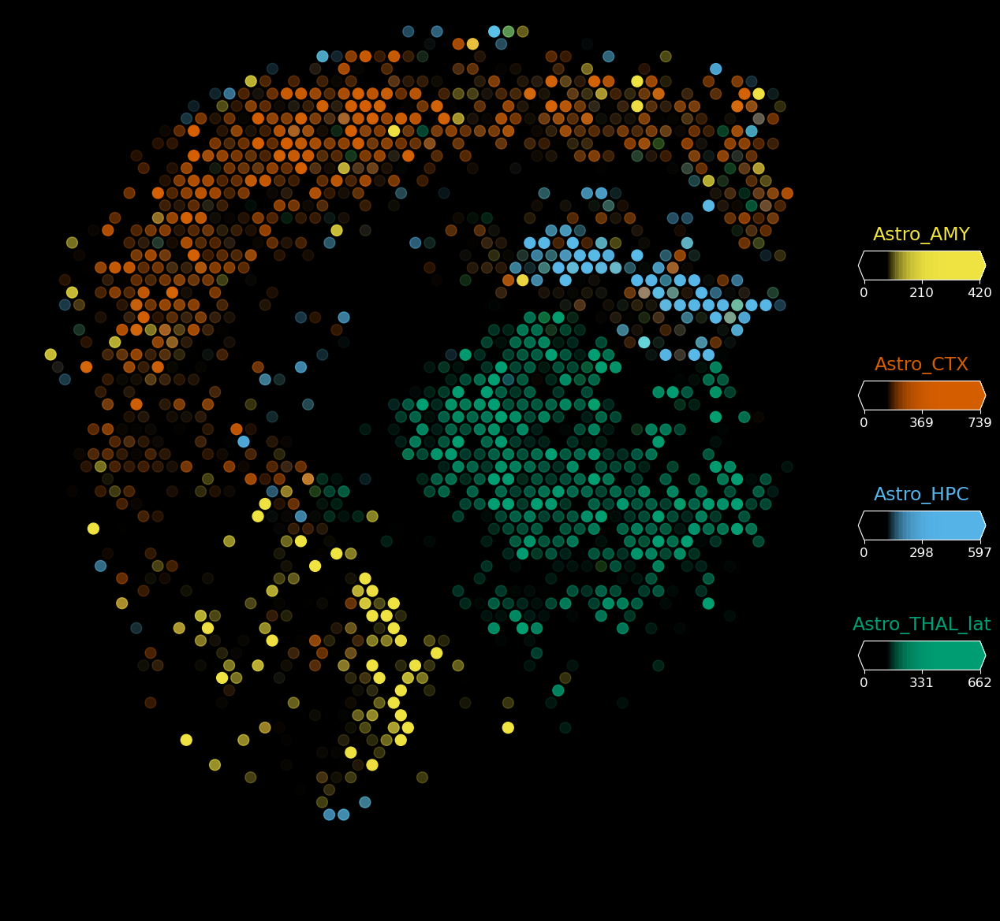

In [53]:
from cell2location.plt.mapping_video import plot_spatial

# select up to 6 clusters 
sel_clust = ['Astro_AMY','Astro_CTX','Astro_HPC','Astro_THAL_lat']
sel_clust_col = ['mean_nUMI_factors' + str(i) for i in sel_clust]
# s = 'ST8059048'

# slide = adata_vis[adata_vis.obs['sample']==s]
def select_slide(adata, s, s_col='sample'):
    r""" Select data for one slide from the spatial anndata object.

    :param adata: Anndata object with multiple spatial samples
    :param s: name of selected sample
    :param s_col: column in adata.obs listing sample name for each location
    """

    slide = adata_vis[adata_vis.obs[s_col].isin([s]), :]
    s_keys = list(slide.uns['spatial'].keys())
    s_spatial = np.array(s_keys)[[s in k for k in s_keys]][0]

    slide.uns['spatial'] = {s_spatial: slide.uns['spatial'][s_spatial]}

    return slide

slide = select_slide(adata_vis, 'ST8059048')

matplotlib.rc_file_defaults()
rcParams['pdf.fonttype'] = 42 # enables correct plotting of text
with matplotlib.rc_context({"figure.figsize": (16,15)}):

    plot_spatial(slide.obs[sel_clust_col], 
                  coords=slide.obsm['spatial'] \
                          * list(slide.uns['spatial'].values())[0]['scalefactors']['tissue_hires_scalef'], 
                  show_img=False, img_alpha=1,
                  max_color_quantile=0.99,
              #img=list(slides[s].uns['spatial'].values())[0]['images']['hires'],
                  circle_diameter=10, alpha_scaling=1, labels=sel_clust, 
                 style='dark_background', # fast dark_background
              crop_x=crop_x, crop_y=crop_y
                )

from cell2location.plt.mapping_video import plot_spatial

# select up to 6 clusters 
sel_clust = ['Astro_AMY_1','Astro_CTX','Astro_AMY_CTX','Astro_THAL_lat', 'Astro_AMY_2']
sel_clust_col = ['mean_nUMI_factors' + str(i) for i in sel_clust]
# s = 'ST8059048'

# slide = adata_vis[adata_vis.obs['sample']==s]
def select_slide(adata, s, s_col='sample'):
    r""" Select data for one slide from the spatial anndata object.

    :param adata: Anndata object with multiple spatial samples
    :param s: name of selected sample
    :param s_col: column in adata.obs listing sample name for each location
    """

    slide = adata_vis[adata_vis.obs[s_col].isin([s]), :]
    s_keys = list(slide.uns['spatial'].keys())
    s_spatial = np.array(s_keys)[[s in k for k in s_keys]][0]

    slide.uns['spatial'] = {s_spatial: slide.uns['spatial'][s_spatial]}

    return slide

slide = select_slide(adata_vis, 'ST8059048')

matplotlib.rc_file_defaults()
rcParams['pdf.fonttype'] = 42 # enables correct plotting of text
with matplotlib.rc_context({"figure.figsize": (16,15)}):

    plot_spatial(slide.obs[sel_clust_col], 
                  coords=slide.obsm['spatial'] \
                          * list(slide.uns['spatial'].values())[0]['scalefactors']['tissue_hires_scalef'], 
                  show_img=False, img_alpha=1,
                  max_color_quantile=0.99,
              #img=list(slides[s].uns['spatial'].values())[0]['images']['hires'],
                  circle_diameter=10, alpha_scaling=0.5, labels=sel_clust, 
                 style='dark_background', # fast dark_background
              crop_x=crop_x, crop_y=crop_y
                )

Trying to set attribute `.uns` of view, copying.


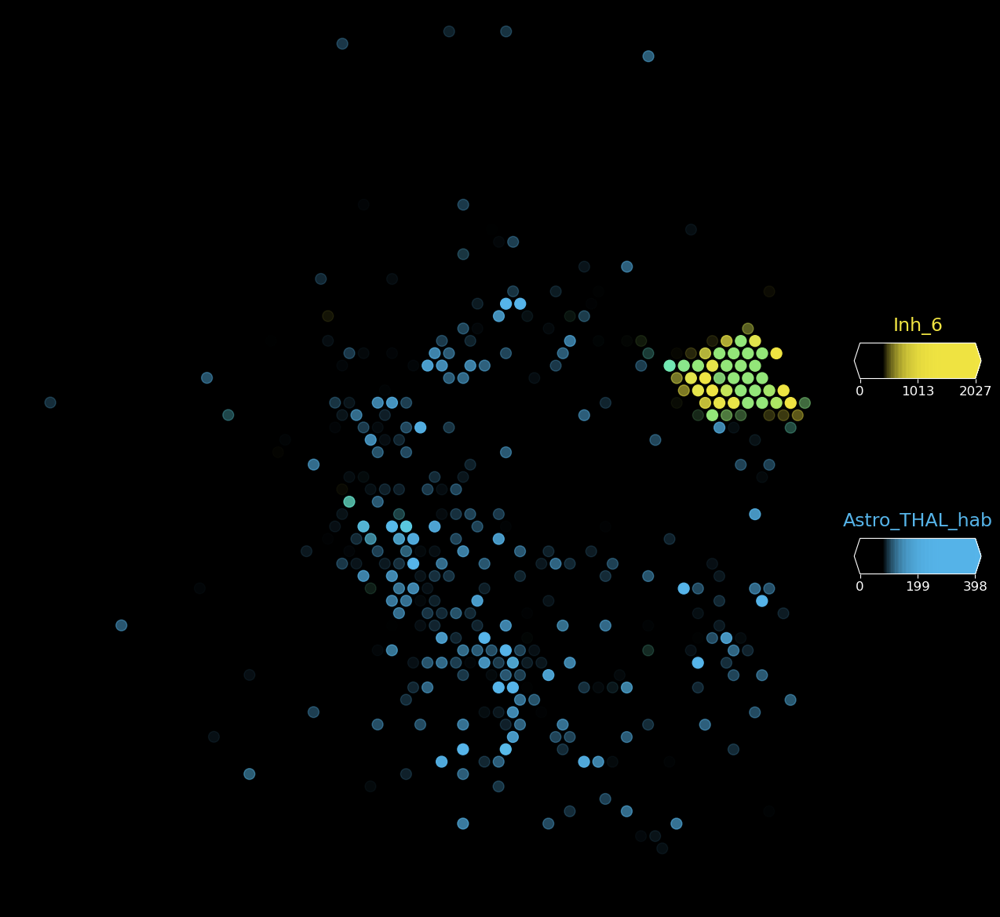

In [56]:
from cell2location.plt.mapping_video import plot_spatial

# select up to 6 clusters 
sel_clust = ['Inh_6', 'Astro_THAL_hab']
sel_clust_col = ['mean_nUMI_factors' + str(i) for i in sel_clust]
# s = 'ST8059048'

# slide = adata_vis[adata_vis.obs['sample']==s]
def select_slide(adata, s, s_col='sample'):
    r""" Select data for one slide from the spatial anndata object.

    :param adata: Anndata object with multiple spatial samples
    :param s: name of selected sample
    :param s_col: column in adata.obs listing sample name for each location
    """

    slide = adata_vis[adata_vis.obs[s_col].isin([s]), :]
    s_keys = list(slide.uns['spatial'].keys())
    s_spatial = np.array(s_keys)[[s in k for k in s_keys]][0]

    slide.uns['spatial'] = {s_spatial: slide.uns['spatial'][s_spatial]}

    return slide

slide = select_slide(adata_vis, 'ST8059048')

matplotlib.rc_file_defaults()
rcParams['pdf.fonttype'] = 42 # enables correct plotting of text
with matplotlib.rc_context({"figure.figsize": (16,15)}):

    plot_spatial(slide.obs[sel_clust_col], 
                  coords=slide.obsm['spatial'] \
                          * list(slide.uns['spatial'].values())[0]['scalefactors']['tissue_hires_scalef'], 
                  show_img=False, img_alpha=1,
                  max_color_quantile=0.99, reorder_cmap=[0,2],
              #img=list(slides[s].uns['spatial'].values())[0]['images']['hires'],
                  circle_diameter=10, alpha_scaling=1, labels=sel_clust, 
                 style='dark_background', # fast dark_background
              crop_x=crop_x, crop_y=crop_y
                )

## 4. Automatic discrete region identification by clustering cell densities
We find regions by clustering spots based on inferred molecule contributions of each cell type. We use leiden clustering that incorporates both the similarity of spots in cell locations and in their proximity, by including both when computing the KNN graph. Results are saved in `adata_vis.obs['leiden']`.

In [152]:
sample_type = 'mean_spot_factors'
col_ind = [sample_type in i for i in adata_vis.obs.columns.tolist()]
adata_vis.obsm[sample_type] = adata_vis.obs.loc[:,col_ind].values

# compute KNN using the cell2location output
sc.pp.neighbors(adata_vis, use_rep=sample_type,
                n_neighbors = 38)

# Cluster spots into regions using scanpy
sc.tl.leiden(adata_vis, resolution=1.3)

In [153]:
adata_vis.obs["region_cluster"] = adata_vis.obs["leiden"]
adata_vis.obs["region_cluster"] =  adata_vis.obs["region_cluster"].astype("category")

Trying to set attribute `.uns` of view, copying.


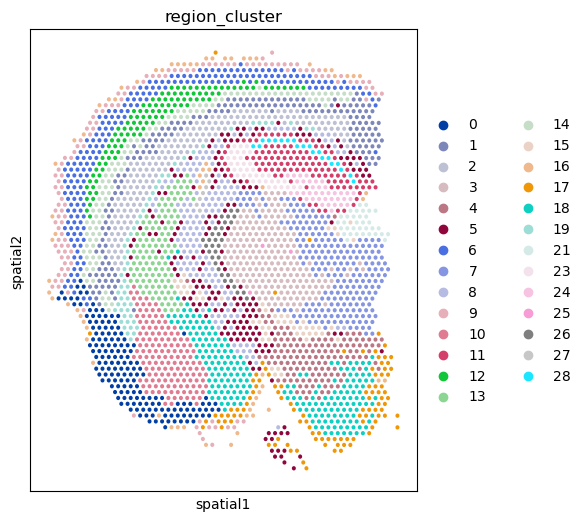

Trying to set attribute `.uns` of view, copying.


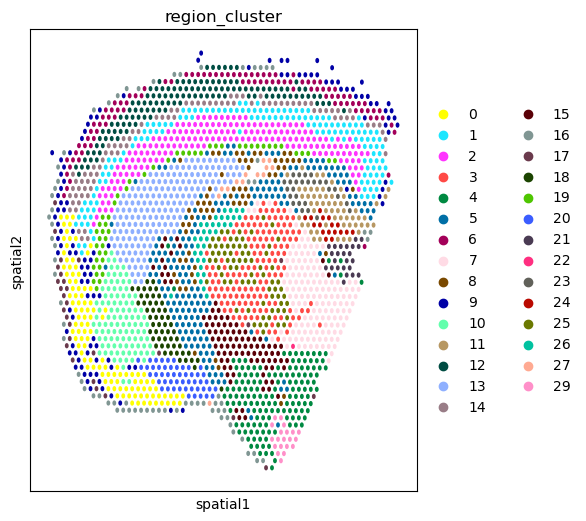

Trying to set attribute `.uns` of view, copying.


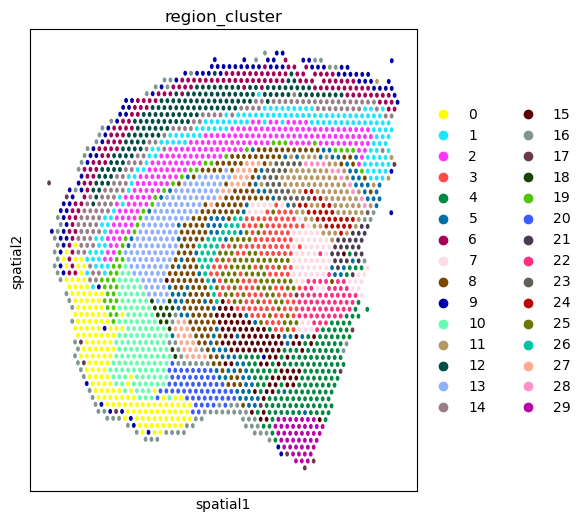

In [154]:
rcParams["figure.figsize"] = [5,6]
rcParams["axes.facecolor"] = "white"
sc.pl.spatial(adata_vis[adata_vis.obs["sample"]=="ST8059048"], 
              color=["region_cluster"], img_key=None,
              color_map=matplotlib.cm.get_cmap('Spectral')
            );
sc.pl.spatial(adata_vis[adata_vis.obs["sample"]=="ST8059051"], 
              color=["region_cluster"], img_key=None,
              color_map=matplotlib.cm.get_cmap('Spectral')
            )
sc.pl.spatial(adata_vis[adata_vis.obs["sample"]=="ST8059052"], 
              color=["region_cluster"], img_key=None,
              color_map=matplotlib.cm.get_cmap('Spectral')
            )

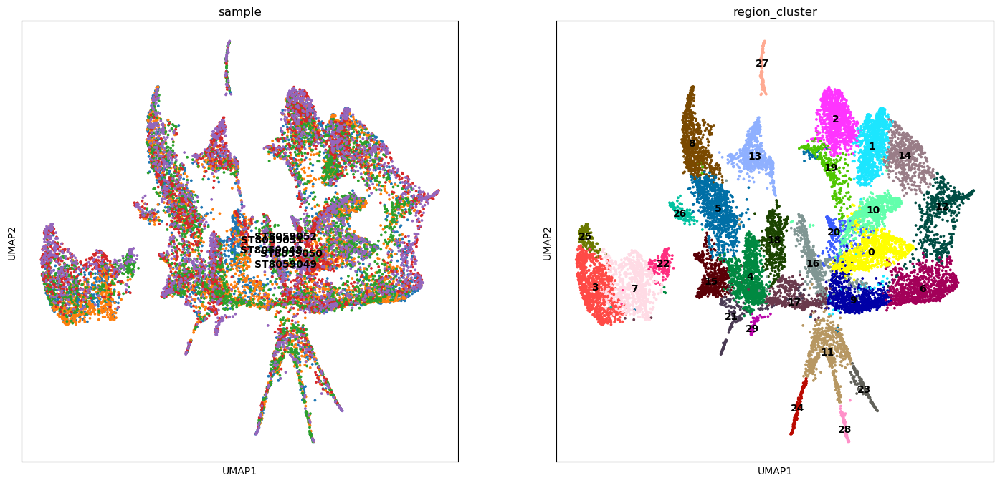

In [155]:
sc.tl.umap(adata_vis, min_dist = 0.3, spread = 1)

rcParams['figure.figsize'] = 8, 8
rcParams["axes.facecolor"] = "white"
sc.pl.umap(adata_vis, color=['sample', 'region_cluster'], size=30,
           color_map = 'RdPu', ncols = 2, legend_loc='on data',
           legend_fontsize=10)

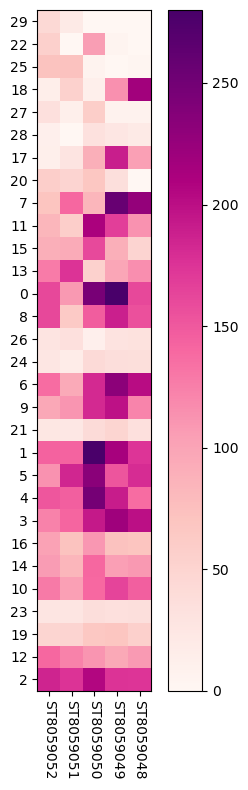

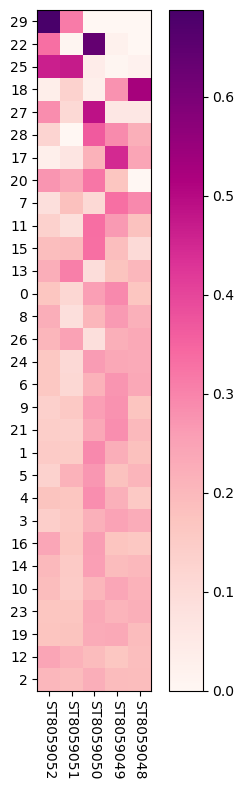

In [156]:
# check which clusters are in which section

def count_locations(adata, sample, cluster):
    
    return (adata.obs['sample'].isin([sample]) & adata.obs['region_cluster'].isin([cluster])).sum()
    
count_mat = [[count_locations(adata_vis, i, j) 
              for i in adata_vis.obs['sample'].unique()]
             for j in adata_vis.obs['region_cluster'].unique()]
count_df = pd.DataFrame(count_mat, index=adata_vis.obs['region_cluster'].unique(), 
                        columns=adata_vis.obs['sample'].unique())
count_fraq_df = (count_df.T / count_df.sum(1)).T

from scipy.stats import entropy
count_ent = entropy(count_fraq_df, base=2, axis=1)
count_df = count_df.iloc[np.argsort(count_ent),:]
count_fraq_df = count_fraq_df.iloc[np.argsort(count_ent),:]

from cell2location.plt.plot_heatmap import clustermap
clustermap(count_df, figure_size=[4, 8], cluster_rows=False, cluster_cols=False)
clustermap(count_fraq_df, figure_size=[4, 8], cluster_rows=False, cluster_cols=False)

### Export cell locations and regions for import to 10X Loupe Browser

In [157]:
# add binary labels for each region
region_cluster_bin = pd.get_dummies(adata_vis.obs['region_cluster'], columns=['region_cluster']).values
colnames = adata_vis.obs['region_cluster'].cat.categories
colnames = ['r' + str(i) for i in colnames]
region_cluster_bin = pd.DataFrame(region_cluster_bin, index=adata_vis.obs_names,
                                  columns=colnames)
region_cluster_bin['region_cluster'] = adata_vis.obs['region_cluster']

In [158]:
# add binary labels for each region
region_cluster_bin = pd.get_dummies(adata_vis.obs['region_cluster'], columns=['region_cluster']).values
colnames = adata_vis.obs['region_cluster'].cat.categories
colnames = ['r' + str(i) for i in colnames]
region_cluster_bin = pd.DataFrame(region_cluster_bin, index=adata_vis.obs_names,
                                  columns=colnames)
region_cluster_bin['region_cluster'] = adata_vis.obs['region_cluster']

# save maps for each sample separately
sam = np.array(adata_vis.obs['sample'])

for i in np.unique(sam):
    
    s1 = region_cluster_bin.drop(columns = ['region_cluster'])
    s1 = s1.loc[sam == i]
    s1.index = [x[10:] for x in s1.index]
    
    #w1 = r['mod'].spot_factors_df.loc[sam == i]
    #w1.index = [x[10:] for x in w1.index]
    
    s1.to_csv(results_folder + 'std_model/'+r['run_name'] + '/region_cluster29_' + i + '.csv')
    #w1.to_csv(results_folder + 'std_model/'+r['run_name'] + '/W_V7_V2_' + i + '.csv')

## 5. Visualize cell type density gradients using diffusion maps

Here we use the diffusion maps approach to visualize cell type density gradients. This allows describing how cell composition of spots transitions as you move through the tissue and shows which tissue regions are connected in terms of their cell composition.

In [159]:
sc.tl.diffmap(adata_vis)

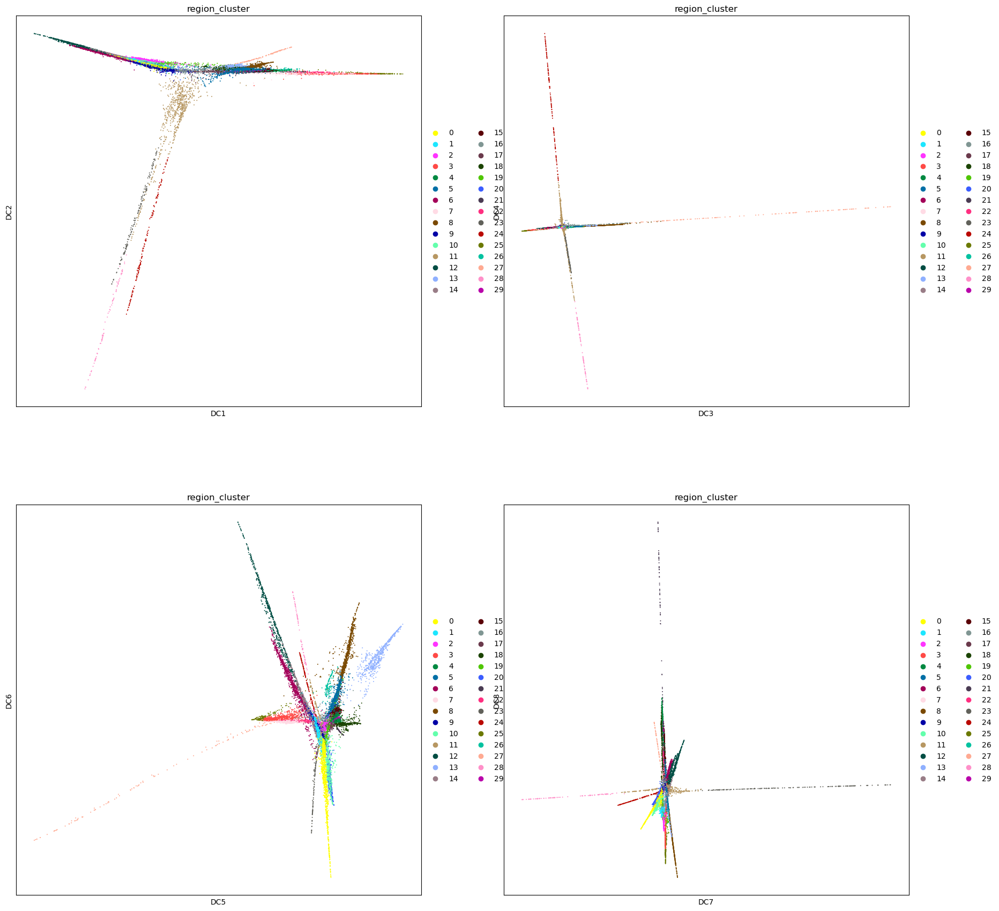

In [160]:
rcParams["axes.facecolor"] = "white"
rcParams["figure.figsize"] = [10,10]
sc.pl.diffmap(adata_vis, color=['region_cluster'],
              components=['1,2', '3,4', '5,6', '7,8'], ncols=2)

Save resulting adata with clustering and diffusion maps

In [161]:
adata_file = results_folder \
                + 'std_model/'+r['run_name']+'/sp_with_clusters.h5ad'
adata_vis.write(adata_file)

In [162]:
results_folder \
                + 'std_model/'+r['run_name']

'/nfs/team205/vk7/sanger_projects/cell2location_proj/notebooks/results/mouse_viseum_snrna/std_model/CoLocationModelNB4E3V2_58clusters_14968locations_12809genes_n_comb100_mean_var5_inferred_30k_str'

In [68]:
matplotlib.rc_file_defaults()
plt.rcParams["axes.grid"] = False
# Run de-novo factorisation again
from cell2location import run_colocation
res_dict, sp_data = run_colocation(
                   adata_vis, model_name='CoLocatedCombination_sklearnNMF',
                   verbose=False, return_all=True,
    
                   train_args={'n_fact': np.arange(8, 30),
                               'n_iter': 20000,
                    'sample_name_col': 'sample',
                    'mode': 'normal', 'n_type': 'restart', 'n_restarts': 5},
    
                   model_kwargs={'init': 'random', 'random_state': 0, 'nmf_kwd_args': {'tol': 0.0001}},
    
                   posterior_args={},
                   export_args={'path': results_folder + 'std_model/'+r['run_name']+'/CoLocatedComb/',
                                'run_name_suffix': 'tol0.0001', 'plot_extension': 'pdf'})

### Analysis name: CoLocatedCombination_sklearnNMF_8combinations_14968locations_58factorstol0.0001
### Analysis name: CoLocatedCombination_sklearnNMF_9combinations_14968locations_58factorstol0.0001
### Analysis name: CoLocatedCombination_sklearnNMF_10combinations_14968locations_58factorstol0.0001
### Analysis name: CoLocatedCombination_sklearnNMF_11combinations_14968locations_58factorstol0.0001
### Analysis name: CoLocatedCombination_sklearnNMF_12combinations_14968locations_58factorstol0.0001


### Analysis name: CoLocatedCombination_sklearnNMF_13combinations_14968locations_58factorstol0.0001
### Analysis name: CoLocatedCombination_sklearnNMF_14combinations_14968locations_58factorstol0.0001
### Analysis name: CoLocatedCombination_sklearnNMF_15combinations_14968locations_58factorstol0.0001
### Analysis name: CoLocatedCombination_sklearnNMF_16combinations_14968locations_58factorstol0.0001


### Analysis name: CoLocatedCombination_sklearnNMF_17combinations_14968locations_58factorstol0.0001
### Analysis name: CoLocatedCombination_sklearnNMF_18combinations_14968locations_58factorstol0.0001
### Analysis name: CoLocatedCombination_sklearnNMF_19combinations_14968locations_58factorstol0.0001
### Analysis name: CoLocatedCombination_sklearnNMF_20combinations_14968locations_58factorstol0.0001
### Analysis name: CoLocatedCombination_sklearnNMF_21combinations_14968locations_58factorstol0.0001


### Analysis name: CoLocatedCombination_sklearnNMF_22combinations_14968locations_58factorstol0.0001
### Analysis name: CoLocatedCombination_sklearnNMF_23combinations_14968locations_58factorstol0.0001
### Analysis name: CoLocatedCombination_sklearnNMF_24combinations_14968locations_58factorstol0.0001
### Analysis name: CoLocatedCombination_sklearnNMF_25combinations_14968locations_58factorstol0.0001


### Analysis name: CoLocatedCombination_sklearnNMF_26combinations_14968locations_58factorstol0.0001
### Analysis name: CoLocatedCombination_sklearnNMF_27combinations_14968locations_58factorstol0.0001
### Analysis name: CoLocatedCombination_sklearnNMF_28combinations_14968locations_58factorstol0.0001
### Analysis name: CoLocatedCombination_sklearnNMF_29combinations_14968locations_58factorstol0.0001


### Plotting spatial maps in higher resolution and with transparent spots on histology


pickle_model = results_folder + 'std_model/'+r['run_name']+'/model_.p'
out = pickle.load(open(pickle_model, "rb"))
out

#model_name = pycell2location.models.CoLocationModelNB4E3V2.CoLocationModelNB4E3V2
summ_sc_data_args = {'cluster_col': 'annotation_1',
  'which_genes': 'intersect',
  'selection': None,
  'select_n': 5000,
  'select_n_AutoGeneS': 1000}
train_args = {'mode': 'normal',
  'use_raw': True,
  'data_type': 'float32',
  'n_iter': 30000,
  'learning_rate': 0.005,
  'total_grad_norm_constraint': 200,
  'method': 'advi',
  'sample_prior': False,
  'n_prior_samples': 10,
  'n_restarts': 2,
  'n_type': 'restart',
  'tracking_every': 1000,
  'tracking_n_samples': 50,
  'readable_var_name_col': None,
  'sample_name_col': 'sample',
  'fact_names': None}
posterior_args = {'n_samples': 1000,
  'evaluate_stability_align': False,
  'mean_field_slot': 'init_1'}
export_args = {'path': '/nfs/team205/vk7/sanger_projects/cell2location_dev/notebooks/results/mouse_viseum_snrna/std_model/',
  'plot_extension': 'png',
  'scanpy_plot_vmax': 'p99.2',
  'scanpy_plot_size': 1.3,
  'save_model': False,
  'run_name_suffix': '_n_comb100_mean_var5_inferred_20k',
  'export_q05': True,
  'scanpy_coords_name': 'spatial',
  'img_key': 'hires'}
run_name = 'CoLocationModelNB4E3V2_60clusters_14968locations_12819genes_n_comb100_mean_var5_inferred_20k'

d_summ_sc_data_args = {'cluster_col': "annotation_1", 'which_genes': "intersect",
                           'selection': None, 'select_n': 5000, 'select_n_AutoGeneS': 1000}

d_train_args = {'mode': "normal", 'use_raw': True, 'data_type': "float32",
                    'n_iter': 20000, 'learning_rate': 0.005, 'total_grad_norm_constraint': 200,
                    'method': 'advi',
                    'sample_prior': False, 'n_prior_samples': 10,
                    'n_restarts': 2, 'n_type': "restart",
                    'tracking_every': 1000, 'tracking_n_samples': 50, 'readable_var_name_col': None,
                    'sample_name_col': None, 'fact_names': None}

d_posterior_args = {'n_samples': 1000, 'evaluate_stability_align': False, 'mean_field_slot': "init_1"}

d_export_args = {'path': "./results",
                     'plot_extension': "png",
                     'scanpy_plot_vmax': 'p99.2', 'scanpy_plot_size': 1.3,
                     'save_model': False, 'run_name_suffix': '', 'export_q05': True,
                     'scanpy_coords_name': 'spatial', 'img_key': 'hires'}        
        
sp_data = adata_vis.copy()

data_samples = sp_data.obs[train_args['sample_name_col']].unique()
#cluster_plot_names = pd.Series([i[17:] for i in mod.spot_factors_df.columns])

# create the export directory
path = export_args['path'] + run_name + '/'
fig_path = path + 'plots/'
show_locations = False

try:
        for s in data_samples:
            # if slots needed to generate scanpy plots are present, scanpy:
            sc_spatial_present = np.any(np.isin(list(sp_data.uns.keys()), ['spatial']))

            if sc_spatial_present:

                sc.settings.figdir = fig_path + 'spatial/'
                facecolor = rcParams["axes.facecolor"]
                rcParams["axes.facecolor"] = "black"
                rcParams["figure.figsize"] = [17,17]
                
                s_ind = sp_data.obs[train_args['sample_name_col']] == s
                s_keys = list(sp_data.uns['spatial'].keys())
                s_spatial = np.array(s_keys)[[s in i for i in s_keys]][0]

                # Visualize cell type locations - mRNA_count = nUMI #####
                # making copy to transform to log & assign nice names
                adata_vis_pl = sp_data.copy()
                clust_names_orig = ['mean_nUMI_factors' + i for i in sp_data.uns['mod']['fact_names']]
                clust_names = sp_data.uns['mod']['fact_names']

                adata_vis_pl.obs[clust_names] = adata_vis_pl.obs[clust_names_orig]
                sc.pl.spatial(adata_vis_pl[s_ind, :], cmap='magma',
                              color=clust_names, ncols=5, library_id=s_spatial,
                              size=export_args['scanpy_plot_size'], img_key=export_args['img_key'], alpha_img=0,
                              vmin=0, vmax=export_args['scanpy_plot_vmax'],
                              save=f"W_mRNA_count_mean_{s}_{export_args['scanpy_plot_vmax']}.{export_args['plot_extension']}",
                              show=show_locations
                              )
                sc.pl.spatial(adata_vis_pl[s_ind, :], cmap='magma',
                              color=clust_names, ncols=5, library_id=s_spatial,
                              size=export_args['scanpy_plot_size'], img_key=export_args['img_key'], 
                              alpha_img=1, alpha=0.4,
                              vmin=0, vmax=export_args['scanpy_plot_vmax'],
                              save=f"histo_W_mRNA_count_mean_{s}_{export_args['scanpy_plot_vmax']}.{export_args['plot_extension']}",
                              show=False
                              )

                # Visualize cell type locations #####
                # making copy to transform to log & assign nice names
                adata_vis_pl = sp_data.copy()
                clust_names_orig = ['mean_spot_factors' + i for i in sp_data.uns['mod']['fact_names']]
                clust_names = sp_data.uns['mod']['fact_names']
                adata_vis_pl.obs[clust_names] = (adata_vis_pl.obs[clust_names_orig])

                sc.pl.spatial(adata_vis_pl[s_ind, :], cmap='magma',
                              color=clust_names, ncols=5, library_id=s_spatial,
                              size=export_args['scanpy_plot_size'], img_key=export_args['img_key'], alpha_img=0,
                              vmin=0, vmax=export_args['scanpy_plot_vmax'],
                              save=f"W_cell_density_mean_{s}_{export_args['scanpy_plot_vmax']}.{export_args['plot_extension']}",
                              show=False
                              )
                sc.pl.spatial(adata_vis_pl[s_ind, :], cmap='magma',
                              color=clust_names, ncols=5, library_id=s_spatial,
                              size=export_args['scanpy_plot_size'], img_key=export_args['img_key'], 
                              alpha_img=1, alpha=0.4,
                              vmin=0, vmax=export_args['scanpy_plot_vmax'],
                              save=f"histo_W_cell_density_mean_{s}_{export_args['scanpy_plot_vmax']}.{export_args['plot_extension']}",
                              show=False
                              )

                if export_args['export_q05']:
                    # Visualize cell type locations - mRNA_count = nUMI #####
                    # making copy to transform to log & assign nice names
                    adata_vis_pl = sp_data.copy()
                    clust_names_orig = ['q05_nUMI_factors' + i for i in sp_data.uns['mod']['fact_names']]
                    clust_names = sp_data.uns['mod']['fact_names']

                    adata_vis_pl.obs[clust_names] = (adata_vis_pl.obs[clust_names_orig])
                    sc.pl.spatial(adata_vis_pl[s_ind, :], cmap='magma',
                                  color=clust_names, ncols=5, library_id=s_spatial,
                                  size=export_args['scanpy_plot_size'], img_key=export_args['img_key'], alpha_img=0,
                                  vmin=0, vmax=export_args['scanpy_plot_vmax'],
                                  save=f"W_mRNA_count_q05_{s}_{export_args['scanpy_plot_vmax']}.{export_args['plot_extension']}",

                                  show=False
                                  )
                    sc.pl.spatial(adata_vis_pl[s_ind, :], cmap='magma',
                                  color=clust_names, ncols=5, library_id=s_spatial,
                                  size=export_args['scanpy_plot_size'], img_key=export_args['img_key'], 
                                  alpha_img=1, alpha=0.4,
                                  vmin=0, vmax=export_args['scanpy_plot_vmax'],
                                  save=f"histo_W_mRNA_count_q05_{s}_{export_args['scanpy_plot_vmax']}.{export_args['plot_extension']}",
                                  show=False
                                  )

                    # Visualize cell type locations #####
                    # making copy to transform to log & assign nice names
                    adata_vis_pl = sp_data.copy()
                    clust_names_orig = ['q05_spot_factors' + i for i in sp_data.uns['mod']['fact_names']]
                    clust_names = sp_data.uns['mod']['fact_names']
                    adata_vis_pl.obs[clust_names] = (adata_vis_pl.obs[clust_names_orig])

                    sc.pl.spatial(adata_vis_pl[s_ind, :], cmap='magma',
                                  color=clust_names, ncols=5, library_id=s_spatial,
                                  size=export_args['scanpy_plot_size'], img_key=export_args['img_key'], alpha_img=0,
                                  vmin=0, vmax=export_args['scanpy_plot_vmax'],
                                  save=f"W_cell_density_q05_{s}_{export_args['scanpy_plot_vmax']}.{export_args['plot_extension']}",
                                  show=False
                                  )
                    sc.pl.spatial(adata_vis_pl[s_ind, :], cmap='magma',
                                  color=clust_names, ncols=5, library_id=s_spatial,
                                  size=export_args['scanpy_plot_size'], img_key=export_args['img_key'], 
                                  alpha_img=1, alpha=0.4,
                                  vmin=0, vmax=export_args['scanpy_plot_vmax'],
                                  save=f"histo_W_cell_density_q05_{s}_{export_args['scanpy_plot_vmax']}.{export_args['plot_extension']}",
                                  show=False
                                  )
                    
                rcParams["axes.facecolor"] = facecolor

            else:

                # if coordinates exist plot
                if export_args['scanpy_coords_name'] is not None:
                    # move spatial coordinates to obs for compatibility with our plotter
                    sp_data.obs['imagecol'] = sp_data.obsm[export_args['scanpy_coords_name']][:, 0]
                    sp_data.obs['imagerow'] = sp_data.obsm[export_args['scanpy_coords_name']][:, 1]

                    p = c2lpl.plot_factor_spatial(adata=sp_data,
                                                fact_ind=np.arange(mod.spot_factors_df.shape[1]),
                                                fact=mod.spot_factors_df,
                                                cluster_names=cluster_plot_names,
                                                n_columns=6, trans='log',
                                                sample_name=s, samples_col=train_args['sample_name_col'],
                                                obs_x='imagecol', obs_y='imagerow')
                    p.save(filename=fig_path + 'cell_locations_W_mRNA_count_' + str(s) + '.' \
                                    + export_args['plot_extension'])

                    if export_args['export_q05']:
                        p = c2lpl.plot_factor_spatial(adata=sp_data,
                                                      fact_ind=np.arange(mod.spot_factors_q05.shape[1]),
                                                     fact=mod.spot_factors_q05,
                                                     cluster_names=cluster_plot_names,
                                                      n_columns=6, trans='log',
                                                      sample_name=s, samples_col=train_args['sample_name_col'],
                                                      obs_x='imagecol', obs_y='imagerow')
                        p.save(filename=fig_path + 'cell_locations_W_mRNA_count_q05_' + str(s) + '.' \
                                        + export_args['plot_extension'])

                if show_locations:
                    print(p)
except Exception as e:
        print('Some error in plotting with scanpy or `cell2location.plt.plot_factor_spatial()`\n ' + str(e))

In [163]:
! ~/gdrive upload --parent 1Lsxj9rzK4aHUaxDsReI7T6yjK_6flDWE --recursive /nfs/team205/vk7/sanger_projects/cell2location_proj/notebooks/results/mouse_viseum_snrna/std_model/CoLocationModelNB4E3V2_58clusters_14968locations_12809genes_n_comb100_mean_var5_inferred_30k_str/

Creating directory CoLocationModelNB4E3V2_58clusters_14968locations_12809genes_n_comb100_mean_var5_inferred_30k_str
Uploading /nfs/team205/vk7/sanger_projects/cell2location_proj/notebooks/results/mouse_viseum_snrna/std_model/CoLocationModelNB4E3V2_58clusters_14968locations_12809genes_n_comb100_mean_var5_inferred_30k_str/region_cluster29_ST8059048.csv
Uploading /nfs/team205/vk7/sanger_projects/cell2location_proj/notebooks/results/mouse_viseum_snrna/std_model/CoLocationModelNB4E3V2_58clusters_14968locations_12809genes_n_comb100_mean_var5_inferred_30k_str/model_.p
Uploading /nfs/team205/vk7/sanger_projects/cell2location_proj/notebooks/results/mouse_viseum_snrna/std_model/CoLocationModelNB4E3V2_58clusters_14968locations_12809genes_n_comb100_mean_var5_inferred_30k_str/W_mRNA_count.csv
Creating directory plots                          
Uploading /nfs/team205/vk7/sanger_projects/cell2location_proj/notebooks/results/mouse_viseum_snrna/std_model/CoLocationModelNB4E3V2_58clusters_14968locations_

Uploading /nfs/team205/vk7/sanger_projects/cell2location_proj/notebooks/results/mouse_viseum_snrna/std_model/CoLocationModelNB4E3V2_58clusters_14968locations_12809genes_n_comb100_mean_var5_inferred_30k_str/plots/spatial/spatialW_cell_density_q05_ST8059050_p99.2.png
Uploading /nfs/team205/vk7/sanger_projects/cell2location_proj/notebooks/results/mouse_viseum_snrna/std_model/CoLocationModelNB4E3V2_58clusters_14968locations_12809genes_n_comb100_mean_var5_inferred_30k_str/plots/spatial/spatialhisto_W_cell_density_q05_ST8059051_p99.2.png
Uploading /nfs/team205/vk7/sanger_projects/cell2location_proj/notebooks/results/mouse_viseum_snrna/std_model/CoLocationModelNB4E3V2_58clusters_14968locations_12809genes_n_comb100_mean_var5_inferred_30k_str/plots/spatial/spatialW_cell_density_q05_ST8059048_p99.2.png
Uploading /nfs/team205/vk7/sanger_projects/cell2location_proj/notebooks/results/mouse_viseum_snrna/std_model/CoLocationModelNB4E3V2_58clusters_14968locations_12809genes_n_comb100_mean_var5_inferre

Modules and their versions used for this analysis

In [ ]:
import sys
for module in sys.modules:
    try:
        print(module,sys.modules[module].__version__)
    except:
        try:
            if  type(modules[module].version) is str:
                print(module,sys.modules[module].version)
            else:
                print(module,sys.modules[module].version())
        except:
            try:
                print(module,sys.modules[module].VERSION)
            except:
                pass